# Descripción del problema

En el contexto del mercado automotriz en Ecuador, el Servicio de Rentas Internas (SRI) lleva un registro detallado de las ventas de vehículos usados, lo que incluye atributos como el código único del vehículo, marca, modelo, año de modelo, categoría, clase, tipo de vehículo y la ubicación (cantón) de la venta. Este conjunto de datos comprende modelos de vehículos cuyos años de modelo oscilan la mayoría entre 2012 y 2025, proporcionando una base para estudiar patrones recientes en las características y valores de mercado de vehículos usados.

Sin embargo, a medida que el mercado evoluciona, predecir el valor de un vehículo usado con precisión es crucial tanto para el SRI como para otros actores en la industria, tales como concesionarios, aseguradoras y consumidores. La valoración (o avalúo) precisa de un vehículo ayuda a optimizar decisiones de compra, ventas, pólizas de seguros y evaluaciones fiscales.

El objetivo de este proyecto es construir un modelo de regresión que prediga el avalúo de un vehículo usado basándose en las características proporcionadas en el conjunto de datos. La meta es desarrollar un modelo capaz de capturar y generalizar las relaciones entre las variables de entrada y el avalúo de los vehículos, permitiendo realizar predicciones con precisión aceptable para los años de modelos disponibles en el dataset del SRI.

# Librerías

In [ ]:
# Instalación de las librerías usadas en el proyecto
%pip install pandas numpy matplotlib seaborn scikit-learn statsmodels tensorflow scipy openpyxl

In [1]:
# Manejo de datos
import random
import pandas as pd
import numpy as np

# Visualización de datos
import matplotlib.pyplot as plt
import seaborn as sns

# Preprocesamiento
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures

# Modelamiento enfocado en predicción
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import RepeatedKFold

# Modelamiento
from sklearn.linear_model import ElasticNet
import statsmodels.api as sm
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import plot_tree

# Redes Neuronales
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv1D, MaxPooling1D, Flatten
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l1_l2

# Métricas
from sklearn.metrics import mean_squared_error, root_mean_squared_error, r2_score, mean_absolute_error, mean_absolute_percentage_error

# Pruebas de hipótesis
from scipy.stats import kstest
from scipy.stats import f_oneway

In [2]:
file_path = './df2.csv'
df2 = pd.read_csv(file_path, low_memory=False)
df2.shape

(234346, 37)

In [67]:
file_path = './dataframeModels.csv'
dataframeModels = pd.read_csv(file_path, low_memory=False)
dataframeModels.shape

(7, 6)

# Carga de dataset

In [4]:
# Ruta del dataset
file_path = './SRI_Vehiculos_Nuevos_2024.csv'

# Cargando el dataset en df
df = pd.read_csv(file_path, encoding='latin1', delimiter=';')

# Mostrando las primeras 5 filas del dataset
df.head().T

,0,1,2,3,4
CATEGORÍA,973244,973244,973244,973244,970541
CÓDIGO DE VEHÍCULO,9469650,9469650,9469650,9469650,9595556
TIPO TRANSACCIÓN,COMPRA LOCAL,COMPRA LOCAL,COMPRA LOCAL,COMPRA LOCAL,COMPRA LOCAL
MARCA,HINO,HINO,HINO,HINO,JAC
MODELO,RM1ESSU-XSE AC 12.9 1P 4X2 TM DIESEL,RM1ESSU-XSE AC 12.9 1P 4X2 TM DIESEL,RM1ESSU-XSE AC 12.9 1P 4X2 TM DIESEL,RM1ESSU-XSE AC 12.9 1P 4X2 TM DIESEL,HFC1035KN AC 2.7 2P 4X2 TM DIESEL
PAÍS,COLOMBIA,COLOMBIA,COLOMBIA,COLOMBIA,CHINA POPULAR
AÑO MODELO,2025,2025,2025,2025,2025
CLASE,OMNIBUS,OMNIBUS,OMNIBUS,OMNIBUS,CAMION
SUB CLASE,BUS,BUS,BUS,BUS,FURGON-C
TIPO,PESADO,PESADO,PESADO,PESADO,PESADO


In [5]:
df_colores = pd.read_excel('SRI_Vehiculos_DD.xlsx', sheet_name='Catálogo_Colores')
df_colores.head()

,CÓDIGO,DESCRIPCION
0,AMA,AMARILLO
1,ANA,ANARANJADO
2,AWS,ALPINWEISS
3,AKM,ARKTIS METALIZADO
4,ATM,ATISTA MICA


In [6]:
df_cantones = pd.read_excel('SRI_Vehiculos_DD.xlsx', sheet_name='Catálogo_Cantones', header=1)
df_cantones.head()

,CÓDIGO,DESCRIPCIÓN,CÓDIGO.1,DESCRIPCIÓN.1
0,20115,CAMILO PONCE ENRIQUEZ,201,AZUAY
1,20111,CHORDELEG,201,AZUAY
2,20101,CUENCA,201,AZUAY
3,20112,EL PAN,201,AZUAY
4,20102,GIRON,201,AZUAY


In [7]:
df_cantones.rename(columns={
    'CÓDIGO': 'CÓDIGO CANTÓN',
    'DESCRIPCIÓN': 'CANTÓN DESCRIPCIÓN',
    'CÓDIGO.1': 'CÓDIGO PROVINCIA',
    'DESCRIPCIÓN.1': 'PROVINCIA DESCRIPCIÓN'
}, inplace=True)
df_cantones.head()

,CÓDIGO CANTÓN,CANTÓN DESCRIPCIÓN,CÓDIGO PROVINCIA,PROVINCIA DESCRIPCIÓN
0,20115,CAMILO PONCE ENRIQUEZ,201,AZUAY
1,20111,CHORDELEG,201,AZUAY
2,20101,CUENCA,201,AZUAY
3,20112,EL PAN,201,AZUAY
4,20102,GIRON,201,AZUAY


In [8]:
df = pd.merge(df, df_colores, left_on='COLOR 1', right_on='CÓDIGO', how='left')
df.rename(columns={'DESCRIPCION': 'COLOR 1 DESCRIPCIÓN'}, inplace=True)
df.drop(columns=['CÓDIGO'], inplace=True)
df = pd.merge(df, df_colores, left_on='COLOR 2', right_on='CÓDIGO', how='left')
df.rename(columns={'DESCRIPCION': 'COLOR 2 DESCRIPCIÓN'}, inplace=True)
df = pd.merge(df, df_cantones, left_on='CANTÓN', right_on='CÓDIGO CANTÓN', how='left')
df.drop(columns=['CÓDIGO','CÓDIGO CANTÓN','CÓDIGO PROVINCIA','FECHA PROCESO (MM/DD/AA)',
                 'CANTÓN','COLOR 1','COLOR 2'], inplace=True)
df.rename(columns={'CANTÓN DESCRIPCIÓN': 'CANTÓN',
                   'PROVINCIA DESCRIPCIÓN': 'PROVINCIA',
                   'COLOR 1 DESCRIPCIÓN': 'COLOR 1',
                   'COLOR 2 DESCRIPCIÓN': 'COLOR 2',}, inplace=True)
df.head().T

,0,1,2,3,4
CATEGORÍA,973244,973244,973244,973244,970541
CÓDIGO DE VEHÍCULO,9469650,9469650,9469650,9469650,9595556
TIPO TRANSACCIÓN,COMPRA LOCAL,COMPRA LOCAL,COMPRA LOCAL,COMPRA LOCAL,COMPRA LOCAL
MARCA,HINO,HINO,HINO,HINO,JAC
MODELO,RM1ESSU-XSE AC 12.9 1P 4X2 TM DIESEL,RM1ESSU-XSE AC 12.9 1P 4X2 TM DIESEL,RM1ESSU-XSE AC 12.9 1P 4X2 TM DIESEL,RM1ESSU-XSE AC 12.9 1P 4X2 TM DIESEL,HFC1035KN AC 2.7 2P 4X2 TM DIESEL
PAÍS,COLOMBIA,COLOMBIA,COLOMBIA,COLOMBIA,CHINA POPULAR
AÑO MODELO,2025,2025,2025,2025,2025
CLASE,OMNIBUS,OMNIBUS,OMNIBUS,OMNIBUS,CAMION
SUB CLASE,BUS,BUS,BUS,BUS,FURGON-C
TIPO,PESADO,PESADO,PESADO,PESADO,PESADO


# EDA

In [9]:
df.shape

(350891, 20)

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 350891 entries, 0 to 350890
Data columns (total 20 columns):
 #   Column                      Non-Null Count   Dtype 
---  ------                      --------------   ----- 
 0   CATEGORÍA                   350891 non-null  int64 
 1   CÓDIGO DE VEHÍCULO          350891 non-null  int64 
 2   TIPO TRANSACCIÓN            350891 non-null  object
 3   MARCA                       350891 non-null  object
 4   MODELO                      350891 non-null  object
 5   PAÍS                        350891 non-null  object
 6   AÑO MODELO                  350891 non-null  int64 
 7   CLASE                       350891 non-null  object
 8   SUB CLASE                   350891 non-null  object
 9   TIPO                        350891 non-null  object
 10  AVALÚO                      350891 non-null  object
 11  TIPO SERVICIO               350891 non-null  object
 12  CILINDRAJE                  350891 non-null  int64 
 13  TIPO COMBUSTIBLE            3

In [11]:
# Cuenta cuántos valores únicos hay para cada variable

for col in df.columns:
  print(f'{col}: {df[col].nunique()} unique values')

CATEGORÍA: 4970 unique values
CÓDIGO DE VEHÍCULO: 248224 unique values
TIPO TRANSACCIÓN: 2 unique values
MARCA: 258 unique values
MODELO: 3109 unique values
PAÍS: 30 unique values
AÑO MODELO: 35 unique values
CLASE: 10 unique values
SUB CLASE: 51 unique values
TIPO: 2 unique values
AVALÚO: 3091 unique values
TIPO SERVICIO: 2 unique values
CILINDRAJE: 459 unique values
TIPO COMBUSTIBLE: 6 unique values
FECHA COMPRA (MM/DD/AA): 576 unique values
PERSONA NATURAL - JURÍDICA: 2 unique values
COLOR 1: 19 unique values
COLOR 2: 18 unique values
CANTÓN: 197 unique values
PROVINCIA: 24 unique values


In [12]:
# Mostrar cuáles son los valores únicos de cada variable

for col in df.columns:
  print(f'{col}: {df[col].unique()}\n')


CATEGORÍA: [973244 970541 970241 ...  60444  24837  18140]

CÓDIGO DE VEHÍCULO: [9469650 9595556 9672891 ... 1910909 2909094 8955095]

TIPO TRANSACCIÓN: ['COMPRA LOCAL' 'IMPORTACION DIRECTA']

MARCA: ['HINO' 'JAC' 'DAYTONA' 'SINOTRUK' 'FORD' 'ZONSEN' 'MERCEDES BENZ' 'GMC'
 'AUDI' 'VESPA' 'HYUNDAI' 'SCANIA' 'MAN' 'TOYOTA' 'TUKO' 'KTM' 'BMW'
 'RENAULT' 'DONGFENG' 'CHEVROLET' 'VOLKSWAGEN' 'YAMAHA' 'UD TRUCKS'
 'HONDA' 'VENUCIA' 'KIA' 'SEGWAY' 'MOTOR 1' 'JEEP' 'CFMOTO' 'AKT' 'SUBARU'
 'MAXUS' 'FOTON' 'RANGER' 'JMC' 'GAC' 'MOTO MORINI' 'SDAC WEICHAI'
 'GREAT WALL' 'SHINERAY' 'BYD' 'DFSK' 'NISSAN' 'GASGAS' 'YUTONG' 'SHM'
 'FORTHING' 'MINI' 'DODGE' 'URVANE MOVILITY' 'ROYAL ENFIELD' 'RAM'
 'HUANGHAI' 'SONLINK' 'KEEWAY' 'CITROEN' 'CAMC' 'JETOUR' 'SUZUKI' 'OPEL'
 'VOGE' 'ICS' 'DUKARE' 'MITSUBISHI' 'SKYWELL' 'THUNDER' 'MOTO GUZZI'
 'KEYTON' 'FUSO' 'MAZDA' 'CHANGAN' 'TRIUMPH' 'ZX AUTO' 'LONCIN' 'IGM'
 'FACTORY BIKE' 'BENELLI' 'HIGER' 'PEUGEOT' 'SHACMAN' 'BENTLEY' 'BAJAJ'
 'IVECO' 'ZITRO' 'KENBO' '

In [13]:
# En la variable AVALÚO reemplazar la coma por el punto decimal
df['AVALÚO'] = pd.to_numeric(df['AVALÚO'].str.replace(',', '.'), errors='coerce')

# Convertir columnas a tipo string
for col in ['CATEGORÍA', 'CÓDIGO DE VEHÍCULO']:
    df[col] = df[col].astype(str)

# Convertir columnas de fecha al formato correcto
for col in ['FECHA COMPRA (MM/DD/AA)']:
    df[col] = pd.to_datetime(df[col], format='%d/%m/%Y')

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 350891 entries, 0 to 350890
Data columns (total 20 columns):
 #   Column                      Non-Null Count   Dtype         
---  ------                      --------------   -----         
 0   CATEGORÍA                   350891 non-null  object        
 1   CÓDIGO DE VEHÍCULO          350891 non-null  object        
 2   TIPO TRANSACCIÓN            350891 non-null  object        
 3   MARCA                       350891 non-null  object        
 4   MODELO                      350891 non-null  object        
 5   PAÍS                        350891 non-null  object        
 6   AÑO MODELO                  350891 non-null  int64         
 7   CLASE                       350891 non-null  object        
 8   SUB CLASE                   350891 non-null  object        
 9   TIPO                        350891 non-null  object        
 10  AVALÚO                      350891 non-null  float64       
 11  TIPO SERVICIO               350891 non-

In [15]:
# Seleccionar las columnas de tipo string
string_columns = df.select_dtypes(include=['object']).columns

for col in string_columns:
    # Eliminar espacios en blanco al inicio y al final y convertir a mayúsculas
    df[col] = df[col].str.strip().str.upper()
    # Eliminar las tildes de las vocales
    df[col] = df[col].str.replace('Á', 'A').str.replace('É', 'E').str.replace('Í', 'I').str.replace('Ó', 'O').str.replace('Ú', 'U')
    # Cambiar el signo de interrogación por la letra Ñ
    df[col] = df[col].str.replace('?', 'Ñ')

In [16]:
# Cuenta cuántos valores únicos hay para cada variable

for col in df.columns:
  print(f'{col}: {df[col].nunique()} unique values')

CATEGORÍA: 4970 unique values
CÓDIGO DE VEHÍCULO: 248224 unique values
TIPO TRANSACCIÓN: 2 unique values
MARCA: 258 unique values
MODELO: 3109 unique values
PAÍS: 30 unique values
AÑO MODELO: 35 unique values
CLASE: 10 unique values
SUB CLASE: 51 unique values
TIPO: 2 unique values
AVALÚO: 3091 unique values
TIPO SERVICIO: 2 unique values
CILINDRAJE: 459 unique values
TIPO COMBUSTIBLE: 6 unique values
FECHA COMPRA (MM/DD/AA): 576 unique values
PERSONA NATURAL - JURÍDICA: 2 unique values
COLOR 1: 19 unique values
COLOR 2: 18 unique values
CANTÓN: 197 unique values
PROVINCIA: 24 unique values


In [17]:
# Mostrar cuáles son los valores únicos de cada variable

for col in df.columns:
  print(f'{col}: {df[col].unique()}\n')

CATEGORÍA: ['973244' '970541' '970241' ... '60444' '24837' '18140']

CÓDIGO DE VEHÍCULO: ['9469650' '9595556' '9672891' ... '1910909' '2909094' '8955095']

TIPO TRANSACCIÓN: ['COMPRA LOCAL' 'IMPORTACION DIRECTA']

MARCA: ['HINO' 'JAC' 'DAYTONA' 'SINOTRUK' 'FORD' 'ZONSEN' 'MERCEDES BENZ' 'GMC'
 'AUDI' 'VESPA' 'HYUNDAI' 'SCANIA' 'MAN' 'TOYOTA' 'TUKO' 'KTM' 'BMW'
 'RENAULT' 'DONGFENG' 'CHEVROLET' 'VOLKSWAGEN' 'YAMAHA' 'UD TRUCKS'
 'HONDA' 'VENUCIA' 'KIA' 'SEGWAY' 'MOTOR 1' 'JEEP' 'CFMOTO' 'AKT' 'SUBARU'
 'MAXUS' 'FOTON' 'RANGER' 'JMC' 'GAC' 'MOTO MORINI' 'SDAC WEICHAI'
 'GREAT WALL' 'SHINERAY' 'BYD' 'DFSK' 'NISSAN' 'GASGAS' 'YUTONG' 'SHM'
 'FORTHING' 'MINI' 'DODGE' 'URVANE MOVILITY' 'ROYAL ENFIELD' 'RAM'
 'HUANGHAI' 'SONLINK' 'KEEWAY' 'CITROEN' 'CAMC' 'JETOUR' 'SUZUKI' 'OPEL'
 'VOGE' 'ICS' 'DUKARE' 'MITSUBISHI' 'SKYWELL' 'THUNDER' 'MOTO GUZZI'
 'KEYTON' 'FUSO' 'MAZDA' 'CHANGAN' 'TRIUMPH' 'ZX AUTO' 'LONCIN' 'IGM'
 'FACTORY BIKE' 'BENELLI' 'HIGER' 'PEUGEOT' 'SHACMAN' 'BENTLEY' 'BAJAJ'
 'IVE

# Preprocesamiento

## Estadística Descriptiva

In [18]:
# De df se saca la estadística descriptiva de las variables de tipo int64 y float64

# Selecciona las columnas de tipo int64 y float64
numeric_cols = df.select_dtypes(include=['int64', 'float64']).columns

# Calcula la estadística descriptiva
df[numeric_cols].describe().T

,count,mean,std,min,25%,50%,75%,max
AÑO MODELO,350891.0,2024.132634,0.791468,1960.00,2024.00,2024.0,2025.0,2025.0
AVALÚO,350891.0,12331.894378,18673.883895,45.65,1322.01,2100.0,19990.0,690135.8
CILINDRAJE,350891.0,898.930189,1310.313492,0.00,150.00,223.0,1497.0,77554.0


In [19]:
# Conservar aquellos registros cuyo "AVALÚO" sea mayor o igual a 100 y "CILINDRAJE" sea mayor a 0
df = df[(df['AVALÚO'] >= 0) & (df["CILINDRAJE"] > 0)]

# Now df_filtered contains only the rows that meet the condition
df.shape

(348915, 20)

## Manejo de nulos

In [20]:
# Se verifica si hay nulos en df

df.isnull().sum()

CATEGORÍA                         0
CÓDIGO DE VEHÍCULO                0
TIPO TRANSACCIÓN                  0
MARCA                             0
MODELO                            0
PAÍS                              0
AÑO MODELO                        0
CLASE                             0
SUB CLASE                         0
TIPO                              0
AVALÚO                            0
TIPO SERVICIO                     0
CILINDRAJE                        0
TIPO COMBUSTIBLE                  0
FECHA COMPRA (MM/DD/AA)           0
PERSONA NATURAL - JURÍDICA        0
COLOR 1                           7
COLOR 2                       24366
CANTÓN                         1925
PROVINCIA                      1925
dtype: int64

In [21]:
# En los registros de df donde 'COLOR 2' sea nulo, poner el valor 'SIN COLOR'
df.loc[df['COLOR 2'].isnull(), 'COLOR 2'] = 'SIN COLOR'
df.isnull().sum()

CATEGORÍA                        0
CÓDIGO DE VEHÍCULO               0
TIPO TRANSACCIÓN                 0
MARCA                            0
MODELO                           0
PAÍS                             0
AÑO MODELO                       0
CLASE                            0
SUB CLASE                        0
TIPO                             0
AVALÚO                           0
TIPO SERVICIO                    0
CILINDRAJE                       0
TIPO COMBUSTIBLE                 0
FECHA COMPRA (MM/DD/AA)          0
PERSONA NATURAL - JURÍDICA       0
COLOR 1                          7
COLOR 2                          0
CANTÓN                        1925
PROVINCIA                     1925
dtype: int64

In [22]:
# Eliminar filas con al menos un valor nulo
df.dropna(inplace=True)

# Restablecer el índice
df.reset_index(drop=True, inplace=True)

In [23]:
df.isnull().sum()

CATEGORÍA                     0
CÓDIGO DE VEHÍCULO            0
TIPO TRANSACCIÓN              0
MARCA                         0
MODELO                        0
PAÍS                          0
AÑO MODELO                    0
CLASE                         0
SUB CLASE                     0
TIPO                          0
AVALÚO                        0
TIPO SERVICIO                 0
CILINDRAJE                    0
TIPO COMBUSTIBLE              0
FECHA COMPRA (MM/DD/AA)       0
PERSONA NATURAL - JURÍDICA    0
COLOR 1                       0
COLOR 2                       0
CANTÓN                        0
PROVINCIA                     0
dtype: int64

## Duplicados

In [24]:
# prompt: Revisar si hay filas duplicadas en df

# Verificar si hay filas duplicadas en el DataFrame
print(f'Hay {df.duplicated().sum()} filas duplicadas en el DataFrame.')

# Eliminar filas duplicadas
df.drop_duplicates(inplace=True)

# Restablecer el índice después de eliminar duplicados
df.reset_index(drop=True, inplace=True)

# Verificar nuevamente si hay filas duplicadas
print(f'Después de eliminar, hay {df.duplicated().sum()} filas duplicadas en el DataFrame.')

Hay 102030 filas duplicadas en el DataFrame.
Después de eliminar, hay 0 filas duplicadas en el DataFrame.


In [25]:
df.shape

(244953, 20)

## Duplicados por columnas

In [26]:
# Revisar si hay columnas duplicadas en df

# Verifica si hay columnas duplicadas
duplicate_cols = df.columns[df.columns.duplicated()]

# Imprime las columnas duplicadas
duplicate_cols

Index([], dtype='object')

In [27]:
df_backup = df.copy()

## Creación de variables

In [28]:
df = df_backup.copy()

In [29]:
# Crear las nuevas columnas
df["EDAD"] = df['FECHA COMPRA (MM/DD/AA)'].dt.year - df["AÑO MODELO"]
df["DIA_DEL_AÑO"] = df["FECHA COMPRA (MM/DD/AA)"].dt.dayofyear

# Mostrar el DataFrame resultante
df.head().T

,0,1,2,3,4
CATEGORÍA,973244,970541,970241,968597,968291
CÓDIGO DE VEHÍCULO,9469650,9595556,9672891,9506306,9597672
TIPO TRANSACCIÓN,COMPRA LOCAL,COMPRA LOCAL,COMPRA LOCAL,COMPRA LOCAL,COMPRA LOCAL
MARCA,HINO,JAC,DAYTONA,SINOTRUK,JAC
MODELO,RM1ESSU-XSE AC 12.9 1P 4X2 TM DIESEL,HFC1035KN AC 2.7 2P 4X2 TM DIESEL,DY170 CAFE RACER,HOWO ZZ1067F381CD165 FURGON TERMICO AC 3.8 2P ...,HFC1040KN AC 2.7 2P 4X2 TM DIESEL
PAÍS,COLOMBIA,CHINA POPULAR,CHINA POPULAR,CHINA POPULAR,CHINA POPULAR
AÑO MODELO,2025,2025,2025,2025,2025
CLASE,OMNIBUS,CAMION,MOTOCICLETA,ESPECIAL,CAMION
SUB CLASE,BUS,FURGON-C,PASEO,OTROS,CAJON-C
TIPO,PESADO,PESADO,LIVIANO,PESADO,PESADO


In [30]:
df["EDAD"].value_counts()

EDAD
 0     145468
-1      71037
 1      22327
 2       4638
 3        768
 4        202
 5        117
 8         92
 9         84
 6         73
 7         42
 10        38
 11        17
 15         6
 12         6
 14         5
 17         4
 21         3
 13         3
 20         3
 29         2
 19         2
 23         2
 16         2
-2          2
 18         2
 43         1
 22         1
 28         1
 38         1
 27         1
 32         1
 25         1
 64         1
Name: count, dtype: int64

In [31]:
df = df[df["EDAD"] >= -1]
df.shape

(244951, 22)

In [32]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 244951 entries, 0 to 244952
Data columns (total 22 columns):
 #   Column                      Non-Null Count   Dtype         
---  ------                      --------------   -----         
 0   CATEGORÍA                   244951 non-null  object        
 1   CÓDIGO DE VEHÍCULO          244951 non-null  object        
 2   TIPO TRANSACCIÓN            244951 non-null  object        
 3   MARCA                       244951 non-null  object        
 4   MODELO                      244951 non-null  object        
 5   PAÍS                        244951 non-null  object        
 6   AÑO MODELO                  244951 non-null  int64         
 7   CLASE                       244951 non-null  object        
 8   SUB CLASE                   244951 non-null  object        
 9   TIPO                        244951 non-null  object        
 10  AVALÚO                      244951 non-null  float64       
 11  TIPO SERVICIO               244951 non-null 

## Eliminación de outliers

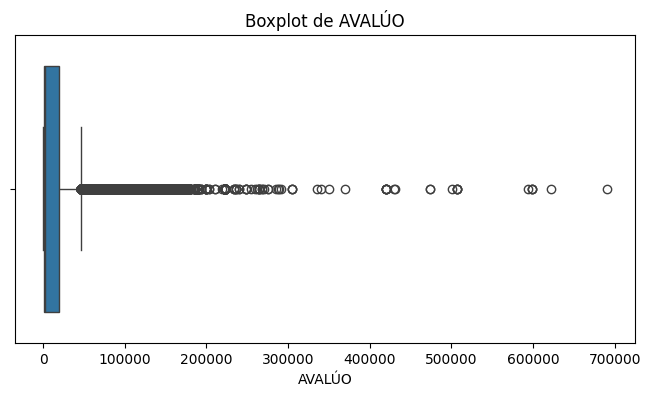

In [33]:
# Crea el boxplot de la columna 'AVALÚO'
plt.figure(figsize=(8, 4))
sns.boxplot(x=df['AVALÚO'])
plt.title('Boxplot de AVALÚO')
plt.show()

In [34]:
# IQR method to remove outliers
Q1 = df['AVALÚO'].quantile(0.25)
Q3 = df['AVALÚO'].quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter out outliers
df = df[(df['AVALÚO'] >= lower_bound) & (df['AVALÚO'] <= upper_bound)]
df.shape

(236451, 22)

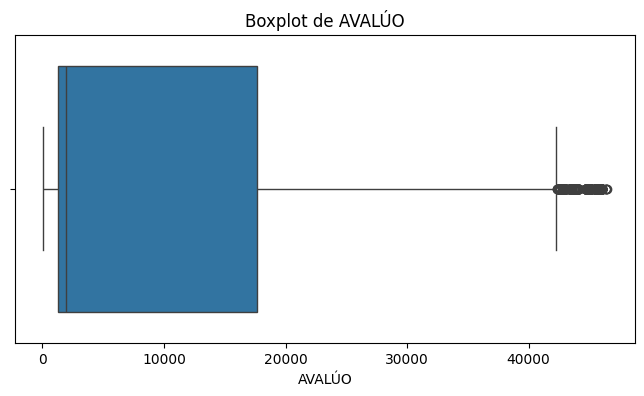

In [35]:
# prompt: Hacer un boxplot de 'AVALÚO' de df

# Crea el boxplot de la columna 'AVALÚO'
plt.figure(figsize=(8, 4))
sns.boxplot(x=df['AVALÚO'])
plt.title('Boxplot de AVALÚO')
plt.show()

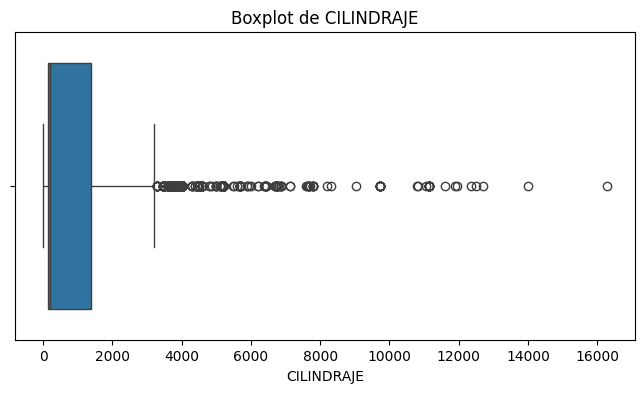

In [36]:
# Crea el boxplot de la columna 'CILINDRAJE'
plt.figure(figsize=(8, 4))
sns.boxplot(x=df['CILINDRAJE'])
plt.title('Boxplot de CILINDRAJE')
plt.show()

In [37]:
# IQR method to remove outliers
Q1 = df['CILINDRAJE'].quantile(0.25)
Q3 = df['CILINDRAJE'].quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter out outliers
df = df[(df['CILINDRAJE'] >= lower_bound) & (df['CILINDRAJE'] <= upper_bound)]
df.shape

(234346, 22)

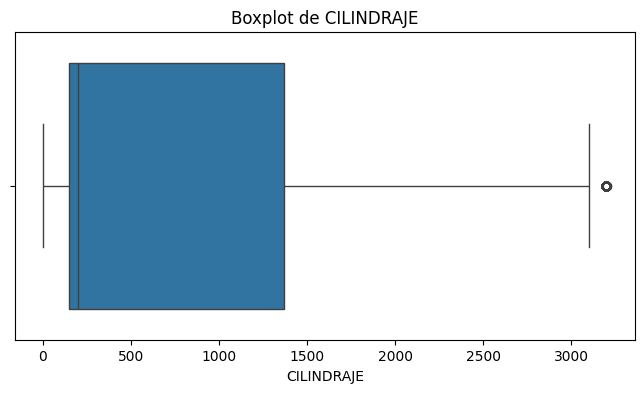

In [38]:
# Crea el boxplot de la columna 'CILINDRAJE'
plt.figure(figsize=(8, 4))
sns.boxplot(x=df['CILINDRAJE'])
plt.title('Boxplot de CILINDRAJE')
plt.show()

## Gráficos de barras por cada variable categórica

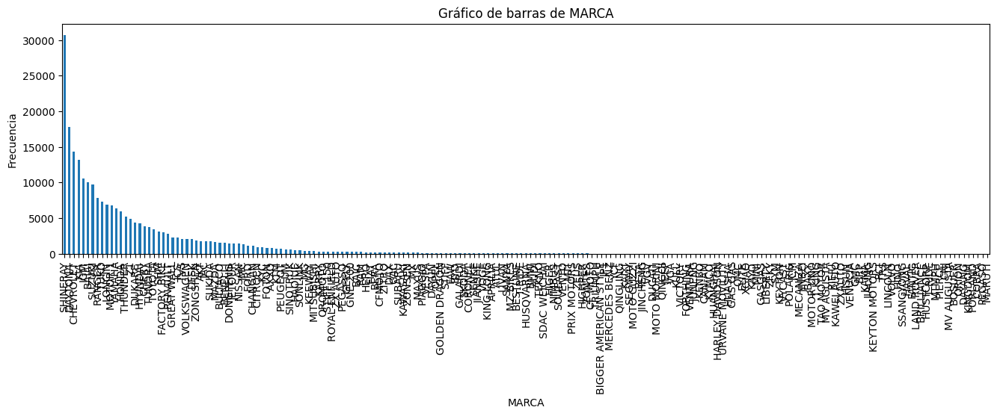

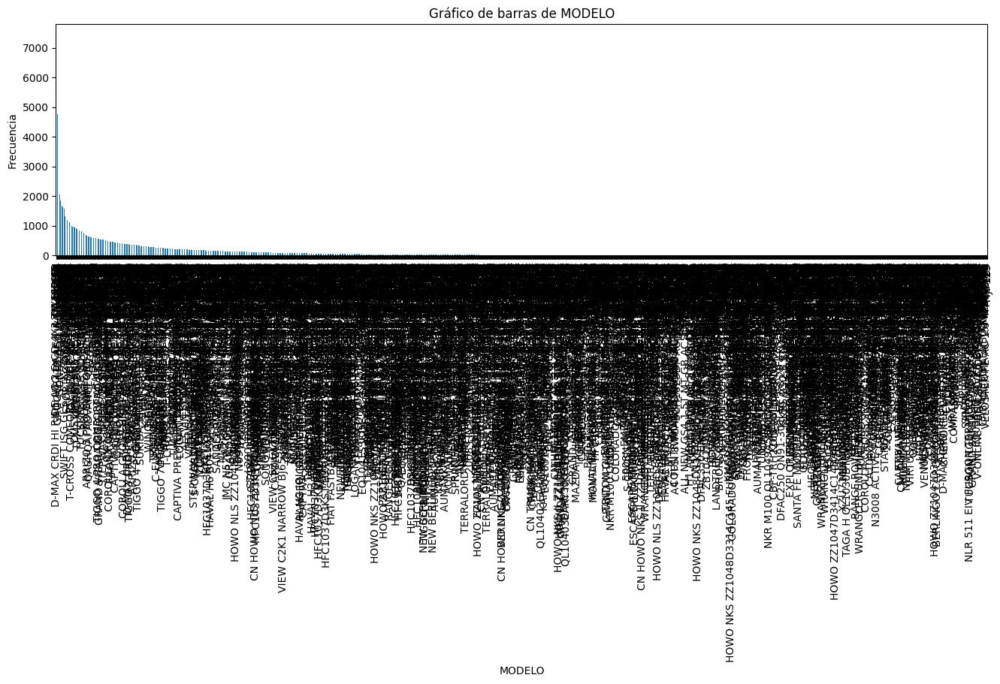

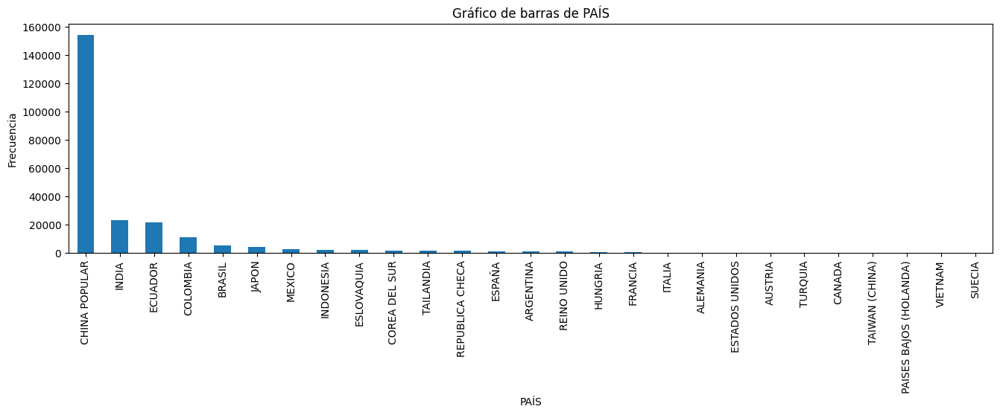

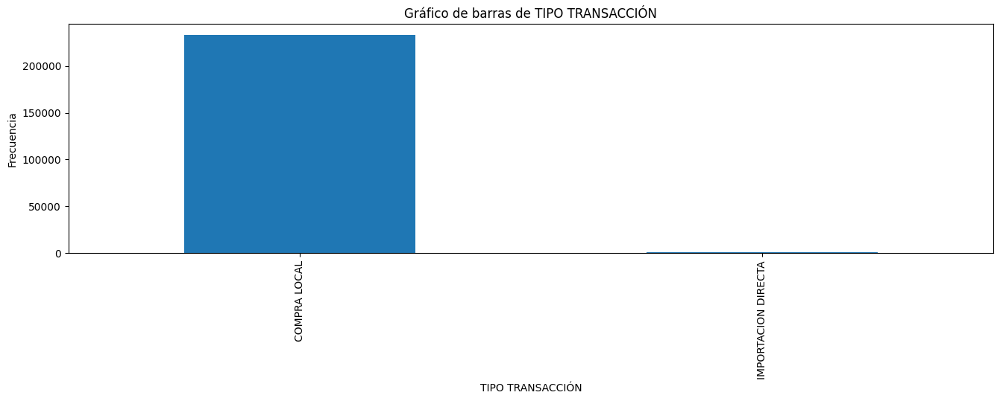

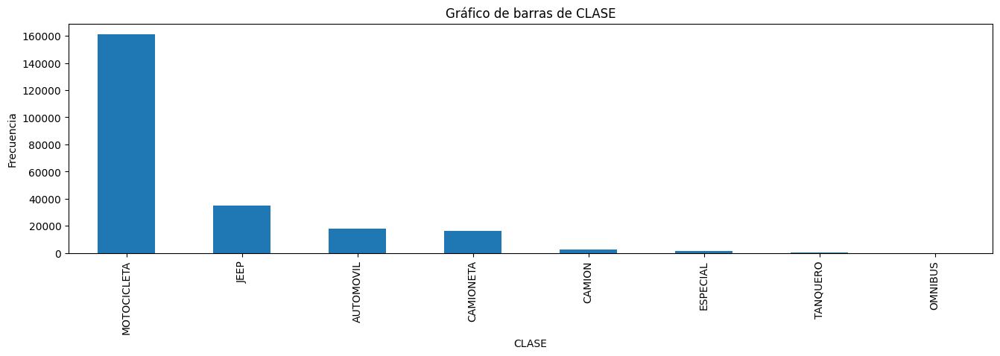

...

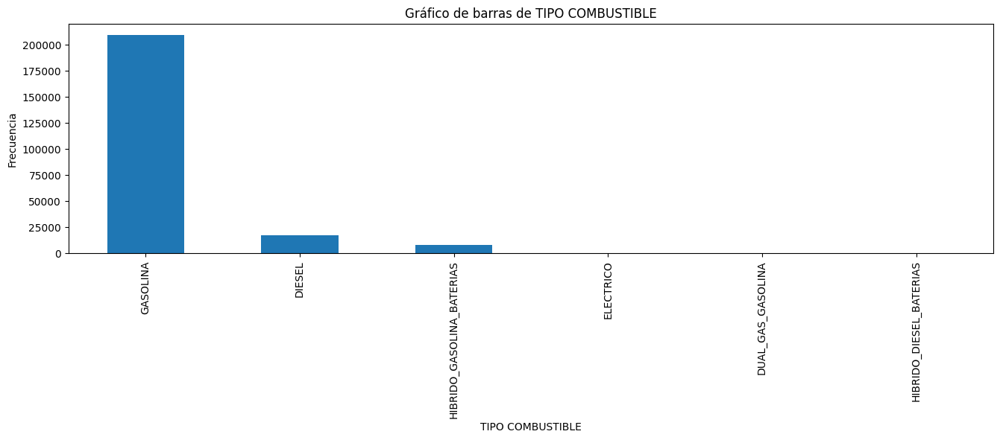

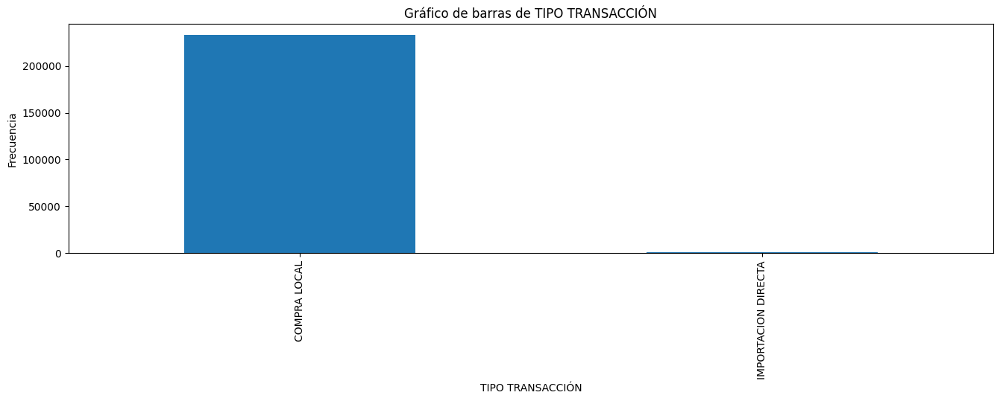

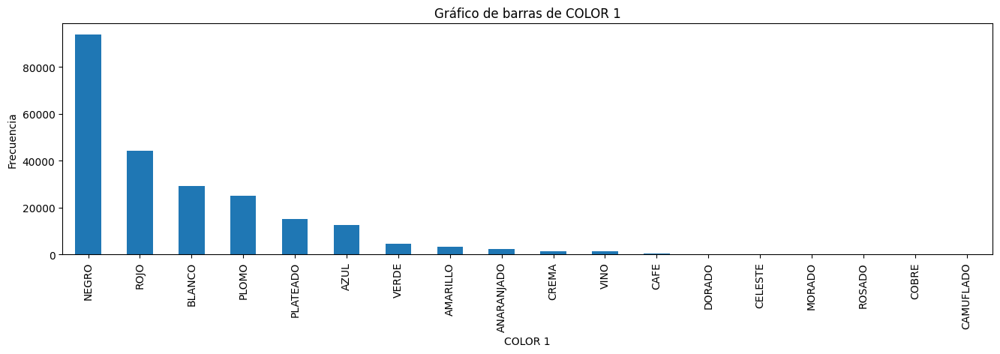

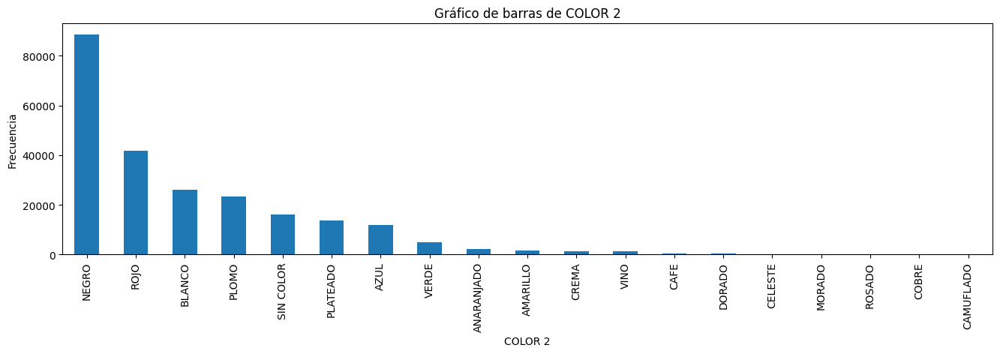

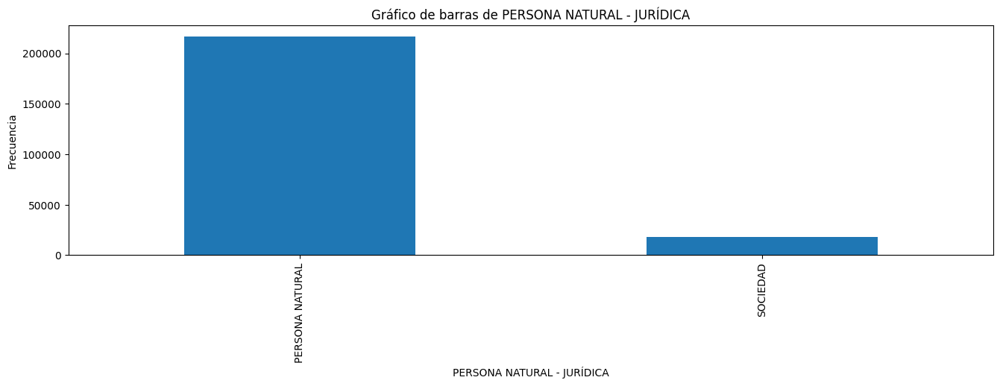

In [127]:
# Crear un subplot para mostrar solamente gráfico de barras

# Selecciona las columnas que deseas visualizar
columns_to_plot = ['MARCA', 'MODELO', 'PAÍS', 'TIPO TRANSACCIÓN', 'CLASE', 'SUB CLASE', 'CATEGORÍA', 'CANTÓN',
                   'PROVINCIA','TIPO SERVICIO', 'TIPO COMBUSTIBLE','TIPO TRANSACCIÓN','COLOR 1', 'COLOR 2',
                   'PERSONA NATURAL - JURÍDICA',]

# Itera sobre las columnas seleccionadas
for col in columns_to_plot:
  plt.figure(figsize=(16, 4))
  df[col].value_counts().plot(kind='bar')
  plt.title(f'Gráfico de barras de {col}')
  plt.xlabel(col)
  plt.ylabel('Frecuencia')
  plt.show()

## Histogramas de las variables numéricas

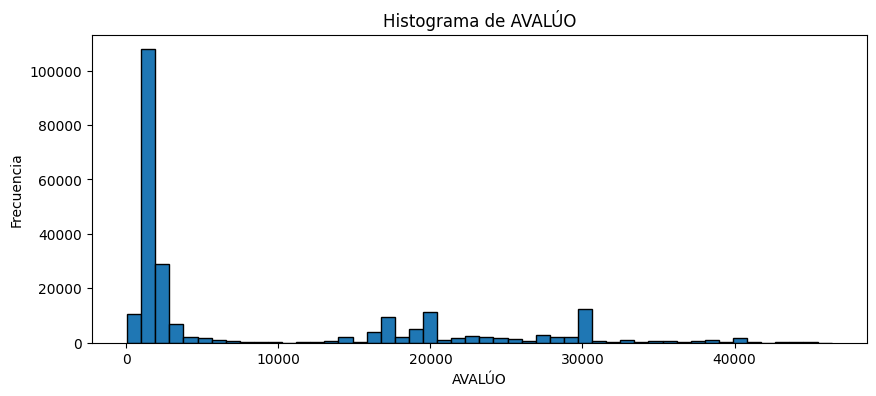

In [119]:
plt.figure(figsize=(10, 4))
plt.hist(df['AVALÚO'], bins=50, edgecolor='k')
plt.xlabel('AVALÚO')
plt.ylabel('Frecuencia')
plt.title('Histograma de AVALÚO')
plt.show()

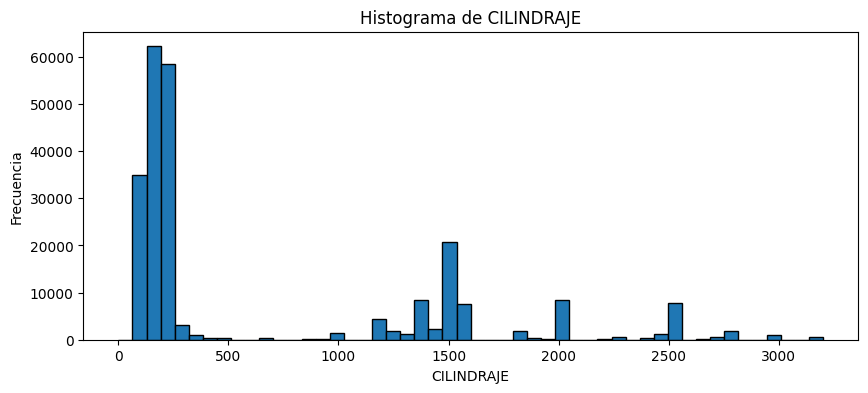

In [120]:
plt.figure(figsize=(10, 4))
plt.hist(df['CILINDRAJE'], bins=50, edgecolor='k')
plt.xlabel('CILINDRAJE')
plt.ylabel('Frecuencia')
plt.title('Histograma de CILINDRAJE')
plt.show()

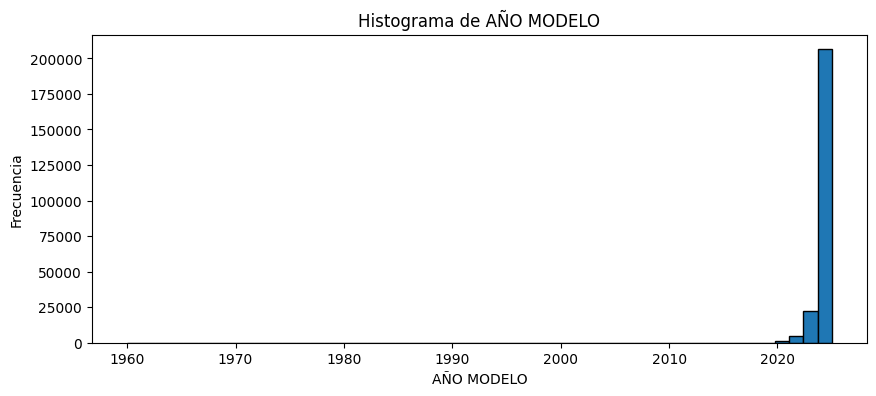

In [124]:
plt.figure(figsize=(10, 4))
plt.hist(df['AÑO MODELO'], bins=50, edgecolor='k')
plt.xlabel('AÑO MODELO')
plt.ylabel('Frecuencia')
plt.title('Histograma de AÑO MODELO')
plt.show()

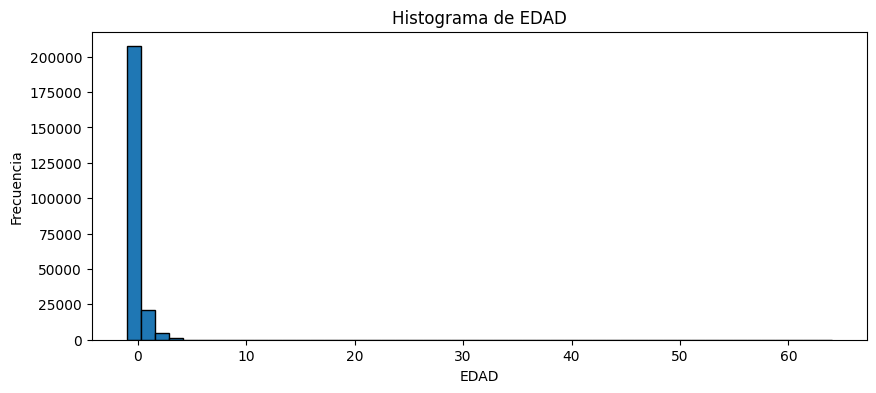

In [121]:
plt.figure(figsize=(10, 4))
plt.hist(df['EDAD'], bins=50, edgecolor='k')
plt.xlabel('EDAD')
plt.ylabel('Frecuencia')
plt.title('Histograma de EDAD')
plt.show()

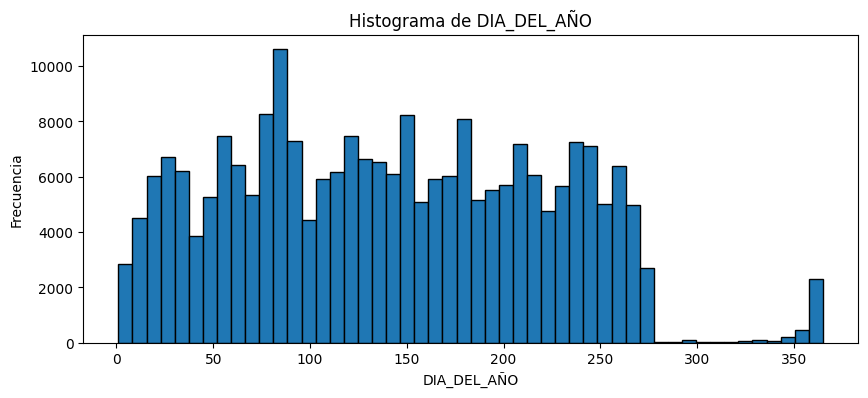

In [122]:
plt.figure(figsize=(10, 4))
plt.hist(df['DIA_DEL_AÑO'], bins=50, edgecolor='k')
plt.xlabel('DIA_DEL_AÑO')
plt.ylabel('Frecuencia')
plt.title('Histograma de DIA_DEL_AÑO')
plt.show()

## Agrupación de categorías

In [39]:
df2 = df.copy()
df2.shape

(234346, 22)

In [40]:
columnas_a_agrupar = ['TIPO TRANSACCIÓN','PAÍS','CLASE','SUB CLASE','TIPO','TIPO SERVICIO','TIPO COMBUSTIBLE',
                        'COLOR 1','COLOR 2','PERSONA NATURAL - JURÍDICA','MARCA','MODELO','CANTÓN','CATEGORÍA',
                      'DIA_DEL_AÑO','PROVINCIA'
]
for col in columnas_a_agrupar:
    threshold = 5  # Umbral mínimo de registros por categoría
    freq_map = df2[col].value_counts()
    df2[col] = df2[col].apply(lambda x: x if freq_map[x] > threshold else 'OTRO')

## Análisis ANOVA para variables categóricas

In [41]:
# Cuenta cuántos valores únicos hay para cada variable

for col in df2.columns:
  print(f'{col}: {df2[col].nunique()} unique values')

CATEGORÍA: 1958 unique values
CÓDIGO DE VEHÍCULO: 234341 unique values
TIPO TRANSACCIÓN: 2 unique values
MARCA: 156 unique values
MODELO: 1270 unique values
PAÍS: 25 unique values
AÑO MODELO: 26 unique values
CLASE: 8 unique values
SUB CLASE: 30 unique values
TIPO: 2 unique values
AVALÚO: 2209 unique values
TIPO SERVICIO: 2 unique values
CILINDRAJE: 307 unique values
TIPO COMBUSTIBLE: 6 unique values
FECHA COMPRA (MM/DD/AA): 540 unique values
PERSONA NATURAL - JURÍDICA: 2 unique values
COLOR 1: 18 unique values
COLOR 2: 19 unique values
CANTÓN: 161 unique values
PROVINCIA: 24 unique values
EDAD: 25 unique values
DIA_DEL_AÑO: 320 unique values


In [131]:
columnas_a_codificar = ['TIPO TRANSACCIÓN','PAÍS','CLASE','SUB CLASE','TIPO','TIPO SERVICIO','TIPO COMBUSTIBLE','PROVINCIA',
                        'COLOR 1','COLOR 2','PERSONA NATURAL - JURÍDICA','MARCA','MODELO','CANTÓN','CATEGORÍA','DIA_DEL_AÑO',
]

for col in columnas_a_codificar:
    print(col)
    # Separar las categorías
    categories = [df2[df2[col] == cat]['AVALÚO'] for cat in df2[col].unique()]

    # Prueba ANOVA
    anova_result = f_oneway(*categories)
    print("F-statistic:", anova_result.statistic)
    print("p-value:", anova_result.pvalue)
    print()

# Si el p-value < 0.05, hay una correlación significativa


TIPO TRANSACCIÓN
F-statistic: 2331.3214522950348
p-value: 0.0

PAÍS
F-statistic: 5573.322525561625
p-value: 0.0

CLASE
F-statistic: 322668.47240739904
p-value: 0.0

SUB CLASE
F-statistic: 89846.9195474685
p-value: 0.0

TIPO
F-statistic: 13700.38188792812
p-value: 0.0

TIPO SERVICIO
F-statistic: 3788.8802384967985
p-value: 0.0

TIPO COMBUSTIBLE
F-statistic: 29215.08386714914
p-value: 0.0

PROVINCIA
F-statistic: 2640.1941523202577
p-value: 0.0

COLOR 1
F-statistic: 7281.179298206846
p-value: 0.0

COLOR 2
F-statistic: 6088.835296575612
p-value: 0.0

PERSONA NATURAL - JURÍDICA
F-statistic: 31383.438587349563
p-value: 0.0

MARCA
F-statistic: 9085.869280103556
p-value: 0.0

MODELO
F-statistic: 16521.19173153646
p-value: 0.0

CANTÓN
F-statistic: 596.0403908983218
p-value: 0.0

CATEGORÍA
F-statistic: 7174.674433705029
p-value: 0.0

DIA_DEL_AÑO
F-statistic: 109.37873035049792
p-value: 0.0



## Target Encoding

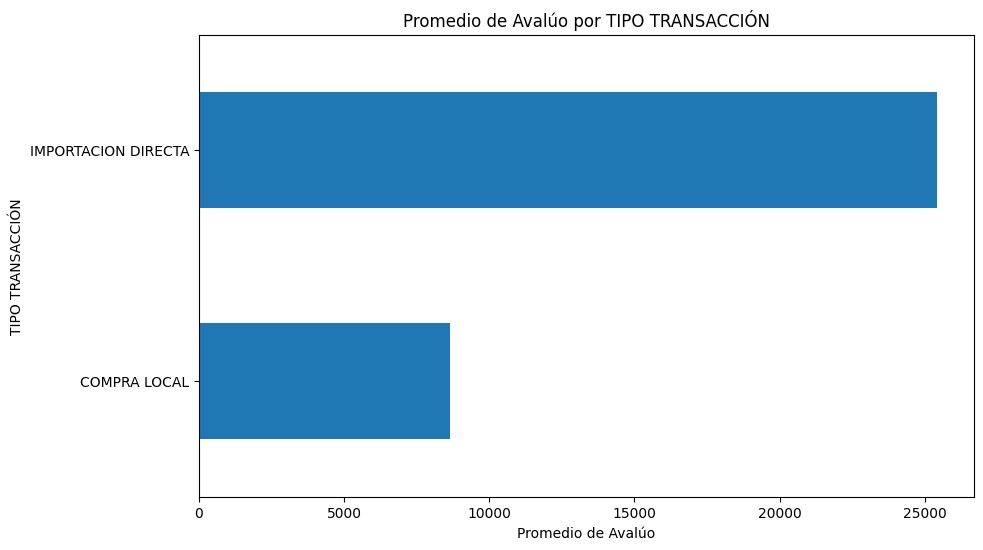

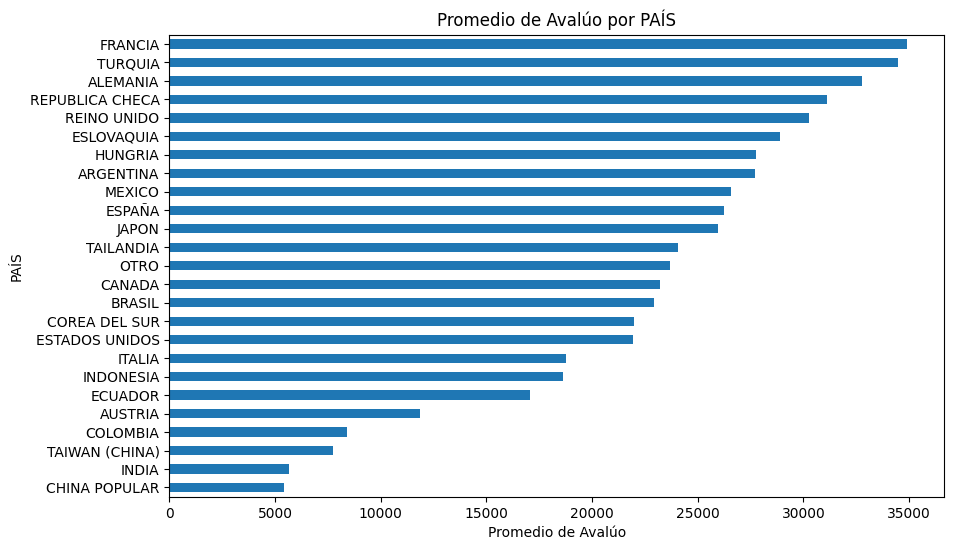

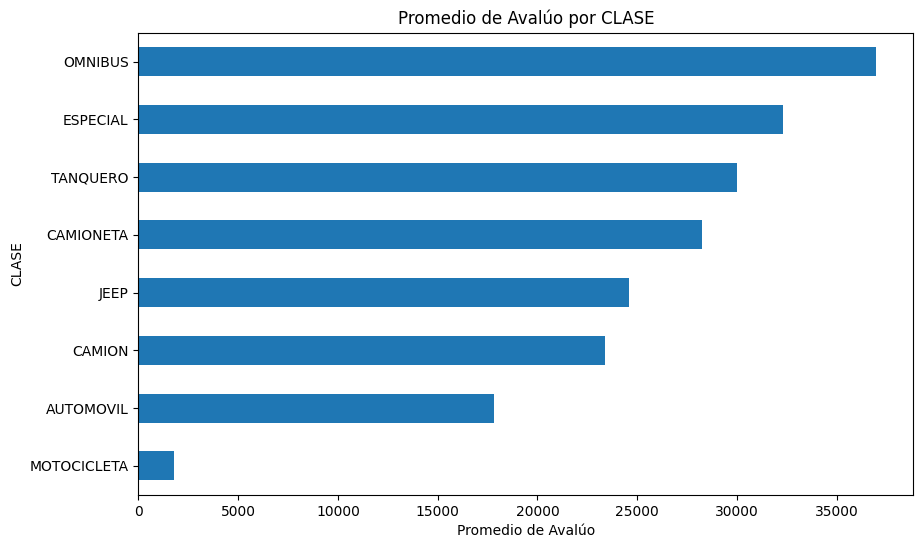

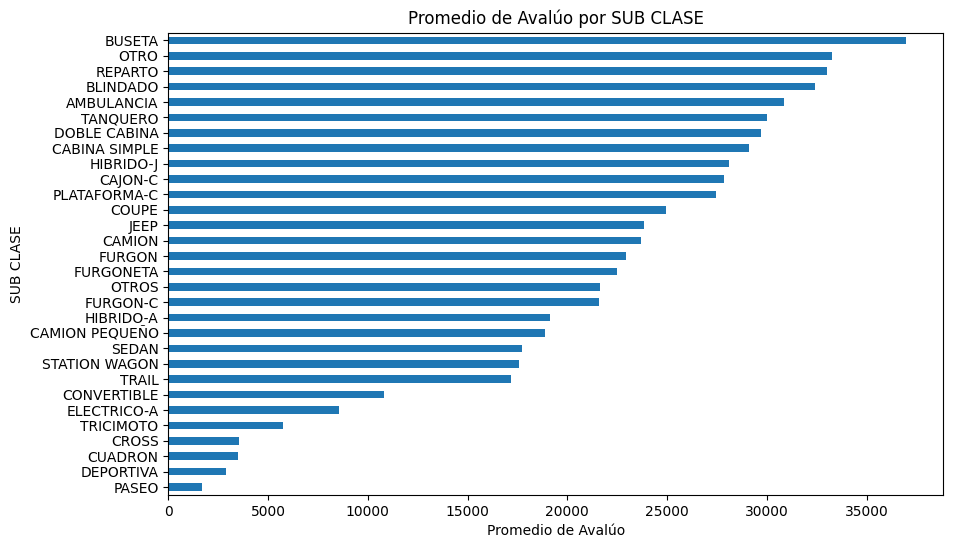

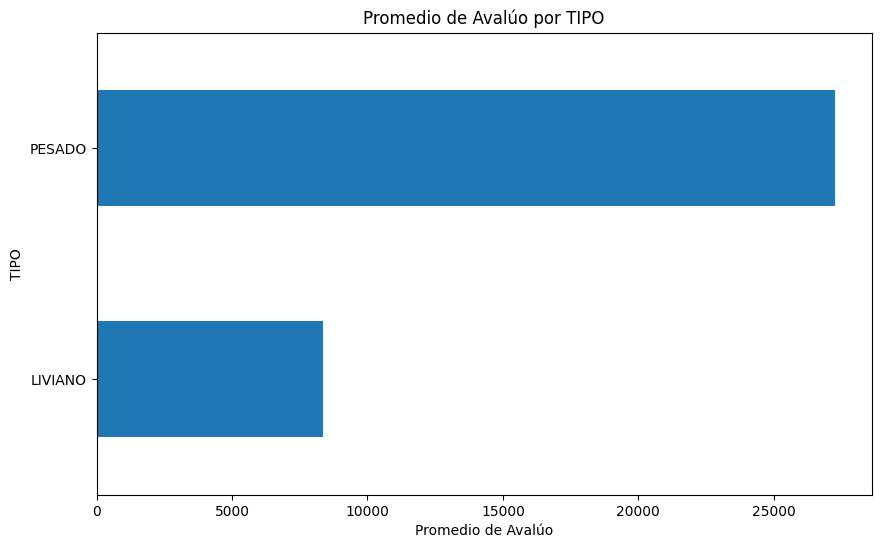

...

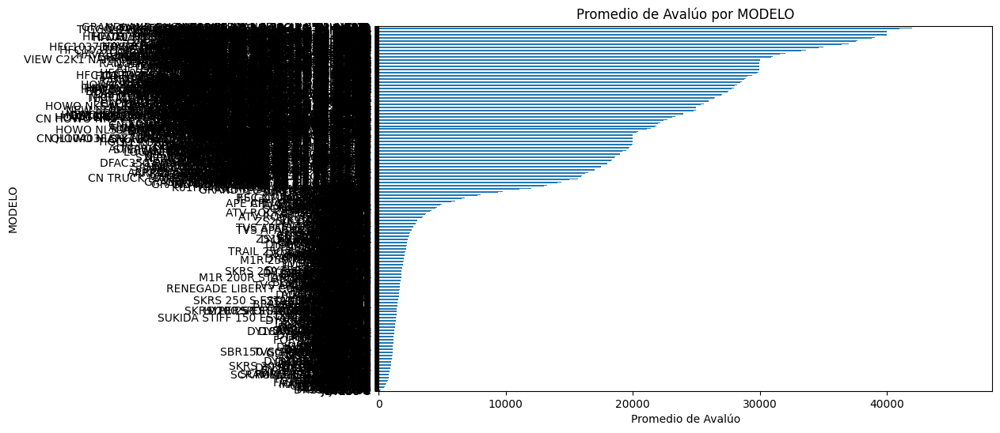

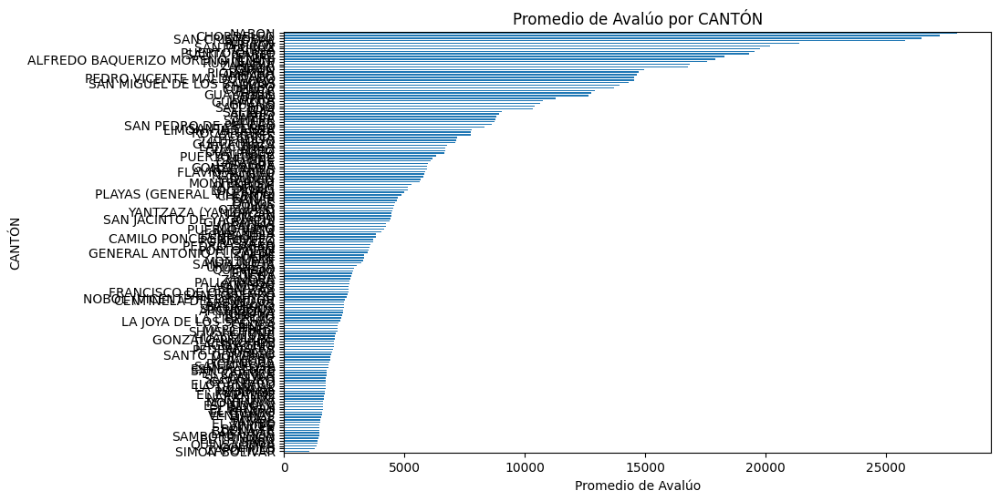

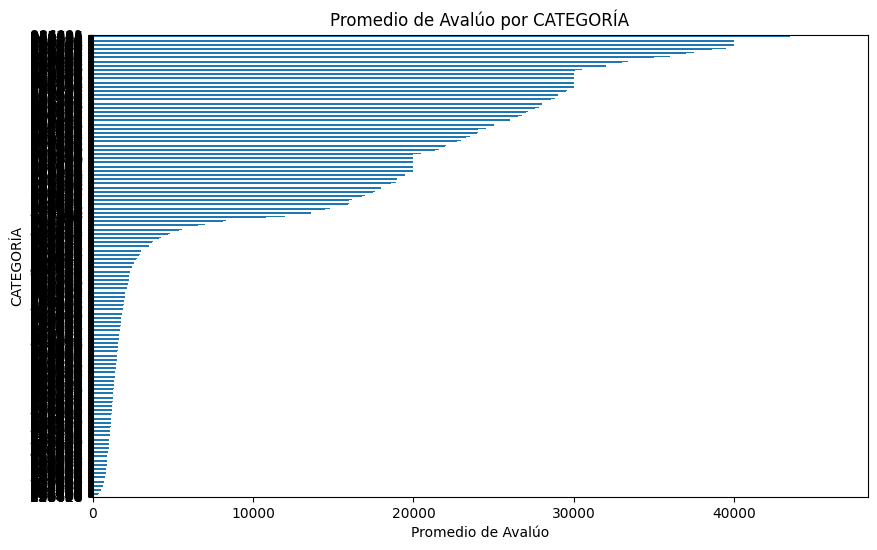

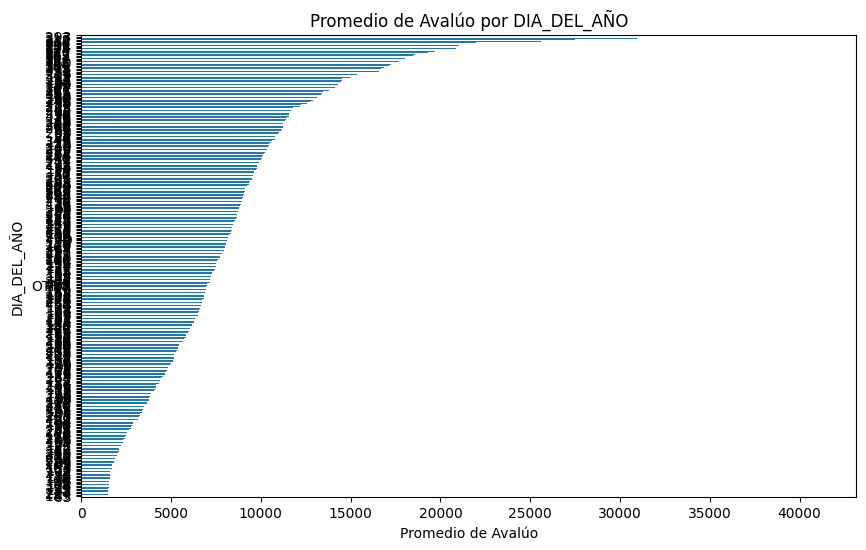

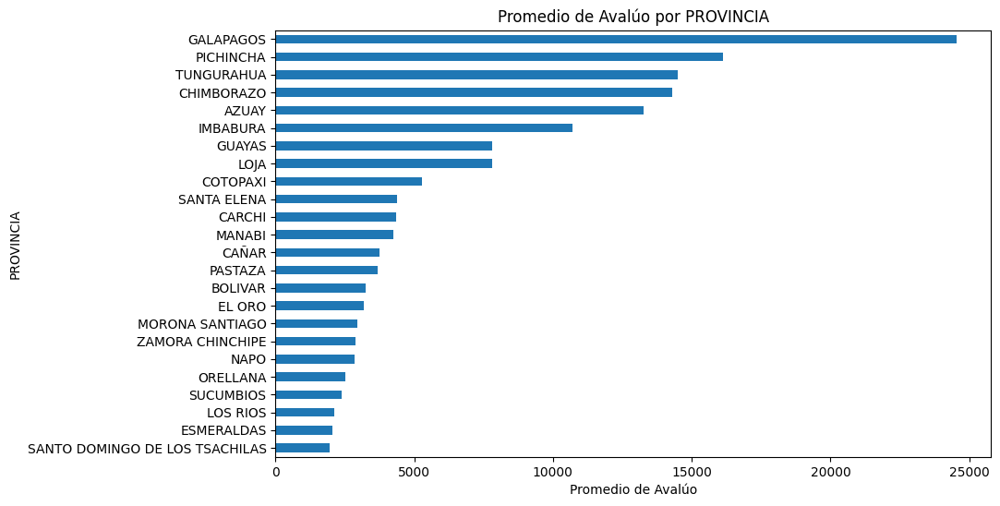

In [132]:
columnas_a_codificar = ['TIPO TRANSACCIÓN','PAÍS','CLASE','SUB CLASE','TIPO','TIPO SERVICIO','TIPO COMBUSTIBLE',
                        'COLOR 1','COLOR 2','PERSONA NATURAL - JURÍDICA','MARCA','MODELO','CANTÓN','CATEGORÍA',
                        'DIA_DEL_AÑO', 'PROVINCIA',
]

for col in columnas_a_codificar:
    average_avaluos = df2.groupby(col)['AVALÚO'].mean().sort_values(ascending=True)

    # Create the horizontal bar plot
    plt.figure(figsize=(10, 6))
    average_avaluos.plot(kind='barh')
    plt.xlabel('Promedio de Avalúo')
    plt.ylabel(col)
    plt.title(f'Promedio de Avalúo por {col}')
    plt
    plt.show()

In [42]:
columnas_a_codificar = ['TIPO TRANSACCIÓN','PAÍS','CLASE','SUB CLASE','TIPO','TIPO SERVICIO','TIPO COMBUSTIBLE',
                        'COLOR 1','COLOR 2','PERSONA NATURAL - JURÍDICA','MARCA','MODELO','CANTÓN','CATEGORÍA',
                        'DIA_DEL_AÑO', 'PROVINCIA'
]

for col in columnas_a_codificar:
    df2[f"{col}_encoded"] = df2.groupby(col)['AVALÚO'].transform('mean')

df2.shape

(234346, 38)

## Análisis de Correlación de Pearson

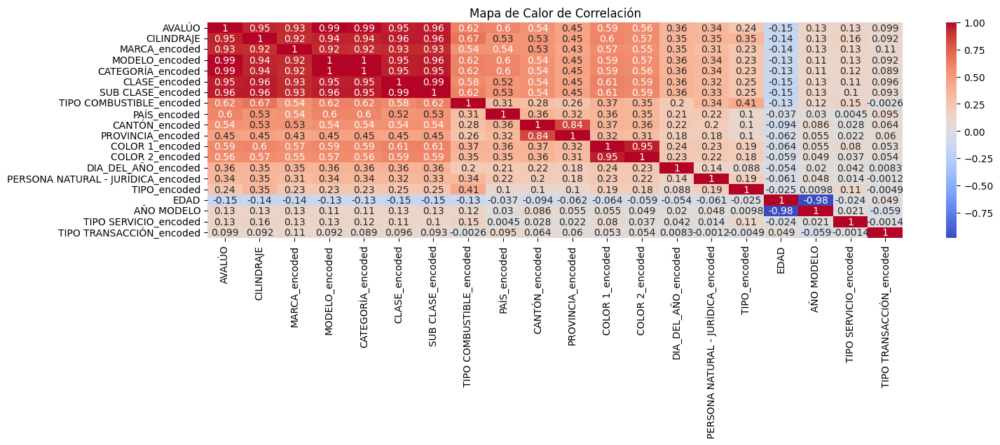

In [43]:
# Heatmap de Correlación de Avalúo, Performance, Equipamiento, Habitabilidad, Cilindraje
# Selecciona las columnas para el mapa de calor
columns_heatmap = ['AVALÚO', 'CILINDRAJE','MARCA_encoded','MODELO_encoded','CATEGORÍA_encoded','CLASE_encoded',
                   'SUB CLASE_encoded','TIPO COMBUSTIBLE_encoded','PAÍS_encoded','CANTÓN_encoded','PROVINCIA_encoded','COLOR 1_encoded',
                   'COLOR 2_encoded','DIA_DEL_AÑO_encoded','PERSONA NATURAL - JURÍDICA_encoded','TIPO_encoded',
                   'EDAD','AÑO MODELO','TIPO SERVICIO_encoded','TIPO TRANSACCIÓN_encoded']

# Calcula la matriz de correlación
corr_matrix = df2[columns_heatmap].corr()

# Crea el mapa de calor
plt.figure(figsize=(16, 4))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Mapa de Calor de Correlación')
plt.show()

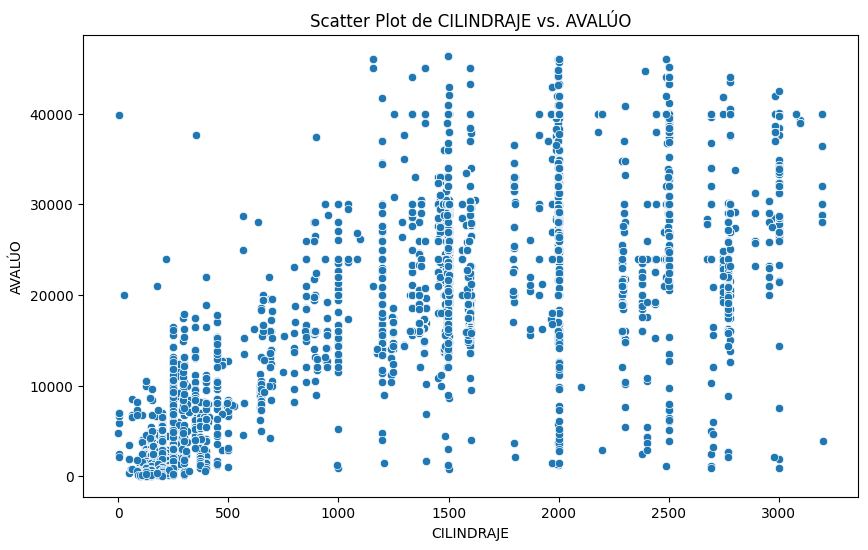

In [44]:
# Scatter plot de "CILINDRAJE" vs "AVALÚO"
plt.figure(figsize=(10, 6))
sns.scatterplot(x='CILINDRAJE', y='AVALÚO', data=df2)
plt.title('Scatter Plot de CILINDRAJE vs. AVALÚO')
plt.xlabel('CILINDRAJE')
plt.ylabel('AVALÚO')
plt.show()

In [45]:
df2.columns

Index(['CATEGORÍA', 'CÓDIGO DE VEHÍCULO', 'TIPO TRANSACCIÓN', 'MARCA',
       'MODELO', 'PAÍS', 'AÑO MODELO', 'CLASE', 'SUB CLASE', 'TIPO', 'AVALÚO',
       'TIPO SERVICIO', 'CILINDRAJE', 'TIPO COMBUSTIBLE',
       'FECHA COMPRA (MM/DD/AA)', 'PERSONA NATURAL - JURÍDICA', 'COLOR 1',
       'COLOR 2', 'CANTÓN', 'PROVINCIA', 'EDAD', 'DIA_DEL_AÑO',
       'TIPO TRANSACCIÓN_encoded', 'PAÍS_encoded', 'CLASE_encoded',
       'SUB CLASE_encoded', 'TIPO_encoded', 'TIPO SERVICIO_encoded',
       'TIPO COMBUSTIBLE_encoded', 'COLOR 1_encoded', 'COLOR 2_encoded',
       'PERSONA NATURAL - JURÍDICA_encoded', 'MARCA_encoded', 'MODELO_encoded',
       'CANTÓN_encoded', 'CATEGORÍA_encoded', 'DIA_DEL_AÑO_encoded',
       'PROVINCIA_encoded'],
      dtype='object')

In [47]:
df2.drop(columns=['CÓDIGO DE VEHÍCULO','CATEGORÍA','SUB CLASE','COLOR 2',
                  'PROVINCIA','COLOR 2_encoded','PROVINCIA_encoded'], inplace=True)
df2.shape

(234346, 31)

# Descripción de cómo se resolverá el problema

Para resolver el problema de predicción del avalúo de vehículos usados, se ha seguido un enfoque de modelado supervisado que explora tanto modelos lineales como no lineales. Primero, se implementaron modelos de regresión lineal simple, regresión polinómica y regresión lineal múltiple para establecer líneas base que capturen relaciones lineales y no lineales directas entre las variables explicativas y el avalúo. En estos tres primeros modelos, se aplicó ElasticNet como regularización para manejar posibles multicolinealidades y seleccionar características relevantes, optimizando sus hiperparámetros mediante validación cruzada para mejorar la generalización.

Posteriormente, se exploraron modelos no lineales, incluyendo Árboles de Decisión y Random Forest, capaces de capturar interacciones complejas entre las variables de entrada. Random Forest, en particular, se utilizó para mejorar la precisión y reducir la varianza de los modelos individuales de árbol. Adicionalmente, se construyeron modelos basados en redes neuronales, como la Red Perceptrón Multicapa (MLP) y la Red Convolucional (CNN). La red MLP fue diseñada para capturar relaciones complejas mediante capas densas, mientras que la CNN se adaptó a los datos tabulares usando convoluciones 1D, aprovechando su capacidad para identificar patrones espaciales en las características.

En todos los casos, se empleó validación cruzada para evaluar de forma robusta el rendimiento de los modelos y garantizar su capacidad de generalización a nuevos datos. Este enfoque diversificado permitió identificar el modelo más adecuado para realizar predicciones precisas del avalúo en base a las características de los vehículos usados.

# Modelamiento

## Regresión Lineal Simple

1. Este modelo solo considera 'CILINDRAJE'.
2. Se creó la columna 'Estrato' que divide 'AVALÚO' en 40 estratos.
3. Se hizo la partición 80% train y 20% test considerando la variable 'Estrato'.
4. Se realizó el escalamiento de las variables predictoras (StandardScaler).
5. Se consideró la regularización ElasticNet para la regresión lineal.
6. Se realizó la validación cruzada para la optimización del entrenamiento.
7. Se usó la malla de búsqueda GridSearchCV para la optimización de búsqueda de hiperparámetros de alpha y l1_ratio.

In [138]:
X1 = pd.DataFrame(df2["CILINDRAJE"])

In [139]:
y1 = df2['AVALÚO'].values

In [140]:
df2.loc[:, 'Estrato'] = pd.cut(df2['AVALÚO'], 40, labels=False)
df2.head().T

,1,2,4,10,11
CATEGORÍA,OTRO,OTRO,OTRO,OTRO,OTRO
TIPO TRANSACCIÓN,COMPRA LOCAL,COMPRA LOCAL,COMPRA LOCAL,COMPRA LOCAL,COMPRA LOCAL
MARCA,JAC,DAYTONA,JAC,ZONSEN,ZONSEN
MODELO,OTRO,DY170 CAFE RACER,HFC1040KN AC 2.7 2P 4X2 TM DIESEL,ZS150T-48 ZT6,ZS150T-48 ZT6
PAÍS,CHINA POPULAR,CHINA POPULAR,CHINA POPULAR,CHINA POPULAR,CHINA POPULAR
AÑO MODELO,2025,2025,2025,2025,2025
CLASE,CAMION,MOTOCICLETA,CAMION,MOTOCICLETA,MOTOCICLETA
SUB CLASE,FURGON-C,PASEO,CAJON-C,PASEO,PASEO
TIPO,PESADO,LIVIANO,PESADO,LIVIANO,LIVIANO
AVALÚO,23180.0,1050.0,24190.0,1606.0,1606.0


In [141]:
X_train1, X_test1, y_train1, y_test1= train_test_split(
    X1,y1,test_size=0.2, random_state=42,
    stratify= df2['Estrato'])

In [142]:
# Se escalan X_train1 y X_test1 usando StandardScaler

# Crea un objeto StandardScaler
scaler = StandardScaler()

# Ajusta el scaler a los datos
X_train1_scaled = scaler.fit_transform(X_train1)
X_train1_scaled

X_test1_scaled = scaler.transform(X_test1)
X_test1_scaled

array([[-0.66650391],
       [-0.66650391],
       [ 1.45468516],
       ...,
       [-0.60199086],
       [-0.62650582],
       [-0.60199086]])

In [143]:
# Definir modelo
model_1 = ElasticNet()

In [144]:
# Estrategia de remuestreo
cv = RepeatedKFold(n_splits=5, n_repeats=2, random_state=42)
cv

RepeatedKFold(n_repeats=2, n_splits=5, random_state=42)

In [145]:
metricas = ['neg_mean_squared_error','neg_root_mean_squared_error', 'r2', 'neg_mean_absolute_error', 'neg_mean_absolute_percentage_error']

In [146]:
# Malla de hiperparámetros
grid = dict()
grid['alpha'] = [1e-9, 1e-7, 1e-3, 1e-1]
grid['l1_ratio'] = np.arange(0, 1, 0.2)

In [147]:
# Afinamiento de hiperparametros
enet_tuned = GridSearchCV(model_1, grid, cv= cv,
  scoring= metricas, refit= 'neg_mean_squared_error',  n_jobs=-1)

In [148]:
## Entrenar la malla
enet_tuned.fit(X_train1_scaled,  y_train1)

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.210e+12, tolerance: 2.276e+09 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(


GridSearchCV(cv=RepeatedKFold(n_repeats=2, n_splits=5, random_state=42),
             estimator=ElasticNet(), n_jobs=-1,
             param_grid={'alpha': [1e-09, 1e-07, 0.001, 0.1],
                         'l1_ratio': array([0. , 0.2, 0.4, 0.6, 0.8])},
             refit='neg_mean_squared_error',
             scoring=['neg_mean_squared_error', 'neg_root_mean_squared_error',
                      'r2', 'neg_mean_absolute_error',
                      'neg_mean_absolute_percentage_error'])

In [149]:
res_cv= pd.DataFrame(enet_tuned.cv_results_)
res_cv.columns

Index(['mean_fit_time', 'std_fit_time', 'mean_score_time', 'std_score_time',
       'param_alpha', 'param_l1_ratio', 'params',
       'split0_test_neg_mean_squared_error',
       'split1_test_neg_mean_squared_error',
       'split2_test_neg_mean_squared_error',
       'split3_test_neg_mean_squared_error',
       'split4_test_neg_mean_squared_error',
       'split5_test_neg_mean_squared_error',
       'split6_test_neg_mean_squared_error',
       'split7_test_neg_mean_squared_error',
       'split8_test_neg_mean_squared_error',
       'split9_test_neg_mean_squared_error',
       'mean_test_neg_mean_squared_error', 'std_test_neg_mean_squared_error',
       'rank_test_neg_mean_squared_error',
       'split0_test_neg_root_mean_squared_error',
       'split1_test_neg_root_mean_squared_error',
       'split2_test_neg_root_mean_squared_error',
       'split3_test_neg_root_mean_squared_error',
       'split4_test_neg_root_mean_squared_error',
       'split5_test_neg_root_mean_squared_error',
  

In [172]:
cols= res_cv.columns[ res_cv.columns.str.startswith('param_')].to_list() + res_cv.columns[
  res_cv.columns.str.startswith('mean_test') ].to_list()

res_cv_means= res_cv.loc[:, cols ].sort_values(by='mean_test_neg_mean_squared_error', ascending=False)
res_cv_means

,param_alpha,param_l1_ratio,mean_test_neg_mean_squared_error,mean_test_neg_root_mean_squared_error,mean_test_r2,mean_test_neg_mean_absolute_error,mean_test_neg_mean_absolute_percentage_error
4,1.000000e-09,0.8,-9.917482e+06,-3149.015118,0.918309,-1727.488128,-0.304164
3,1.000000e-09,0.6,-9.917482e+06,-3149.015118,0.918309,-1727.488130,-0.304164
2,1.000000e-09,0.4,-9.917482e+06,-3149.015119,0.918309,-1727.488131,-0.304164
1,1.000000e-09,0.2,-9.917482e+06,-3149.015119,0.918309,-1727.488133,-0.304164
0,1.000000e-09,0.0,-9.917482e+06,-3149.015119,0.918309,-1727.488135,-0.304164
9,1.000000e-07,0.8,-9.917482e+06,-3149.015124,0.918309,-1727.488292,-0.304164
8,1.000000e-07,0.6,-9.917482e+06,-3149.015130,0.918309,-1727.488457,-0.304164
7,1.000000e-07,0.4,-9.917482e+06,-3149.015136,0.918309,-1727.488623,-0.304164
6,1.000000e-07,0.2,-9.917482e+06,-3149.015142,0.918309,-1727.488788,-0.304164
5,1.000000e-07,0.0,-9.917482e+06,-3149.015148,0.918309,-1727.488953,-0.304164


In [151]:
# Mejor combinación
print('Mejor combinacion de Hiperparámetros: %s' % enet_tuned.best_params_)

Mejor combinacion de Hiperparámetros: {'alpha': 1e-07, 'l1_ratio': np.float64(0.0)}


In [152]:
# Mejor modelo
enet_fitted= enet_tuned.best_estimator_

In [153]:
# Predecir los valores de la variable objetivo en el conjunto de prueba
y_pred_test1 = enet_fitted.predict(X_test1_scaled)
y_pred_test1

array([ 1784.62510907,  1784.62510907, 23878.78513425, ...,
        2456.58861348,  2201.2424818 ,  2456.58861348])

In [154]:
# Se muestran en un dataframe los vectores y_test_4_valores, y_pred_test_4

# Crear un DataFrame con los valores de y_test_TP_valores e y_pred_test_TP
df_results_test1 = pd.DataFrame({'y_test_1_valores': y_test1, 'y_pred_test_1': y_pred_test1})

# Mostrar el DataFrame
print(df_results_test1)

       y_test_1_valores  y_pred_test_1
0               1300.00    1784.625109
1               1124.20    1784.625109
2              19990.00   23878.785134
3               1475.00    1233.615035
4               1519.63    2456.588613
...                 ...            ...
46865           2999.00    1448.643357
46866           1899.00    1314.250656
46867           1600.00    2456.588613
46868           1544.07    2201.242482
46869           4770.00    2456.588613

[46870 rows x 2 columns]


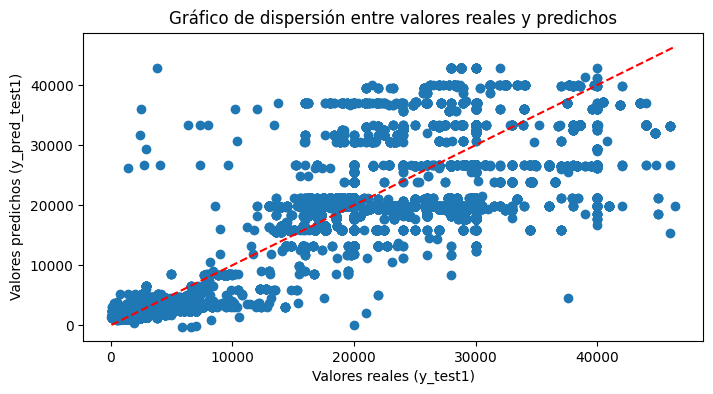

In [155]:
plt.figure(figsize=(8, 4))
plt.scatter(y_test1, y_pred_test1)
plt.xlabel("Valores reales (y_test1)")
plt.ylabel("Valores predichos (y_pred_test1)")
plt.title("Gráfico de dispersión entre valores reales y predichos")

# Agregar la recta identidad
plt.plot([min(y_test1), max(y_test1)], [min(y_test1), max(y_test1)], color='red', linestyle='--')

plt.show()

## Regresión Polinómica

1. Este modelo solo considera 'CILINDRAJE'.
2. Se creó la columna 'Estrato' que divide 'AVALÚO' en 40 estratos.
3. Se hizo la partición 80% train y 20% test considerando la variable 'Estrato'.
4. Se realizó el escalamiento de las variables predictoras (StandardScaler).
5. Se probaron diferentes grados de polinomio donde el grado 4 obtuvo los mejores valores en las métricas evaluación.
6. Se consideró la regularización ElasticNet para la regresión polinómica.
7. Se realizó la validación cruzada para la optimización del entrenamiento.
8. Se usó la malla de búsqueda GridSearchCV para la optimización de búsqueda de hiperparámetros de alpha y l1_ratio.

In [157]:
X2 = pd.DataFrame(df2["CILINDRAJE"])

In [158]:
y2 = df2['AVALÚO'].values

In [159]:
df2.loc[:, 'Estrato'] = pd.cut(df2['AVALÚO'], 40, labels=False)
df2.head().T

,1,2,4,10,11
CATEGORÍA,OTRO,OTRO,OTRO,OTRO,OTRO
TIPO TRANSACCIÓN,COMPRA LOCAL,COMPRA LOCAL,COMPRA LOCAL,COMPRA LOCAL,COMPRA LOCAL
MARCA,JAC,DAYTONA,JAC,ZONSEN,ZONSEN
MODELO,OTRO,DY170 CAFE RACER,HFC1040KN AC 2.7 2P 4X2 TM DIESEL,ZS150T-48 ZT6,ZS150T-48 ZT6
PAÍS,CHINA POPULAR,CHINA POPULAR,CHINA POPULAR,CHINA POPULAR,CHINA POPULAR
AÑO MODELO,2025,2025,2025,2025,2025
CLASE,CAMION,MOTOCICLETA,CAMION,MOTOCICLETA,MOTOCICLETA
SUB CLASE,FURGON-C,PASEO,CAJON-C,PASEO,PASEO
TIPO,PESADO,LIVIANO,PESADO,LIVIANO,LIVIANO
AVALÚO,23180.0,1050.0,24190.0,1606.0,1606.0


In [160]:
X_train2, X_test2, y_train2, y_test2= train_test_split(
    X2,y2,test_size=0.2, random_state=42,
    stratify= df2['Estrato'])

In [161]:
# Se escalan X_train2 y X_test2 usando StandardScaler

# Crea un objeto StandardScaler
scaler = StandardScaler()

# Ajusta el scaler a los datos
X_train2_scaled = scaler.fit_transform(X_train2)
X_train2_scaled

X_test2_scaled = scaler.transform(X_test2)
X_test2_scaled

array([[-0.66650391],
       [-0.66650391],
       [ 1.45468516],
       ...,
       [-0.60199086],
       [-0.62650582],
       [-0.60199086]])

In [162]:
# Expansión polinómica de la variable 'CILINDRAJE'
poly = PolynomialFeatures(degree=4, include_bias=False)
X_train_poly = poly.fit_transform(X_train2_scaled)
X_test_poly = poly.transform(X_test2_scaled)

In [163]:
# Definir modelo
model_2 = ElasticNet()

In [164]:
# Estrategia de remuestreo
cv = RepeatedKFold(n_splits=5, n_repeats=2, random_state=42)
cv

RepeatedKFold(n_repeats=2, n_splits=5, random_state=42)

In [165]:
metricas = ['neg_mean_squared_error','neg_root_mean_squared_error', 'r2', 'neg_mean_absolute_error', 'neg_mean_absolute_percentage_error']

In [166]:
# Malla de hiperparámetros
grid = dict()
grid['alpha'] = [1e-9, 1e-7, 1e-3, 1e-1]
grid['l1_ratio'] = np.arange(0, 1, 0.2)

In [167]:
# Afinamiento de hiperparametros
enet_tuned = GridSearchCV(model_2, grid, cv= cv,
  scoring= metricas, refit= 'neg_mean_squared_error',  n_jobs=-1)

In [168]:
## Entrenar la malla
enet_tuned.fit(X_train_poly,  y_train2)

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.295e+11, tolerance: 2.276e+09
  model = cd_fast.enet_coordinate_descent(


GridSearchCV(cv=RepeatedKFold(n_repeats=2, n_splits=5, random_state=42),
             estimator=ElasticNet(), n_jobs=-1,
             param_grid={'alpha': [1e-09, 1e-07, 0.001, 0.1],
                         'l1_ratio': array([0. , 0.2, 0.4, 0.6, 0.8])},
             refit='neg_mean_squared_error',
             scoring=['neg_mean_squared_error', 'neg_root_mean_squared_error',
                      'r2', 'neg_mean_absolute_error',
                      'neg_mean_absolute_percentage_error'])

In [169]:
res_cv= pd.DataFrame(enet_tuned.cv_results_)
res_cv.columns

Index(['mean_fit_time', 'std_fit_time', 'mean_score_time', 'std_score_time',
       'param_alpha', 'param_l1_ratio', 'params',
       'split0_test_neg_mean_squared_error',
       'split1_test_neg_mean_squared_error',
       'split2_test_neg_mean_squared_error',
       'split3_test_neg_mean_squared_error',
       'split4_test_neg_mean_squared_error',
       'split5_test_neg_mean_squared_error',
       'split6_test_neg_mean_squared_error',
       'split7_test_neg_mean_squared_error',
       'split8_test_neg_mean_squared_error',
       'split9_test_neg_mean_squared_error',
       'mean_test_neg_mean_squared_error', 'std_test_neg_mean_squared_error',
       'rank_test_neg_mean_squared_error',
       'split0_test_neg_root_mean_squared_error',
       'split1_test_neg_root_mean_squared_error',
       'split2_test_neg_root_mean_squared_error',
       'split3_test_neg_root_mean_squared_error',
       'split4_test_neg_root_mean_squared_error',
       'split5_test_neg_root_mean_squared_error',
  

In [170]:
cols= res_cv.columns[ res_cv.columns.str.startswith('param_')].to_list() + res_cv.columns[
  res_cv.columns.str.startswith('mean_test') ].to_list()

In [173]:
res_cv_means= res_cv.loc[:, cols ].sort_values(by='mean_test_neg_mean_squared_error', ascending=False)
res_cv_means

,param_alpha,param_l1_ratio,mean_test_neg_mean_squared_error,mean_test_neg_root_mean_squared_error,mean_test_r2,mean_test_neg_mean_absolute_error,mean_test_neg_mean_absolute_percentage_error
4,1.000000e-09,0.8,-9.917482e+06,-3149.015118,0.918309,-1727.488128,-0.304164
3,1.000000e-09,0.6,-9.917482e+06,-3149.015118,0.918309,-1727.488130,-0.304164
2,1.000000e-09,0.4,-9.917482e+06,-3149.015119,0.918309,-1727.488131,-0.304164
1,1.000000e-09,0.2,-9.917482e+06,-3149.015119,0.918309,-1727.488133,-0.304164
0,1.000000e-09,0.0,-9.917482e+06,-3149.015119,0.918309,-1727.488135,-0.304164
9,1.000000e-07,0.8,-9.917482e+06,-3149.015124,0.918309,-1727.488292,-0.304164
8,1.000000e-07,0.6,-9.917482e+06,-3149.015130,0.918309,-1727.488457,-0.304164
7,1.000000e-07,0.4,-9.917482e+06,-3149.015136,0.918309,-1727.488623,-0.304164
6,1.000000e-07,0.2,-9.917482e+06,-3149.015142,0.918309,-1727.488788,-0.304164
5,1.000000e-07,0.0,-9.917482e+06,-3149.015148,0.918309,-1727.488953,-0.304164


In [174]:
# Mejor combinación
print('Mejor combinacion de Hiperparámetros: %s' % enet_tuned.best_params_)

Mejor combinacion de Hiperparámetros: {'alpha': 1e-09, 'l1_ratio': np.float64(0.8)}


In [175]:
# Mejor modelo
enet_fitted= enet_tuned.best_estimator_

In [176]:
# Predecir los valores de la variable objetivo en el conjunto de prueba
y_pred_test2 = enet_fitted.predict(X_test_poly)
y_pred_test2

array([ 1473.12176144,  1473.12176144, 26002.49660348, ...,
        2016.7686975 ,  1805.18174278,  2016.7686975 ])

In [177]:
# Se muestran en un dataframe los vectores y_test_2_valores, y_pred_test_2

# Crear un DataFrame con los valores de y_test_TP_valores e y_pred_test_TP
df_results_test2 = pd.DataFrame({'y_test_2_valores': y_test2, 'y_pred_test_2': y_pred_test2})

# Mostrar el DataFrame
print(df_results_test2)

       y_test_2_valores  y_pred_test_2
0               1300.00    1473.121761
1               1124.20    1473.121761
2              19990.00   26002.496603
3               1475.00    1060.206282
4               1519.63    2016.768697
...                 ...            ...
46865           2999.00    1217.685226
46866           1899.00    1118.702586
46867           1600.00    2016.768697
46868           1544.07    1805.181743
46869           4770.00    2016.768697

[46870 rows x 2 columns]


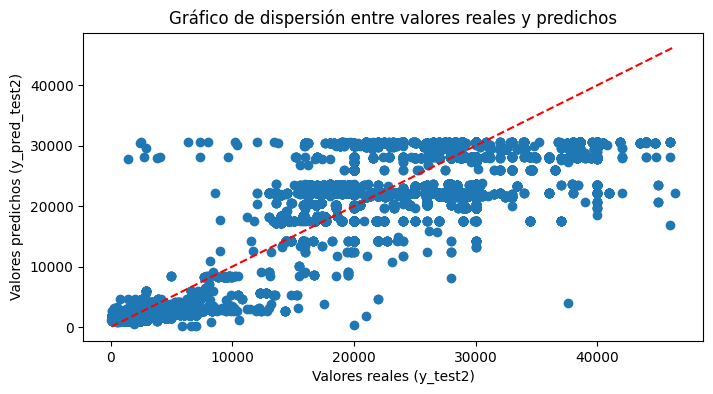

In [178]:
plt.figure(figsize=(8, 4))
plt.scatter(y_test2, y_pred_test2)
plt.xlabel("Valores reales (y_test2)")
plt.ylabel("Valores predichos (y_pred_test2)")
plt.title("Gráfico de dispersión entre valores reales y predichos")

# Agregar la recta identidad
plt.plot([min(y_test2), max(y_test2)], [min(y_test2), max(y_test2)], color='red', linestyle='--')

plt.show()

## Regresión Lineal Múltiple

1. Este modelo considera aquellas variables que no presentaron multicolinealidad en la sección de "Análisis de Correlación de Pearson"
2. Se creó la columna 'Estrato' que divide 'AVALÚO' en 40 estratos.
3. Se hizo la partición 80% train y 20% test considerando la variable 'Estrato'.
4. Se realizó el escalamiento de las variables predictoras (StandardScaler).
5. Se consideró la regularización ElasticNet para la regresión polinómica.
6. Se realizó la validación cruzada para la optimización del entrenamiento.
7. Se usó la malla de búsqueda GridSearchCV para la optimización de búsqueda de hiperparámetros de alpha y l1_ratio.

In [180]:
X3 = df2.loc[:,['CILINDRAJE','MARCA_encoded','MODELO_encoded','CLASE_encoded','TIPO COMBUSTIBLE_encoded',
                'PAÍS_encoded','CANTÓN_encoded','COLOR 1_encoded','DIA_DEL_AÑO_encoded','PERSONA NATURAL - JURÍDICA_encoded',
                'TIPO_encoded','EDAD','TIPO SERVICIO_encoded','TIPO TRANSACCIÓN_encoded']]

In [181]:
y3 = df2['AVALÚO'].values

In [182]:
df2.loc[:, 'Estrato'] = pd.cut(df2['AVALÚO'], 40, labels=False)
df2.head().T

,1,2,4,10,11
CATEGORÍA,OTRO,OTRO,OTRO,OTRO,OTRO
TIPO TRANSACCIÓN,COMPRA LOCAL,COMPRA LOCAL,COMPRA LOCAL,COMPRA LOCAL,COMPRA LOCAL
MARCA,JAC,DAYTONA,JAC,ZONSEN,ZONSEN
MODELO,OTRO,DY170 CAFE RACER,HFC1040KN AC 2.7 2P 4X2 TM DIESEL,ZS150T-48 ZT6,ZS150T-48 ZT6
PAÍS,CHINA POPULAR,CHINA POPULAR,CHINA POPULAR,CHINA POPULAR,CHINA POPULAR
AÑO MODELO,2025,2025,2025,2025,2025
CLASE,CAMION,MOTOCICLETA,CAMION,MOTOCICLETA,MOTOCICLETA
SUB CLASE,FURGON-C,PASEO,CAJON-C,PASEO,PASEO
TIPO,PESADO,LIVIANO,PESADO,LIVIANO,LIVIANO
AVALÚO,23180.0,1050.0,24190.0,1606.0,1606.0


In [183]:
X_train3, X_test3, y_train3, y_test3= train_test_split(
    X3,y3,test_size=0.2, random_state=42,
    stratify= df2['Estrato'])

In [184]:
# Se escalan X_train1 y X_test1 usando StandardScaler

# Crea un objeto StandardScaler
scaler = StandardScaler()

# Ajusta el scaler a los datos
X_train3_scaled = scaler.fit_transform(X_train3)
X_train3_scaled

X_test3_scaled = scaler.transform(X_test3)
X_test3_scaled

array([[-0.66650391, -0.72691805, -0.68090385, ...,  0.17026334,
        -0.07512024, -0.06562789],
       [-0.66650391, -0.72753227, -0.69483558, ...,  0.17026334,
        -0.07512024, -0.06562789],
       [ 1.45468516,  1.00973192,  1.02790842, ...,  0.17026334,
        -0.07512024, -0.06562789],
       ...,
       [-0.60199086, -0.67035908, -0.65597209, ...,  0.17026334,
        -0.07512024, -0.06562789],
       [-0.62650582, -0.62201391, -0.64492331, ..., -1.09450761,
        -0.07512024, -0.06562789],
       [-0.60199086, -0.60319786, -0.36121151, ...,  0.17026334,
        -0.07512024, -0.06562789]])

In [185]:
# Definir modelo
model_3 = ElasticNet()

In [186]:
# Estrategia de remuestreo
cv = RepeatedKFold(n_splits=5, n_repeats=2, random_state=42)
cv

RepeatedKFold(n_repeats=2, n_splits=5, random_state=42)

In [187]:
metricas = ['neg_mean_squared_error','neg_root_mean_squared_error', 'r2', 'neg_mean_absolute_error', 'neg_mean_absolute_percentage_error']

In [188]:
# Malla de hiperparámetros
grid = dict()
grid['alpha'] = [1e-9, 1e-7, 1e-3, 1e-1]
grid['l1_ratio'] = np.arange(0, 1, 0.2)

In [189]:
# Afinamiento de hiperparametros
enet_tuned = GridSearchCV(model_3, grid, cv= cv,
  scoring= metricas, refit= 'neg_mean_squared_error',  n_jobs=-1)

In [190]:
## Entrenar la malla
enet_tuned.fit(X_train3_scaled,  y_train3)

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.138e+11, tolerance: 2.276e+09 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(


GridSearchCV(cv=RepeatedKFold(n_repeats=2, n_splits=5, random_state=42),
             estimator=ElasticNet(), n_jobs=-1,
             param_grid={'alpha': [1e-09, 1e-07, 0.001, 0.1],
                         'l1_ratio': array([0. , 0.2, 0.4, 0.6, 0.8])},
             refit='neg_mean_squared_error',
             scoring=['neg_mean_squared_error', 'neg_root_mean_squared_error',
                      'r2', 'neg_mean_absolute_error',
                      'neg_mean_absolute_percentage_error'])

In [191]:
res_cv= pd.DataFrame(enet_tuned.cv_results_)
res_cv.columns

Index(['mean_fit_time', 'std_fit_time', 'mean_score_time', 'std_score_time',
       'param_alpha', 'param_l1_ratio', 'params',
       'split0_test_neg_mean_squared_error',
       'split1_test_neg_mean_squared_error',
       'split2_test_neg_mean_squared_error',
       'split3_test_neg_mean_squared_error',
       'split4_test_neg_mean_squared_error',
       'split5_test_neg_mean_squared_error',
       'split6_test_neg_mean_squared_error',
       'split7_test_neg_mean_squared_error',
       'split8_test_neg_mean_squared_error',
       'split9_test_neg_mean_squared_error',
       'mean_test_neg_mean_squared_error', 'std_test_neg_mean_squared_error',
       'rank_test_neg_mean_squared_error',
       'split0_test_neg_root_mean_squared_error',
       'split1_test_neg_root_mean_squared_error',
       'split2_test_neg_root_mean_squared_error',
       'split3_test_neg_root_mean_squared_error',
       'split4_test_neg_root_mean_squared_error',
       'split5_test_neg_root_mean_squared_error',
  

In [192]:
cols= res_cv.columns[ res_cv.columns.str.startswith('param_')].to_list() + res_cv.columns[
  res_cv.columns.str.startswith('mean_test') ].to_list()

In [193]:
res_cv_means= res_cv.loc[:, cols ].sort_values(by='mean_test_neg_mean_squared_error', ascending=False)
res_cv_means

,param_alpha,param_l1_ratio,mean_test_neg_mean_squared_error,mean_test_neg_root_mean_squared_error,mean_test_r2,mean_test_neg_mean_absolute_error,mean_test_neg_mean_absolute_percentage_error
5,1.000000e-07,0.0,-1.215423e+06,-1101.584645,0.989989,-371.715247,-0.176341
6,1.000000e-07,0.2,-1.215423e+06,-1101.584645,0.989989,-371.714979,-0.176341
7,1.000000e-07,0.4,-1.215423e+06,-1101.584644,0.989989,-371.714711,-0.176341
8,1.000000e-07,0.6,-1.215423e+06,-1101.584644,0.989989,-371.714443,-0.176341
9,1.000000e-07,0.8,-1.215423e+06,-1101.584643,0.989989,-371.714175,-0.176341
0,1.000000e-09,0.0,-1.215423e+06,-1101.584643,0.989989,-371.713921,-0.176341
1,1.000000e-09,0.2,-1.215423e+06,-1101.584643,0.989989,-371.713918,-0.176341
2,1.000000e-09,0.4,-1.215423e+06,-1101.584643,0.989989,-371.713915,-0.176341
3,1.000000e-09,0.6,-1.215423e+06,-1101.584643,0.989989,-371.713913,-0.176341
4,1.000000e-09,0.8,-1.215423e+06,-1101.584643,0.989989,-371.713910,-0.176341


In [194]:
# Mejor combinación
print('Mejor combinacion de Hiperparámetros: %s' % enet_tuned.best_params_)

Mejor combinacion de Hiperparámetros: {'alpha': 1e-07, 'l1_ratio': np.float64(0.0)}


In [195]:
# Mejor modelo
enet_fitted= enet_tuned.best_estimator_

In [196]:
# Predecir los valores de la variable objetivo en el conjunto de prueba
y_pred_test3 = enet_fitted.predict(X_test3_scaled)
y_pred_test3

array([ 1459.87238424,  1069.96293055, 20081.0999046 , ...,
        1494.47377102,  1876.84149592,  4384.44997204])

In [197]:
# Se muestran en un dataframe los vectores y_test_3_valores, y_pred_test_3

# Crear un DataFrame con los valores de y_test_TP_valores e y_pred_test_TP
df_results_test3 = pd.DataFrame({'y_test_3_valores': y_test3, 'y_pred_test_3': y_pred_test3})

# Mostrar el DataFrame
print(df_results_test3)

       y_test_3_valores  y_pred_test_3
0               1300.00    1459.872384
1               1124.20    1069.962931
2              19990.00   20081.099905
3               1475.00    1304.342478
4               1519.63    1698.033040
...                 ...            ...
46865           2999.00    2775.585855
46866           1899.00    1719.507150
46867           1600.00    1494.473771
46868           1544.07    1876.841496
46869           4770.00    4384.449972

[46870 rows x 2 columns]


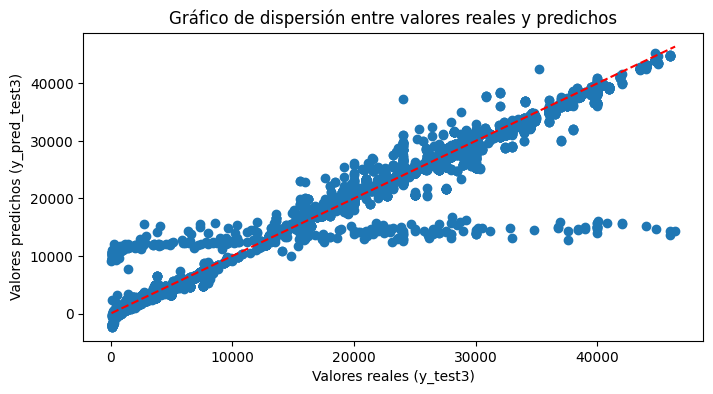

In [198]:
plt.figure(figsize=(8, 4))
plt.scatter(y_test3, y_pred_test3)
plt.xlabel("Valores reales (y_test3)")
plt.ylabel("Valores predichos (y_pred_test3)")
plt.title("Gráfico de dispersión entre valores reales y predichos")

# Agregar la recta identidad
plt.plot([min(y_test3), max(y_test3)], [min(y_test3), max(y_test3)], color='red', linestyle='--')

plt.show()

### Supuestos del modelo lineal

In [199]:
# Calcular los residuos
residuals = y_test3 - y_pred_test3

Text(0, 0.5, 'Residuos')

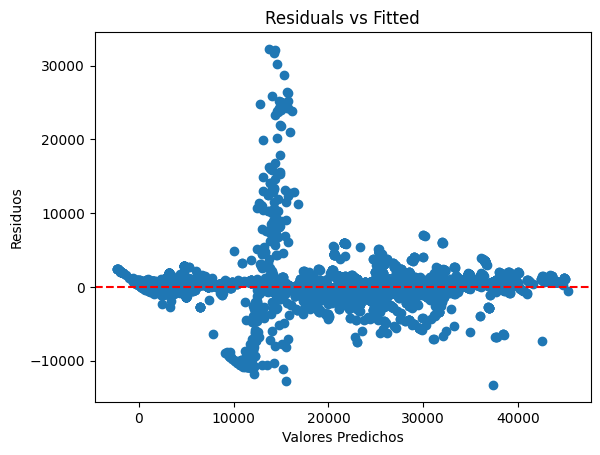

In [200]:
# Supuesto de la linealidad entre predictoras y predicha
# Residuals vs Fitted
plt.scatter(y_pred_test3, residuals)
plt.axhline(0, color='red', linestyle='--')
plt.title('Residuals vs Fitted')
plt.xlabel('Valores Predichos')
plt.ylabel('Residuos')

Text(0.5, 1.0, 'Normal Q-Q')

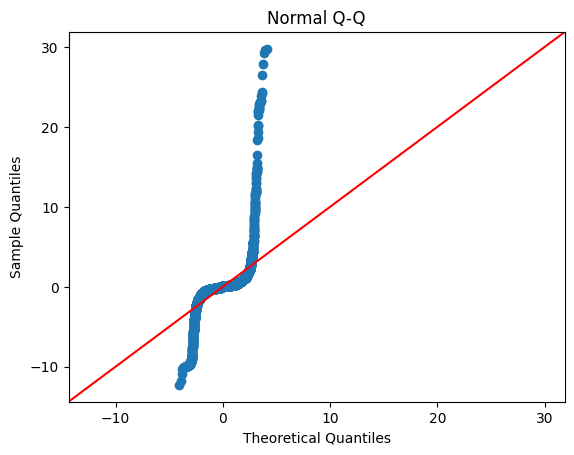

In [201]:
# Supuesto de normalidad
# Normal Q-Q Plot
sm.qqplot(residuals, line='45', fit=True)
plt.title('Normal Q-Q')

In [202]:
# Prueba de Kolmogorov-Smirnov para normalidad de los residuos
ks_stat, p_value = kstest(residuals, 'norm', args=(np.mean(residuals), np.std(residuals)))

print(f'Estadístico de Kolmogorov-Smirnov: {ks_stat}')
print(f'Valor p: {p_value}')

Estadístico de Kolmogorov-Smirnov: 0.26394073962672626
Valor p: 0.0


Text(0, 0.5, 'Sqrt |Residuos Estandarizados|')

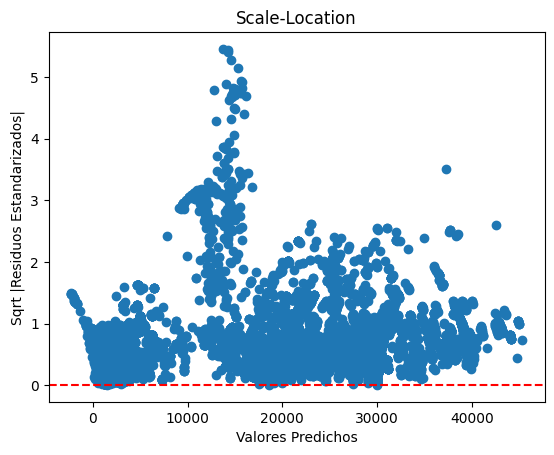

In [203]:
# Supuesto de homocedasticidad
# Scale-Location Plot (residuos estandarizados)
residuals_std = residuals / np.std(residuals)
plt.scatter(y_pred_test3, np.sqrt(np.abs(residuals_std)))
plt.axhline(0, color='red', linestyle='--')
plt.title('Scale-Location')
plt.xlabel('Valores Predichos')
plt.ylabel('Sqrt |Residuos Estandarizados|')

En este modelo al probar la normalidad de los residuos, se obtuvo que estos no siguen una distribución normal. Por lo tanto no se cumple este supesto de la regresión lineal.

## Árbol de Decisión

1. Este modelo considera aquellas variables que no presentaron multicolinealidad en la sección de "Análisis de Correlación de Pearson"
2. Se creó la columna 'Estrato' que divide 'AVALÚO' en 40 estratos.
3. Se hizo la partición 80% train y 20% test considerando la variable 'Estrato'.
4. Se realizó la validación cruzada para la optimización del entrenamiento.
5. Se usó la malla de búsqueda aleatoria RandomSearchCV para la optimización de búsqueda de hiperparámetros donde se probaron 50 combinaciones de los hiperparámetros.

In [1027]:
# Definir las variables predictoras y la variable objetivo
X5 = df2.loc[:,['CILINDRAJE','MARCA_encoded','MODELO_encoded','CLASE_encoded','TIPO COMBUSTIBLE_encoded',
                'PAÍS_encoded','CANTÓN_encoded','COLOR 1_encoded','DIA_DEL_AÑO_encoded','PERSONA NATURAL - JURÍDICA_encoded',
                'TIPO_encoded','EDAD','TIPO SERVICIO_encoded','TIPO TRANSACCIÓN_encoded']]

In [1028]:
y5 = df2['AVALÚO'].values

In [1029]:
df2.loc[:, 'Estrato'] = pd.cut(df2['AVALÚO'], 40, labels=False)

In [1030]:
# Dividir en conjuntos de entrenamiento y prueba
X_train5, X_test5, y_train5, y_test5 = train_test_split(
    X5, y5, test_size=0.2, random_state=42, stratify=df2['Estrato'])

In [1031]:
# Instanciamos el modelo, Se carga el regresor
model_5 = DecisionTreeRegressor(random_state=42)

In [1032]:
# Parámetros para el Decision Tree Regressor
param_distDTR = {
    "max_depth":  [None, 5, 10, 20],  # Máximo número de niveles en el árbol
    "min_samples_split":  [2, 5, 10],  # Mínimo número de muestras requeridas para dividir un nodo
    "min_samples_leaf":  [1, 2, 4],  # Mínimo número de muestras requeridas para estar en un nodo hoja
    "criterion": ["squared_error", "friedman_mse", "absolute_error", "poisson"]  # Función de medida para el split
}

In [1033]:
# Estrategia de remuestreo
cv = RepeatedKFold(n_splits=5, n_repeats=2, random_state=42)
cv

RepeatedKFold(n_repeats=2, n_splits=5, random_state=42)

In [1034]:
metricas = ['neg_mean_squared_error','neg_root_mean_squared_error', 'r2', 'neg_mean_absolute_error', 'neg_mean_absolute_percentage_error']

In [1035]:
modelo_5_tuned = RandomizedSearchCV(estimator=model_5, param_distributions=param_distDTR,
                                       n_iter=50, cv=cv, scoring= metricas, refit= 'neg_mean_squared_error',
                                       n_jobs=-1, random_state=42)

In [1036]:
## Entrenar la malla
modelo_5_tuned.fit(X_train5, y_train5)

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py:528: FitFailedWarning: 
170 fits failed out of a total of 500.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
72 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py", line 866, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py", line 1382, in wrapper
    estimator._validate_params()
  File "c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.

RandomizedSearchCV(cv=RepeatedKFold(n_repeats=2, n_splits=5, random_state=42),
                   estimator=DecisionTreeRegressor(random_state=42), n_iter=50,
                   n_jobs=-1,
                   param_distributions={'criterion': ['squared_error',
                                                      'friedman_mse',
                                                      'absolute_error',
                                                      'poisson'],
                                        'max_depth': [None, 2, 4, 6, 8, 10, 12],
                                        'max_features': ['auto', 'sqrt',
                                                         'log2'],
                                        'min_samples_leaf': [8, 12, 16],
                                        'min_samples_split': [2, 4, 6]},
                   random_state=42, refit='neg_mean_squared_error',
                   scoring=['neg_mean_squared_error',
                            'neg_root_mean_squared_error', 'r2',
                            'neg_mean_absolute_error',
                            'neg_mean_absolute_percentage_error'])

In [1037]:
res_cv= pd.DataFrame(modelo_5_tuned.cv_results_)
res_cv.columns

Index(['mean_fit_time', 'std_fit_time', 'mean_score_time', 'std_score_time',
       'param_min_samples_split', 'param_min_samples_leaf',
       'param_max_features', 'param_max_depth', 'param_criterion', 'params',
       'split0_test_neg_mean_squared_error',
       'split1_test_neg_mean_squared_error',
       'split2_test_neg_mean_squared_error',
       'split3_test_neg_mean_squared_error',
       'split4_test_neg_mean_squared_error',
       'split5_test_neg_mean_squared_error',
       'split6_test_neg_mean_squared_error',
       'split7_test_neg_mean_squared_error',
       'split8_test_neg_mean_squared_error',
       'split9_test_neg_mean_squared_error',
       'mean_test_neg_mean_squared_error', 'std_test_neg_mean_squared_error',
       'rank_test_neg_mean_squared_error',
       'split0_test_neg_root_mean_squared_error',
       'split1_test_neg_root_mean_squared_error',
       'split2_test_neg_root_mean_squared_error',
       'split3_test_neg_root_mean_squared_error',
       'split4_

In [1038]:
cols= res_cv.columns[ res_cv.columns.str.startswith('param_')].to_list() + res_cv.columns[
  res_cv.columns.str.startswith('mean_test') ].to_list()

res_cv_means= res_cv.loc[:, cols ].sort_values(by='mean_test_neg_mean_absolute_error', ascending=False)
res_cv_means

,param_min_samples_split,param_min_samples_leaf,param_max_features,param_max_depth,param_criterion,mean_test_neg_mean_squared_error,mean_test_neg_root_mean_squared_error,mean_test_r2,mean_test_neg_mean_absolute_error,mean_test_neg_mean_absolute_percentage_error
47,4,8,sqrt,None,friedman_mse,-7.421131e+05,-855.191289,0.993869,-186.760372,-0.036228
3,6,16,sqrt,None,poisson,-9.758090e+05,-981.419679,0.991935,-265.065515,-0.058398
29,2,12,sqrt,12,squared_error,-1.101398e+06,-1032.423667,0.990897,-336.933016,-0.070299
49,6,12,log2,12,poisson,-1.116512e+06,-1038.401283,0.990778,-356.057678,-0.070254
44,4,12,sqrt,12,poisson,-1.116512e+06,-1038.401283,0.990778,-356.057678,-0.070254
37,6,16,sqrt,12,poisson,-1.409911e+06,-1164.779429,0.988339,-389.013414,-0.070193
19,2,12,log2,10,absolute_error,-1.843461e+06,-1352.088948,0.984761,-395.158286,-0.080981
46,6,8,log2,10,poisson,-1.149022e+06,-1062.621694,0.990497,-404.017660,-0.084488
15,2,8,sqrt,10,friedman_mse,-1.414112e+06,-1181.866593,0.988310,-453.505996,-0.097965
32,6,8,log2,10,squared_error,-1.414112e+06,-1181.866593,0.988310,-453.505996,-0.097965


In [1039]:
# Mejor combinación
print('Mejor combinacion de Hiperparámetros: %s' % modelo_5_tuned.best_params_)

Mejor combinacion de Hiperparámetros: {'min_samples_split': 4, 'min_samples_leaf': 8, 'max_features': 'sqrt', 'max_depth': None, 'criterion': 'friedman_mse'}


In [1040]:
# Mejores estimadores
modelo_5_tuned.best_estimator_

DecisionTreeRegressor(criterion='friedman_mse', max_features='sqrt',
                      min_samples_leaf=8, min_samples_split=4, random_state=42)

In [1041]:
# Mejor modelo
modelo_5_fitted= modelo_5_tuned.best_estimator_

In [1042]:
# Predecir los valores de la variable objetivo en el conjunto de prueba
y_pred_test5 = modelo_5_fitted.predict(X_test5)
y_pred_test5

array([ 1762.06315789,  1896.09066852, 20124.47311828, ...,
         992.60817568,   880.        ,  1081.49      ])

In [1043]:
# Se muestran en un dataframe los vectores y_test_5_valores, y_pred_test_5

# Crear un DataFrame con los valores de y_test_5_valores e y_pred_test_5
df_results_5 = pd.DataFrame({'y_test_5_valores': y_test5, 'y_pred_test_5': y_pred_test5})

# Mostrar el DataFrame
print(df_results_5)

       y_test_5_valores  y_pred_test_5
0               1760.00    1762.063158
1               1899.00    1896.090669
2              19990.00   20124.473118
3               1163.55    1163.550000
4               1814.76    1807.911887
...                 ...            ...
47181           1900.00    1900.000000
47182          21990.00   21510.000000
47183            996.00     992.608176
47184            880.00     880.000000
47185           1081.49    1081.490000

[47186 rows x 2 columns]


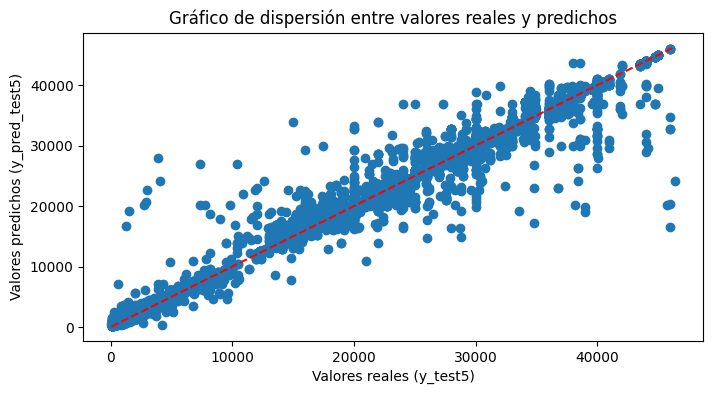

In [1044]:
# Gráfico de dispersión entre y_test5 e y_pred_test5 agregando la recta identidad
plt.figure(figsize=(8, 4))
plt.scatter(y_test5, y_pred_test5)
plt.xlabel("Valores reales (y_test5)")
plt.ylabel("Valores predichos (y_pred_test5)")
plt.title("Gráfico de dispersión entre valores reales y predichos")

# Agregar la recta identidad
plt.plot([min(y_test5), max(y_test5)], [min(y_test5), max(y_test5)], color='red', linestyle='--')

plt.show()

In [1045]:
df_arbol = df2.loc[:,[
   'CILINDRAJE','MARCA_encoded','MODELO_encoded','CLASE_encoded','TIPO COMBUSTIBLE_encoded',
                'PAÍS_encoded','CANTÓN_encoded','COLOR 1_encoded','DIA_DEL_AÑO_encoded','PERSONA NATURAL - JURÍDICA_encoded',
                'TIPO_encoded','EDAD','TIPO SERVICIO_encoded','TIPO TRANSACCIÓN_encoded'
]].copy()

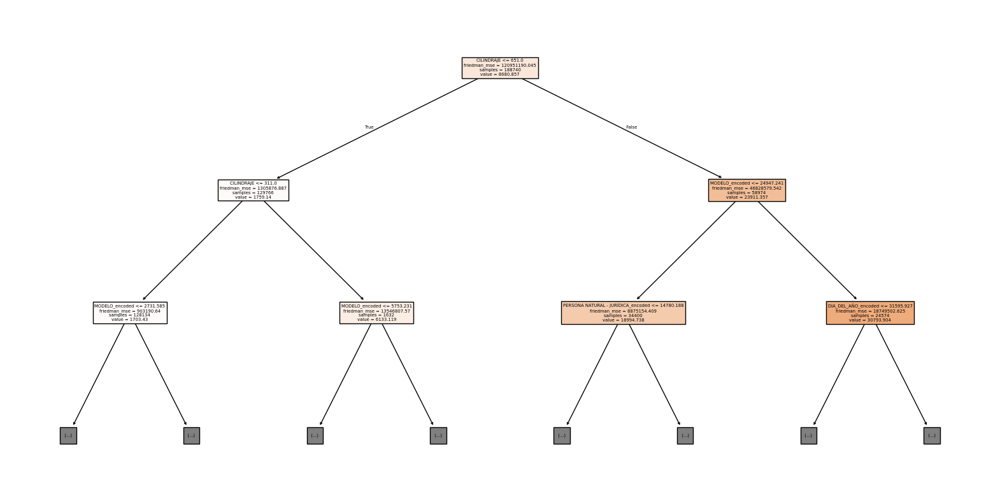

In [1046]:
# Gráfico del arbol con una profundidad de 2
plt.figure(figsize=(20, 10))
plot_tree(modelo_5_fitted, max_depth=2, feature_names=df_arbol.columns, filled=True)
plt.show()

In [1047]:
# Obtener la importancia de las características
importancia_caracteristicas = modelo_5_fitted.feature_importances_

# Imprimir la importancia de las características
print("Importancia de las características:")
for i, importancia in enumerate(importancia_caracteristicas):
    print(f"{df_arbol.columns[i]}: {importancia:.3f}")

Importancia de las características:
CILINDRAJE: 0.880
MARCA_encoded: 0.004
MODELO_encoded: 0.109
CLASE_encoded: 0.000
TIPO COMBUSTIBLE_encoded: 0.001
PAÍS_encoded: 0.002
CANTÓN_encoded: 0.000
COLOR 1_encoded: 0.000
DIA_DEL_AÑO_encoded: 0.001
PERSONA NATURAL - JURÍDICA_encoded: 0.000
TIPO_encoded: 0.000
EDAD: 0.001
TIPO SERVICIO_encoded: 0.000
TIPO TRANSACCIÓN_encoded: 0.000


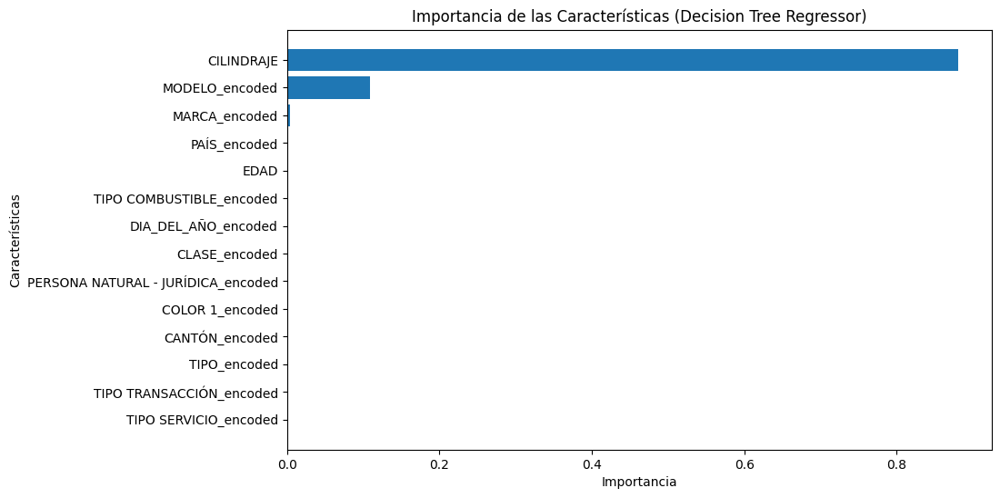

In [1048]:
# Obtener la importancia de las características del mejor modelo de Random Forest
importances = modelo_5_fitted.feature_importances_

# Crear un DataFrame con las características y su importancia
feature_importances = pd.DataFrame({'feature': df_arbol.columns, 'importance': importances})

# Ordenar el DataFrame por importancia de mayor a menor
feature_importances = feature_importances.sort_values('importance', ascending=True)

# Graficar la importancia de las características en un diagrama de barras horizontal
plt.figure(figsize=(10, 6))
plt.barh(feature_importances['feature'], feature_importances['importance'])
plt.xlabel('Importancia')
plt.ylabel('Características')
plt.title('Importancia de las Características (Decision Tree Regressor)')
plt.show()

## Random Forest

In [56]:
# Definir las variables predictoras y la variable objetivo
X6 = df2.loc[:,['CILINDRAJE','MARCA_encoded','MODELO_encoded','CLASE_encoded',
                'TIPO COMBUSTIBLE_encoded','PAÍS_encoded','CANTÓN_encoded','COLOR 1_encoded',
                'DIA_DEL_AÑO_encoded','PERSONA NATURAL - JURÍDICA_encoded',
                'TIPO_encoded','EDAD','TIPO SERVICIO_encoded','TIPO TRANSACCIÓN_encoded']]

In [57]:
y6 = df2['AVALÚO'].values

In [58]:
df2.loc[:, 'Estrato'] = pd.cut(df2['AVALÚO'], 40, labels=False)

In [59]:
# Dividir en conjuntos de entrenamiento y prueba
X_train6, X_test6, y_train6, y_test6 = train_test_split(
    X6, y6, test_size=0.2, random_state=42, stratify=df2['Estrato'])

In [210]:
# Instanciamos el modelo, Se carga el regresor
modelo_6 = RandomForestRegressor(random_state=42)
modelo_6

RandomForestRegressor(random_state=42)

In [211]:
# Parámetros para el Random Forest
param_distDTR = {
    'n_estimators': [16, 32, 64, 128],  # Número de árboles en el bosque
    'max_depth': [None, 10, 20, 30],  # Profundidad máxima de los árboles
    'min_samples_split': [2, 5, 10],  # Número mínimo de muestras requeridas para dividir un nodo
    'min_samples_leaf': [1, 2, 4],  # Número mínimo de muestras por hoja
}

In [212]:
# Estrategia de remuestreo
cv = RepeatedKFold(n_splits=5, n_repeats=2, random_state=42)
cv

RepeatedKFold(n_repeats=2, n_splits=5, random_state=42)

In [213]:
metricas = ['neg_mean_squared_error','neg_root_mean_squared_error', 'r2', 'neg_mean_absolute_error', 'neg_mean_absolute_percentage_error']

In [214]:
modelo_6_tuned = RandomizedSearchCV(estimator=modelo_6, param_distributions=param_distDTR, cv=cv, scoring=metricas,
                              refit='neg_mean_squared_error', n_jobs=-1, verbose=2, random_state=42, n_iter=50)

In [215]:
## Entrenar la malla
modelo_6_tuned.fit(X_train6,  y_train6)

Fitting 10 folds for each of 50 candidates, totalling 500 fits


RandomizedSearchCV(cv=RepeatedKFold(n_repeats=2, n_splits=5, random_state=42),
                   estimator=RandomForestRegressor(random_state=42), n_iter=50,
                   n_jobs=-1,
                   param_distributions={'max_depth': [None, 10, 20, 30],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [16, 32, 64, 128]},
                   random_state=42, refit='neg_mean_squared_error',
                   scoring=['neg_mean_squared_error',
                            'neg_root_mean_squared_error', 'r2',
                            'neg_mean_absolute_error',
                            'neg_mean_absolute_percentage_error'],
                   verbose=2)

In [216]:
res_cv= pd.DataFrame(modelo_6_tuned.cv_results_)
res_cv.columns

Index(['mean_fit_time', 'std_fit_time', 'mean_score_time', 'std_score_time',
       'param_n_estimators', 'param_min_samples_split',
       'param_min_samples_leaf', 'param_max_depth', 'params',
       'split0_test_neg_mean_squared_error',
       'split1_test_neg_mean_squared_error',
       'split2_test_neg_mean_squared_error',
       'split3_test_neg_mean_squared_error',
       'split4_test_neg_mean_squared_error',
       'split5_test_neg_mean_squared_error',
       'split6_test_neg_mean_squared_error',
       'split7_test_neg_mean_squared_error',
       'split8_test_neg_mean_squared_error',
       'split9_test_neg_mean_squared_error',
       'mean_test_neg_mean_squared_error', 'std_test_neg_mean_squared_error',
       'rank_test_neg_mean_squared_error',
       'split0_test_neg_root_mean_squared_error',
       'split1_test_neg_root_mean_squared_error',
       'split2_test_neg_root_mean_squared_error',
       'split3_test_neg_root_mean_squared_error',
       'split4_test_neg_root_mean_

In [217]:
cols= res_cv.columns[ res_cv.columns.str.startswith('param_')].to_list() + res_cv.columns[
  res_cv.columns.str.startswith('mean_test') ].to_list()

res_cv_means= res_cv.loc[:, cols ].sort_values(by='mean_test_neg_mean_squared_error', ascending=False)
res_cv_means

,param_n_estimators,param_min_samples_split,param_min_samples_leaf,param_max_depth,mean_test_neg_mean_squared_error,mean_test_neg_root_mean_squared_error,mean_test_r2,mean_test_neg_mean_absolute_error,mean_test_neg_mean_absolute_percentage_error
36,128,2,1,30,-149526.766632,-385.482137,0.998769,-27.126013,-0.004850
22,64,2,1,30,-152640.018206,-389.340080,0.998743,-27.367213,-0.004863
39,128,5,2,30,-155228.181022,-392.413700,0.998722,-30.761869,-0.005402
11,64,5,1,20,-155233.594238,-392.594341,0.998722,-28.393727,-0.005024
1,128,5,2,None,-155264.394114,-392.471795,0.998722,-30.769633,-0.005402
19,32,2,1,20,-156933.157734,-395.032766,0.998708,-27.765885,-0.004887
23,32,5,1,30,-157463.178366,-395.576683,0.998704,-28.556424,-0.005012
46,64,2,2,20,-157856.119940,-395.710240,0.998700,-30.848616,-0.005388
42,16,2,1,None,-158691.332749,-397.349026,0.998693,-27.969975,-0.004899
9,64,5,2,None,-158860.331803,-396.853414,0.998692,-31.058573,-0.005419


In [218]:
# Mejor combinación
print('Mejor combinacion de Hiperparámetros: %s' % modelo_6_tuned.best_params_)

Mejor combinacion de Hiperparámetros: {'n_estimators': 128, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': 30}


In [219]:
# Mejores estimadores
modelo_6_tuned.best_estimator_

RandomForestRegressor(max_depth=30, n_estimators=128, random_state=42)

In [220]:
# Mejor modelo
modelo_6_fitted= modelo_6_tuned.best_estimator_

In [221]:
# Predecir los valores de la variable objetivo en el conjunto de prueba
y_pred_test6 = modelo_6_fitted.predict(X_test6)
y_pred_test6

array([ 1300.  ,  1124.2 , 19990.  , ...,  1600.  ,  1544.07,  4770.  ])

In [222]:
# Se muestran en un dataframe los vectores y_test_6_valores, y_pred_test_6

# Crear un DataFrame con los valores de y_test_6_valores e y_pred_test_6
df_results_test6 = pd.DataFrame({'y_test_6_valores': y_test6, 'y_pred_test_6': y_pred_test6})

# Mostrar el DataFrame
print(df_results_test6)

       y_test_6_valores  y_pred_test_6
0               1300.00        1300.00
1               1124.20        1124.20
2              19990.00       19990.00
3               1475.00        1475.00
4               1519.63        1519.63
...                 ...            ...
46865           2999.00        2999.00
46866           1899.00        1899.00
46867           1600.00        1600.00
46868           1544.07        1544.07
46869           4770.00        4770.00

[46870 rows x 2 columns]


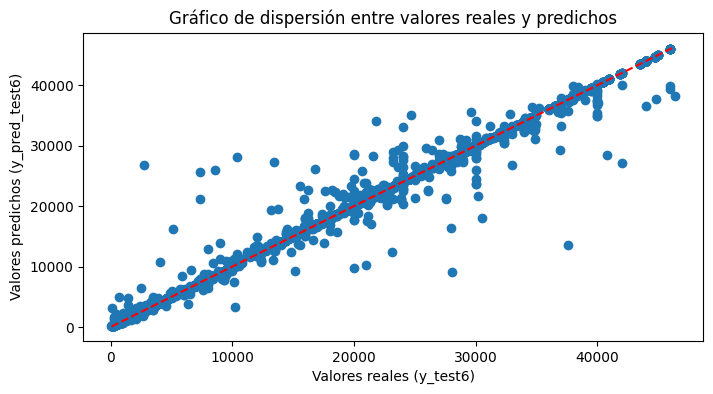

In [223]:
plt.figure(figsize=(8, 4))
plt.scatter(y_test6, y_pred_test6)
plt.xlabel("Valores reales (y_test6)")
plt.ylabel("Valores predichos (y_pred_test6)")
plt.title("Gráfico de dispersión entre valores reales y predichos")

# Agregar la recta identidad
plt.plot([min(y_test6), max(y_test6)], [min(y_test6), max(y_test6)], color='red', linestyle='--')

plt.show()

In [224]:
df_arbol = df2.loc[:,[
   'CILINDRAJE','MARCA_encoded','MODELO_encoded','CLASE_encoded','TIPO COMBUSTIBLE_encoded',
                'PAÍS_encoded','CANTÓN_encoded','COLOR 1_encoded','DIA_DEL_AÑO_encoded','PERSONA NATURAL - JURÍDICA_encoded',
                'TIPO_encoded','EDAD','TIPO SERVICIO_encoded','TIPO TRANSACCIÓN_encoded'
]].copy()

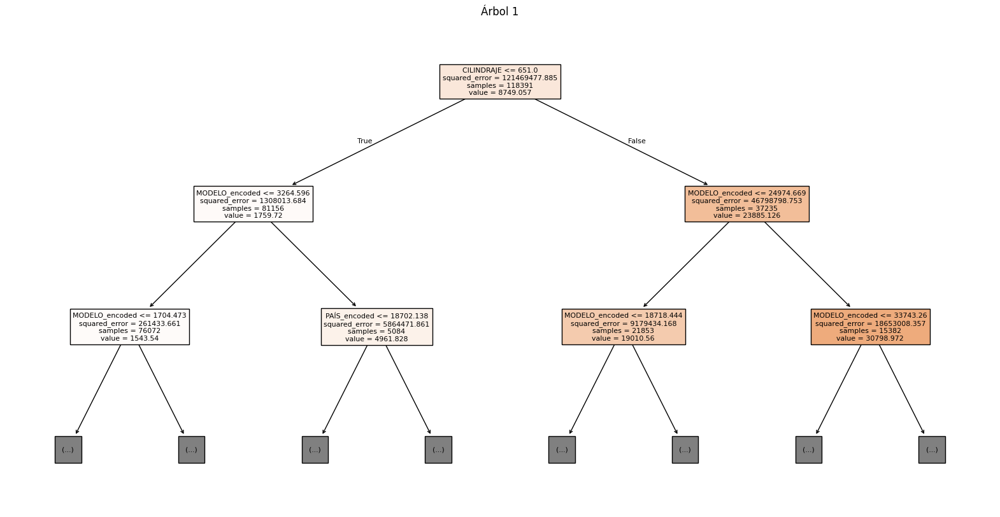

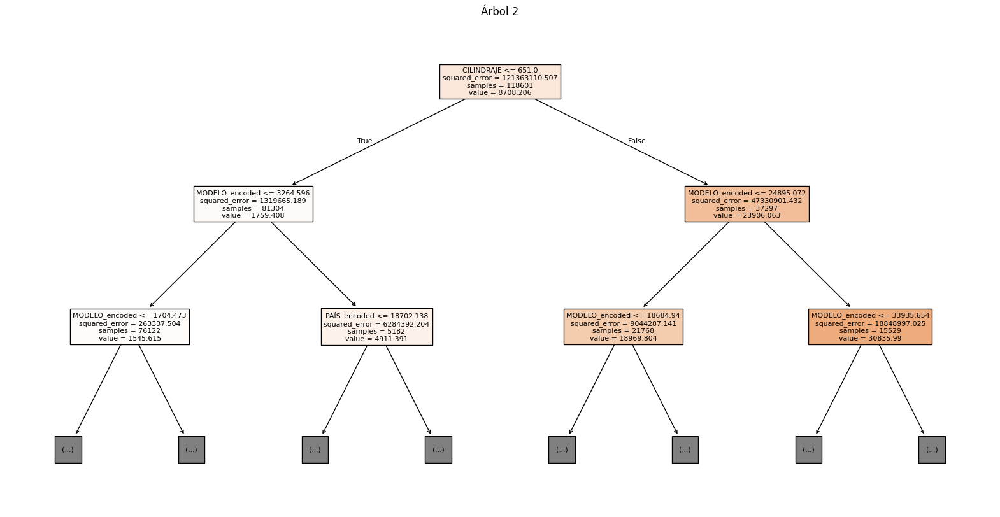

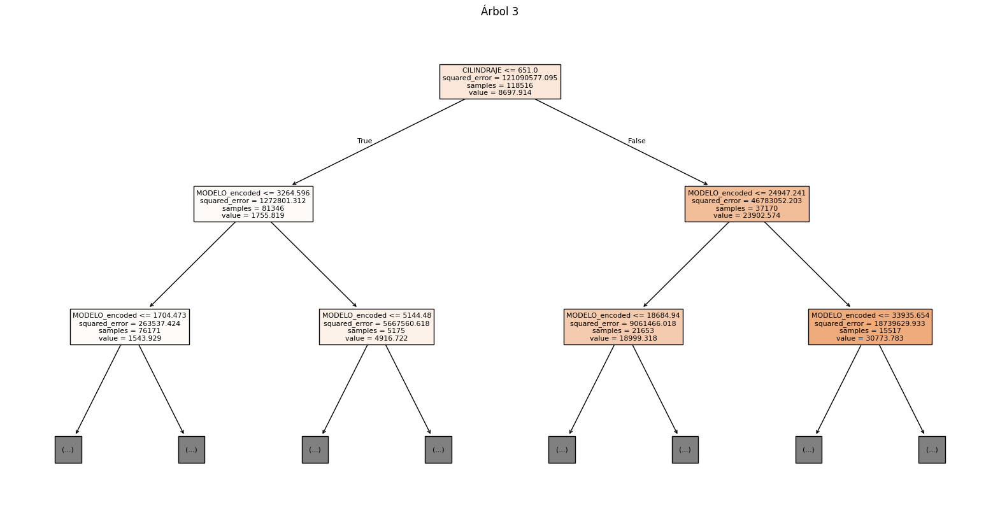

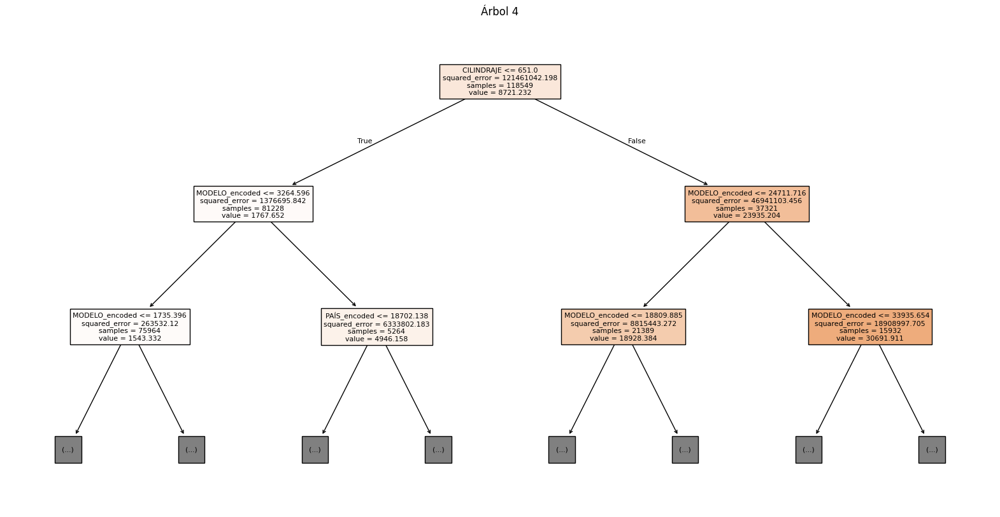

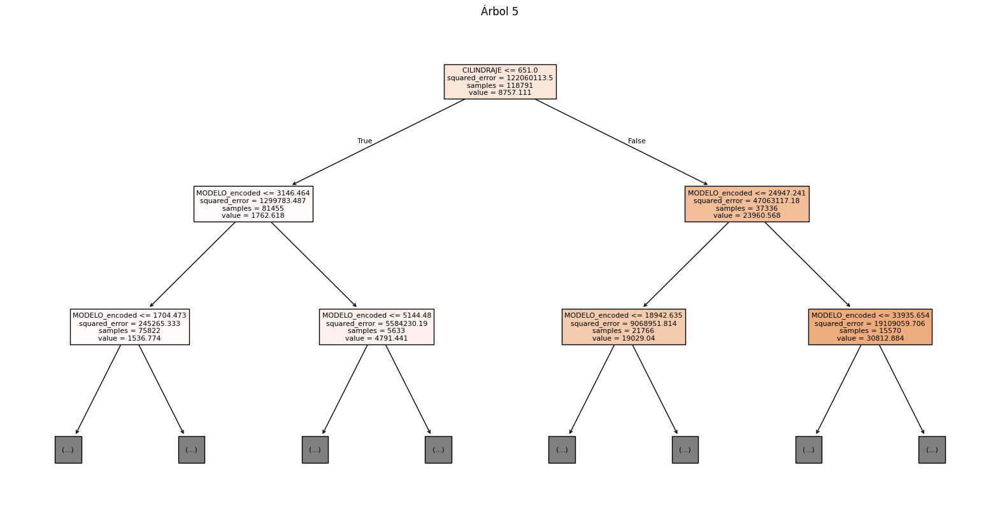

...

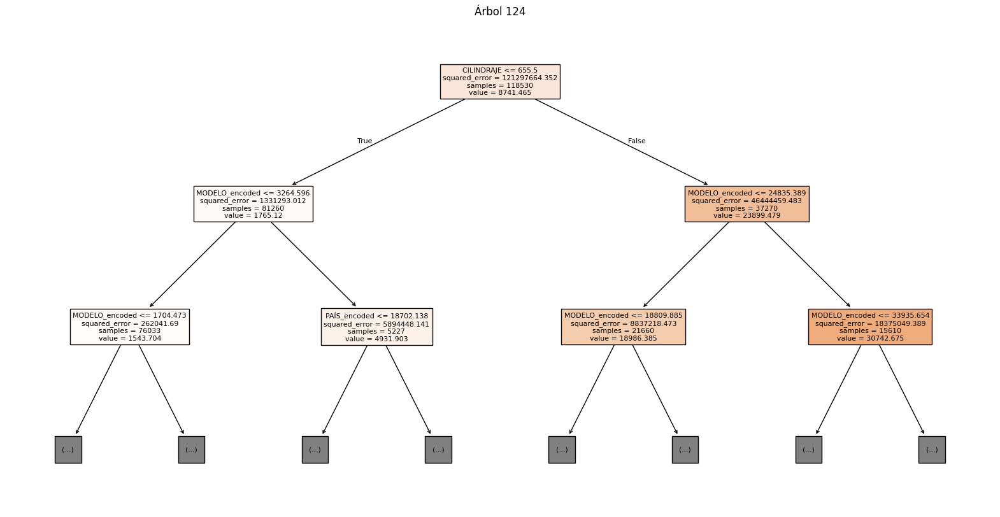

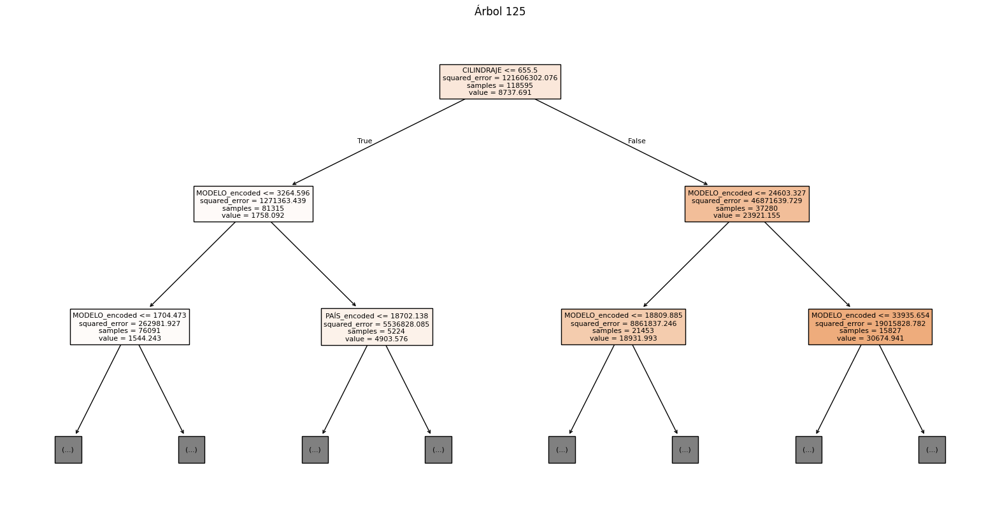

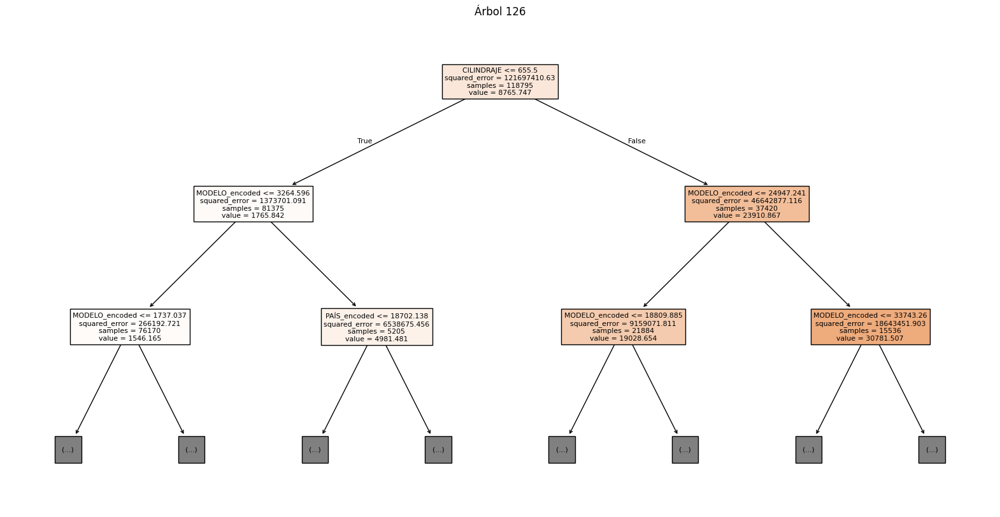

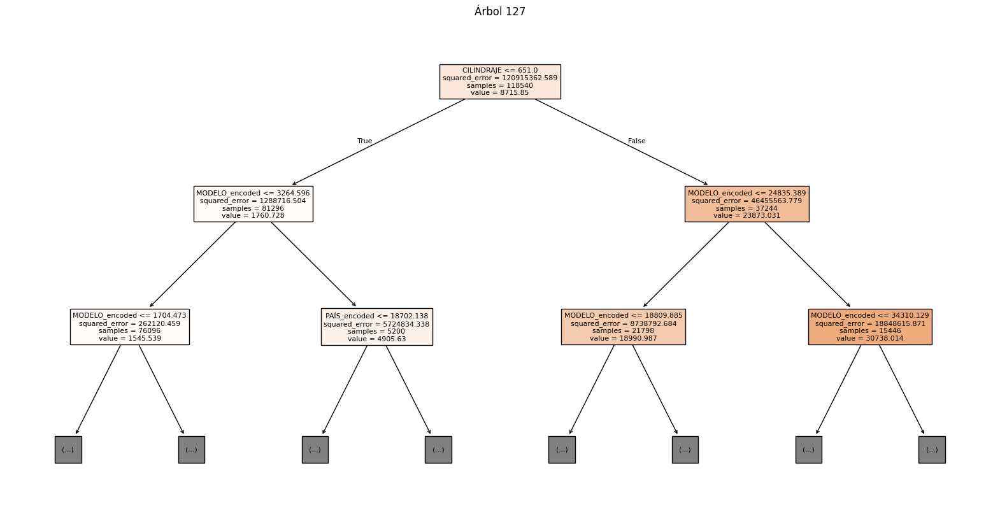

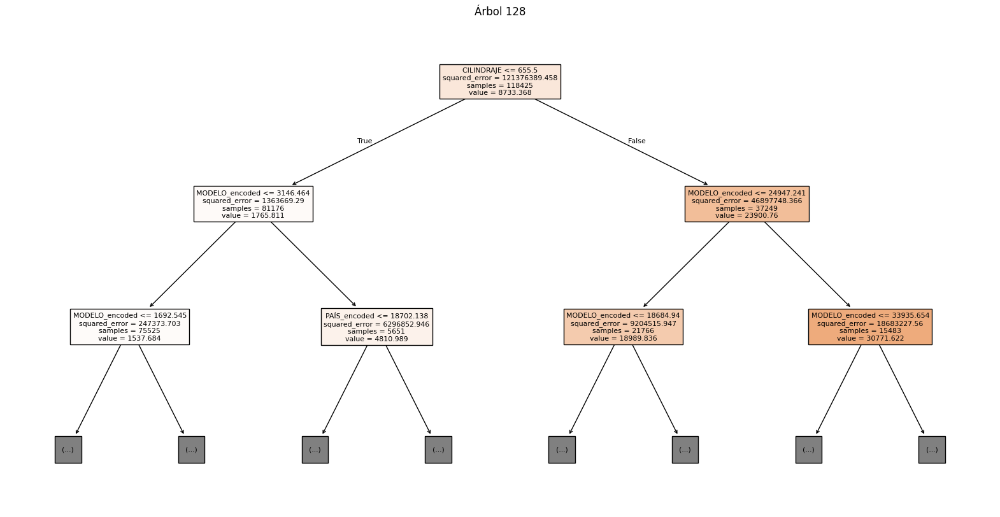

In [225]:
# Obtener los primeros 4 árboles del modelo RandomForest
for i in range(modelo_6_fitted.n_estimators):
  tree = modelo_6_fitted.estimators_[i]

  # Graficar el árbol
  plt.figure(figsize=(20, 10))
  plot_tree(tree, max_depth=2, feature_names=df_arbol.columns, filled=True)
  plt.title(f"Árbol {i+1}")
  plt.show()

In [226]:
# Obtener la importancia de las características
importancia_caracteristicas = modelo_6_fitted.feature_importances_

# Imprimir la importancia de las características
print("Importancia de las características:")
for i, importancia in enumerate(importancia_caracteristicas):
    print(f"{df_arbol.columns[i]}: {importancia:.4f}")

Importancia de las características:
CILINDRAJE: 0.8723
MARCA_encoded: 0.0008
MODELO_encoded: 0.1223
CLASE_encoded: 0.0003
TIPO COMBUSTIBLE_encoded: 0.0001
PAÍS_encoded: 0.0012
CANTÓN_encoded: 0.0001
COLOR 1_encoded: 0.0001
DIA_DEL_AÑO_encoded: 0.0003
PERSONA NATURAL - JURÍDICA_encoded: 0.0000
TIPO_encoded: 0.0000
EDAD: 0.0023
TIPO SERVICIO_encoded: 0.0000
TIPO TRANSACCIÓN_encoded: 0.0000


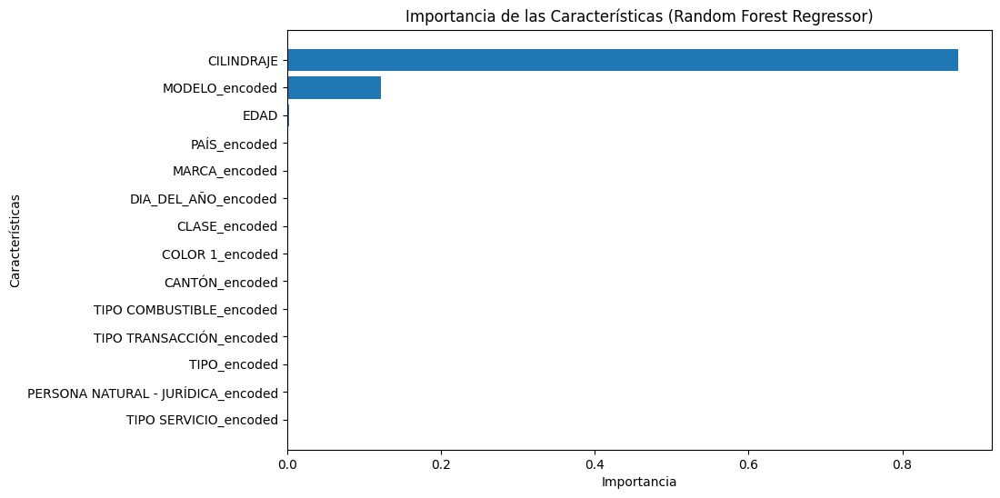

In [227]:
# Obtener la importancia de las características del mejor modelo de Random Forest
importances = modelo_6_fitted.feature_importances_

# Crear un DataFrame con las características y su importancia
feature_importances = pd.DataFrame({'feature': df_arbol.columns, 'importance': importances})

# Ordenar el DataFrame por importancia de mayor a menor
feature_importances = feature_importances.sort_values('importance', ascending=True)

# Graficar la importancia de las características en un diagrama de barras horizontal
plt.figure(figsize=(10, 6))
plt.barh(feature_importances['feature'], feature_importances['importance'])
plt.xlabel('Importancia')
plt.ylabel('Características')
plt.title('Importancia de las Características (Random Forest Regressor)')
plt.show()

## Red Perceptrón Multicapa (MLP)

In [56]:
SEED = 42
random.seed(SEED)
np.random.seed(SEED)
tf.random.set_seed(SEED)

In [57]:
X7 = df2.loc[:,['CILINDRAJE','MARCA_encoded','MODELO_encoded','CLASE_encoded',
                'TIPO COMBUSTIBLE_encoded','PAÍS_encoded','CANTÓN_encoded','COLOR 1_encoded',
                'DIA_DEL_AÑO_encoded','PERSONA NATURAL - JURÍDICA_encoded',
                'TIPO_encoded','EDAD','TIPO SERVICIO_encoded','TIPO TRANSACCIÓN_encoded']]

In [58]:
y7 = df2['AVALÚO'].values

In [59]:
df2.loc[:, 'Estrato'] = pd.cut(df2['AVALÚO'], 40, labels=False)

In [60]:
X_train7, X_test7, y_train7, y_test7 = train_test_split(
    X7, y7, test_size=0.2, random_state=42,
    stratify=df2['Estrato']
)

In [61]:
# Escalamiento de los datos
scaler = StandardScaler()
X_train7_scaled = scaler.fit_transform(X_train7)
X_test7_scaled = scaler.transform(X_test7)

In [75]:
# Definir la función para crear el modelo
def create_model(hidden_layer_sizes=(512, 512), learning_rate=0.001, l1_rate=0.1, l2_rate=0.1):
    model = Sequential()
    model.add(Dense(hidden_layer_sizes[0], activation='relu', input_shape=(X_train7_scaled.shape[1],), kernel_regularizer=l1_l2(l1=l1_rate, l2=l2_rate)))
    model.add(Dense(hidden_layer_sizes[1], activation='relu', kernel_regularizer=l1_l2(l1=l1_rate, l2=l2_rate)))
    model.add(Dense(1))  # Capa de salida para regresión

    model.compile(optimizer=Adam(learning_rate=learning_rate),
                  loss='mse',
                  metrics=['mae', tf.keras.metrics.RootMeanSquaredError(name='rmse')])
    return model

In [76]:
# Bucle manual para ajuste de hiperparámetros
hidden_layer_sizes_list = [(512, 512)]
learning_rates = [0.001, 0.01]
batch_sizes = [128, 256]
epochs_list = [100, 200]

In [77]:
best_mse = float('inf')
best_params = {}

In [78]:
for hidden_layer_sizes in hidden_layer_sizes_list:
    for learning_rate in learning_rates:
        for batch_size in batch_sizes:
            for epochs in epochs_list:
                print(f"Entrenando con hidden_layer_sizes={hidden_layer_sizes}, learning_rate={learning_rate}, batch_size={batch_size}, epochs={epochs}")

                model = create_model(hidden_layer_sizes=hidden_layer_sizes, learning_rate=learning_rate)

                # EarlyStopping para evitar sobreajuste
                early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

                history = model.fit(
                    X_train7_scaled, y_train7,
                    validation_split=0.2,
                    epochs=epochs,
                    batch_size=batch_size,
                    callbacks=[early_stopping],
                    verbose=1,
                )

                # Evaluación en el conjunto de prueba
                y_pred_test7 = model.predict(X_test7_scaled).flatten()
                mse = mean_squared_error(y_test7, y_pred_test7)

                print(f"MSE: {mse}")

                # Guardar el mejor modelo
                if mse < best_mse:
                    best_mse = mse
                    best_params = {
                        'hidden_layer_sizes': hidden_layer_sizes,
                        'learning_rate': learning_rate,
                        'batch_size': batch_size,
                        'epochs': epochs
                    }
                    best_model = model

Entrenando con hidden_layer_sizes=(512, 512), learning_rate=0.001, batch_size=128, epochs=100
Epoch 1/100


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 66514408.0000 - mae: 3967.8875 - rmse: 7636.1543 - val_loss: 2654763.5000 - val_mae: 928.2861 - val_rmse: 1627.5195
Epoch 2/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 2009882.5000 - mae: 727.4084 - rmse: 1407.4192 - val_loss: 1147735.3750 - val_mae: 373.9663 - val_rmse: 1067.5306
Epoch 3/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 1145904.8750 - mae: 356.2367 - rmse: 1064.6401 - val_loss: 1065504.1250 - val_mae: 330.9134 - val_rmse: 1028.1832
Epoch 4/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 1071458.0000 - mae: 328.2719 - rmse: 1029.1409 - val_loss: 996116.6250 - val_mae: 308.3780 - val_rmse: 993.7368
Epoch 5/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 997971.6875 - mae: 307.8203 - rmse: 992.6358 - val_loss: 893584.1250 - val_mae: 272.8059 - val_rmse: 940.5323
Epoch 6/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 903095.1250 - mae: 274.6939 - rmse: 943.5324 - val_loss: 830994.3125

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 66875932.0000 - mae: 3987.8647 - rmse: 7659.0010 - val_loss: 2645542.0000 - val_mae: 926.9859 - val_rmse: 1624.7135
Epoch 2/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 2014709.3750 - mae: 730.0297 - rmse: 1409.2660 - val_loss: 1137054.2500 - val_mae: 365.6106 - val_rmse: 1062.5153
Epoch 3/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 1134587.6250 - mae: 348.4307 - rmse: 1059.2780 - val_loss: 1048474.8750 - val_mae: 320.6317 - val_rmse: 1019.8789
Epoch 4/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 1053796.1250 - mae: 319.2383 - rmse: 1020.3928 - val_loss: 951547.3125 - val_mae: 291.1840 - val_rmse: 971.0470
Epoch 5/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 955556.5625 - mae: 289.0615 - rmse: 970.9328 - val_loss: 866658.5000 - val_mae: 261.4757 - val_rmse: 926.1556
Epoch 6/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 884593.6875 - mae: 266.0330 - rmse: 933.8331 - val_loss: 822313.1875

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 99744112.0000 - mae: 5344.3169 - rmse: 9623.2949 - val_loss: 4732789.5000 - val_mae: 1245.8989 - val_rmse: 2174.3628
Epoch 2/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4142855.5000 - mae: 1173.0725 - rmse: 2031.0513 - val_loss: 2437908.7500 - val_mae: 892.4288 - val_rmse: 1559.3727
Epoch 3/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 2077033.5000 - mae: 778.1932 - rmse: 1434.4922 - val_loss: 1227944.1250 - val_mae: 440.9762 - val_rmse: 1104.2120
Epoch 4/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 1184403.3750 - mae: 393.4460 - rmse: 1081.9088 - val_loss: 1010068.3125 - val_mae: 308.4180 - val_rmse: 1000.4755
Epoch 5/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 1023901.7500 - mae: 297.5522 - rmse: 1005.3036 - val_loss: 948559.6250 - val_mae: 271.6942 - val_rmse: 969.1746
Epoch 6/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 966729.6250 - mae: 271.0160 - rmse: 976.5175 - val_loss: 911109.6875 - val

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 99825336.0000 - mae: 5360.2373 - rmse: 9627.7227 - val_loss: 4739580.0000 - val_mae: 1247.3442 - val_rmse: 2175.9280
Epoch 2/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4147769.7500 - mae: 1172.8691 - rmse: 2032.2543 - val_loss: 2436299.7500 - val_mae: 885.2009 - val_rmse: 1558.8427
Epoch 3/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 2070415.0000 - mae: 766.0628 - rmse: 1432.1841 - val_loss: 1252789.3750 - val_mae: 445.8805 - val_rmse: 1115.5162
Epoch 4/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 1227387.1250 - mae: 408.6068 - rmse: 1101.9746 - val_loss: 1107299.8750 - val_mae: 344.8691 - val_rmse: 1048.1324
Epoch 5/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 1115986.3750 - mae: 336.4757 - rmse: 1050.4257 - val_loss: 1060744.8750 - val_mae: 324.2782 - val_rmse: 1025.6068
Epoch 6/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 1055804.7500 - mae: 314.0738 - rmse: 1021.2294 - val_loss: 982554.1250 -

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 19112166.0000 - mae: 1536.3126 - rmse: 3759.1516 - val_loss: 963317.0625 - val_mae: 377.3238 - val_rmse: 976.9863
Epoch 2/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 936193.3750 - mae: 322.8148 - rmse: 961.0563 - val_loss: 799424.4375 - val_mae: 288.1951 - val_rmse: 888.5181
Epoch 3/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 834891.1250 - mae: 303.5133 - rmse: 906.8148 - val_loss: 718694.8125 - val_mae: 294.9571 - val_rmse: 841.6112
Epoch 4/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 756236.3125 - mae: 303.1212 - rmse: 862.4117 - val_loss: 617031.7500 - val_mae: 227.7954 - val_rmse: 778.7487
Epoch 5/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 698660.6875 - mae: 303.9338 - rmse: 828.3163 - val_loss: 575878.0625 - val_mae: 230.2503 - val_rmse: 751.6882
Epoch 6/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 653053.8125 - mae: 302.4880 - rmse: 800.1849 - val_loss: 543187.7500 - val_mae: 

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 19452482.0000 - mae: 1521.2743 - rmse: 3790.0010 - val_loss: 951343.9375 - val_mae: 362.7788 - val_rmse: 970.8400
Epoch 2/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 917503.6250 - mae: 317.8985 - rmse: 951.4257 - val_loss: 749259.6875 - val_mae: 256.6844 - val_rmse: 859.9854
Epoch 3/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 825666.6875 - mae: 306.2971 - rmse: 901.8256 - val_loss: 717613.1250 - val_mae: 324.3694 - val_rmse: 841.2470
Epoch 4/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 754588.9375 - mae: 300.1194 - rmse: 861.8054 - val_loss: 623230.4375 - val_mae: 274.3868 - val_rmse: 783.0099
Epoch 5/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 691750.7500 - mae: 298.6212 - rmse: 824.5420 - val_loss: 556690.0000 - val_mae: 237.6763 - val_rmse: 739.1700
Epoch 6/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 635930.2500 - mae: 295.5901 - rmse: 790.0534 - val_loss: 522550.2188 - val_mae: 

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 31721368.0000 - mae: 2229.3423 - rmse: 5003.9556 - val_loss: 992767.5000 - val_mae: 329.2602 - val_rmse: 991.8426
Epoch 2/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 984096.1250 - mae: 316.5933 - rmse: 985.3809 - val_loss: 881484.2500 - val_mae: 294.3262 - val_rmse: 933.4746
Epoch 3/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 903946.2500 - mae: 296.2235 - rmse: 943.5175 - val_loss: 845764.5000 - val_mae: 309.8029 - val_rmse: 913.7687
Epoch 4/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 857564.8125 - mae: 299.9659 - rmse: 918.1547 - val_loss: 770149.1250 - val_mae: 279.9388 - val_rmse: 871.0659
Epoch 5/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 785958.8125 - mae: 284.2342 - rmse: 878.4158 - val_loss: 737981.3750 - val_mae: 326.3767 - val_rmse: 852.3232
Epoch 6/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 727143.9375 - mae: 283.3629 - rmse: 844.5033 - val_loss: 696702.7500 - val_mae: 354.1958 - v

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 31262132.0000 - mae: 2214.6956 - rmse: 4964.3262 - val_loss: 1016900.1250 - val_mae: 360.6350 - val_rmse: 1004.4100
Epoch 2/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 1012568.4375 - mae: 337.7257 - rmse: 999.8642 - val_loss: 847024.1875 - val_mae: 286.4090 - val_rmse: 915.4221
Epoch 3/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 883572.1875 - mae: 304.6030 - rmse: 933.2453 - val_loss: 784041.1875 - val_mae: 276.5395 - val_rmse: 879.9967
Epoch 4/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 825209.1875 - mae: 293.9626 - rmse: 901.1976 - val_loss: 724662.1875 - val_mae: 260.7037 - val_rmse: 845.3662
Epoch 5/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 766984.0625 - mae: 276.9168 - rmse: 868.2645 - val_loss: 680174.8750 - val_mae: 249.0565 - val_rmse: 818.5434
Epoch 6/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 728976.0000 - mae: 274.4355 - rmse: 846.1464 - val_loss: 727698.6250 - val_mae: 367.7512 

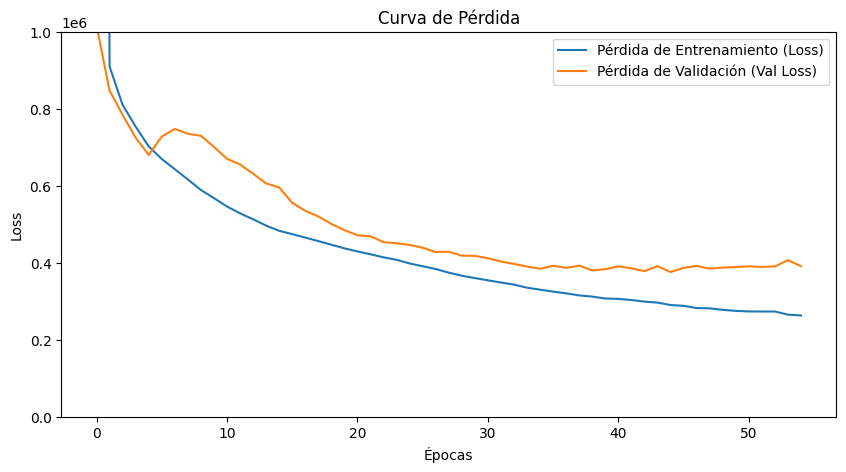

In [79]:
# Graficar la pérdida (Loss)
plt.figure(figsize=(10, 5))
plt.plot(history.history['loss'], label='Pérdida de Entrenamiento (Loss)')
plt.plot(history.history['val_loss'], label='Pérdida de Validación (Val Loss)')
plt.title('Curva de Pérdida')
plt.xlabel('Épocas')
plt.ylabel('Loss')
plt.ylim(0, 1000000)
plt.legend()
plt.show()

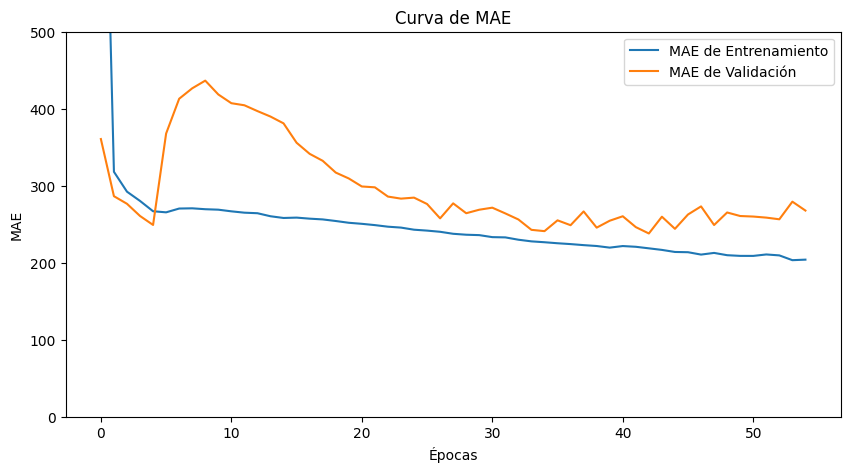

In [80]:
# Graficar el MAE
plt.figure(figsize=(10, 5))
plt.plot(history.history['mae'], label='MAE de Entrenamiento')
plt.plot(history.history['val_mae'], label='MAE de Validación')
plt.title('Curva de MAE')
plt.xlabel('Épocas')
plt.ylabel('MAE')
plt.ylim(0, 500)
plt.legend()
plt.show()

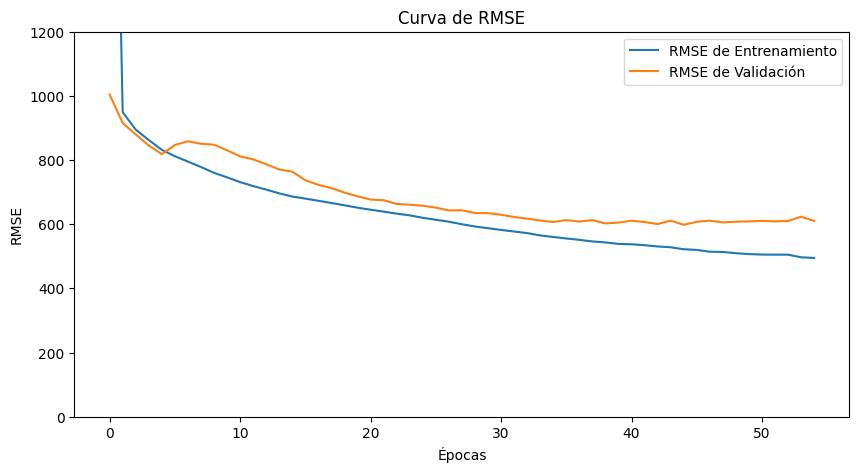

In [81]:
# Graficar el RMSE
plt.figure(figsize=(10, 5))
plt.plot(history.history['rmse'], label='RMSE de Entrenamiento')
plt.plot(history.history['val_rmse'], label='RMSE de Validación')
plt.title('Curva de RMSE')
plt.xlabel('Épocas')
plt.ylabel('RMSE')
plt.ylim(0, 1200)
plt.legend()
plt.show()

In [82]:
print("Mejores hiperparámetros:", best_params)

Mejores hiperparámetros: {'hidden_layer_sizes': (512, 512), 'learning_rate': 0.001, 'batch_size': 256, 'epochs': 200}


In [83]:
# Evaluar el mejor modelo en el conjunto de prueba
y_pred_test7 = best_model.predict(X_test7_scaled).flatten()

1475/1475 ━━━━━━━━━━━━━━━━━━━━ 1s 642us/step


In [84]:
# Crear DataFrame con los resultados del conjunto de prueba
df_results_test7 = pd.DataFrame({'y_test_7_valores': y_test7, 'y_pred_test_7': y_pred_test7})
print(df_results_test7)

       y_test_7_valores  y_pred_test_7
0               1760.00    1919.706543
1               1899.00    1798.257812
2              19990.00   20034.566406
3               1163.55    1051.424316
4               1814.76    1666.308838
...                 ...            ...
47181           1900.00    1772.781250
47182          21990.00   22248.949219
47183            996.00     932.601135
47184            880.00     809.398010
47185           1081.49    1061.922852

[47186 rows x 2 columns]


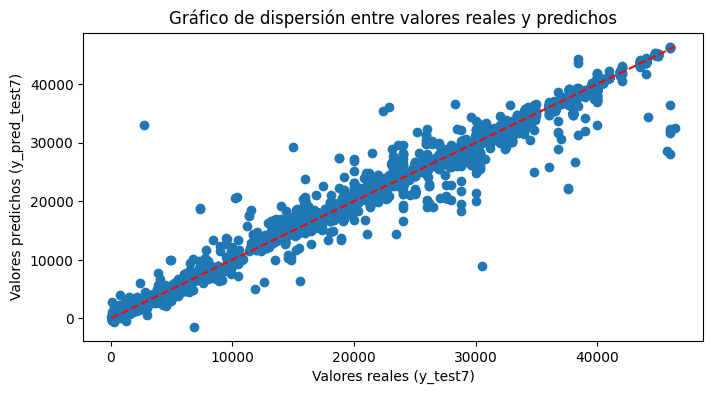

In [85]:
# Gráfico de dispersión entre valores reales y predichos
plt.figure(figsize=(8, 4))
plt.scatter(y_test7, y_pred_test7)
plt.xlabel("Valores reales (y_test7)")
plt.ylabel("Valores predichos (y_pred_test7)")
plt.title("Gráfico de dispersión entre valores reales y predichos")

# Agregar la recta identidad
plt.plot([min(y_test7), max(y_test7)], [min(y_test7), max(y_test7)], color='red', linestyle='--')
plt.show()

## Red Convolucional (CNN)

In [91]:
SEED = 42
random.seed(SEED)
np.random.seed(SEED)
tf.random.set_seed(SEED)

In [92]:
X8 = df2.loc[:,['CILINDRAJE','MARCA_encoded','MODELO_encoded','CLASE_encoded',
                'TIPO COMBUSTIBLE_encoded','PAÍS_encoded','CANTÓN_encoded','COLOR 1_encoded',
                'DIA_DEL_AÑO_encoded','PERSONA NATURAL - JURÍDICA_encoded',
                'TIPO_encoded','EDAD','TIPO SERVICIO_encoded','TIPO TRANSACCIÓN_encoded']]

In [93]:
y8 = df2['AVALÚO'].values

In [94]:
df2.loc[:, 'Estrato'] = pd.cut(df2['AVALÚO'], 40, labels=False)

In [95]:
X_train8, X_test8, y_train8, y_test8 = train_test_split(
    X8, y8, test_size=0.2, random_state=42,
    stratify=df2['Estrato']
)

In [96]:
# Escalamiento de los datos
scaler = StandardScaler()
X_train8_scaled = scaler.fit_transform(X_train8)
X_test8_scaled = scaler.transform(X_test8)

In [97]:
# Preparar datos para la CNN
# Cambiar las dimensiones para que sean compatibles con Conv1D: (n_samples, n_features, 1)
X_train_cnn = X_train8_scaled.reshape(X_train8_scaled.shape[0], X_train8_scaled.shape[1], 1)
X_test_cnn = X_test8_scaled.reshape(X_test8_scaled.shape[0], X_test8_scaled.shape[1], 1)

In [106]:
def create_cnn_model(input_shape, num_filters=32, kernel_size=3, learning_rate=0.001, dense_layers=[512, 512], l1_rate=0.1, l2_rate=0.1):
    model = Sequential()

    # Capa convolucional 1D
    model.add(Conv1D(filters=num_filters, kernel_size=kernel_size, activation='relu', input_shape=input_shape))

    # Capa de MaxPooling
    model.add(MaxPooling1D(pool_size=2))

    # Aplanar para pasar a las capas densas
    model.add(Flatten())

    # Capas densas finales
    for neurons in dense_layers:
        model.add(Dense(neurons, activation='relu', kernel_regularizer=l1_l2(l1=l1_rate, l2=l2_rate)))

    # Capa de salida
    model.add(Dense(1))  # Salida para regresión

    # Compilar el modelo
    model.compile(optimizer=Adam(learning_rate=learning_rate),
                  loss='mse',
                  metrics=['mae', tf.keras.metrics.RootMeanSquaredError(name='rmse')])

    return model

In [107]:
# Hiperparámetros iniciales
num_filters_list = [32, 64]
kernel_size_list = [3, 5]
dense_layers_list = [[512, 512]]
learning_rates = [0.001, 0.01]
batch_sizes = [128, 256]
epochs_list = [100, 200]

In [108]:
# Variables para almacenar el mejor modelo y sus métricas
best_mse = float('inf')
best_params2 = {}
best_model2 = None

In [109]:
# Bucle para probar combinaciones de hiperparámetros
for num_filters in num_filters_list:
    for kernel_size in kernel_size_list:
        for dense_layers in dense_layers_list:
            for learning_rate in learning_rates:
                for batch_size in batch_sizes:
                    for epochs in epochs_list:
                        print(f"Entrenando con num_filters={num_filters}, kernel_size={kernel_size}, dense_layers={dense_layers}, learning_rate={learning_rate}, batch_size={batch_size}, epochs={epochs}")

                        # Crear el modelo con la combinación actual
                        model = create_cnn_model(input_shape=(X_train_cnn.shape[1], 1),
                                                 num_filters=num_filters,
                                                 kernel_size=kernel_size,
                                                 learning_rate=learning_rate,
                                                 dense_layers=dense_layers)

                        # EarlyStopping para prevenir sobreajuste
                        early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

                        # Entrenar el modelo
                        history2 = model.fit(
                            X_train_cnn, y_train8,
                            validation_split=0.2,
                            epochs=epochs,
                            batch_size=batch_size,
                            verbose=1,
                            callbacks=[early_stopping]
                        )

                        # Evaluar el modelo en el conjunto de prueba
                        y_pred_test = model.predict(X_test_cnn).flatten()
                        mse = mean_squared_error(y_test8, y_pred_test)

                        print(f"MSE: {mse}")

                        # Guardar el mejor modelo
                        if mse < best_mse:
                            best_mse2 = mse
                            best_params2 = {
                                'num_filters': num_filters,
                                'kernel_size': kernel_size,
                                'dense_layers': dense_layers,
                                'learning_rate': learning_rate,
                                'batch_size': batch_size,
                                'epochs': epochs
                            }
                            best_model2 = model

Entrenando con num_filters=32, kernel_size=3, dense_layers=[512, 512], learning_rate=0.001, batch_size=128, epochs=100
Epoch 1/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - loss: 48123972.0000 - mae: 3259.5979 - rmse: 6339.6592 - val_loss: 1789687.7500 - val_mae: 773.1971 - val_rmse: 1336.4053
Epoch 2/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 1689329.7500 - mae: 733.1096 - rmse: 1296.8855 - val_loss: 1275941.8750 - val_mae: 597.2100 - val_rmse: 1127.7095
Epoch 3/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 1282225.8750 - mae: 578.5206 - rmse: 1129.2572 - val_loss: 1084895.0000 - val_mae: 523.8639 - val_rmse: 1039.3501
Epoch 4/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 1107169.8750 - mae: 503.8780 - rmse: 1048.9114 - val_loss: 1010162.1875 - val_mae: 508.3545 - val_rmse: 1002.6164
Epoch 5/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 1028456.1250 - mae: 472.2957 - rmse: 1010.6546 - val_loss: 958531.5000 - val_mae: 494.2451 - val_rmse: 976.4

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 49227100.0000 - mae: 3310.9329 - rmse: 6425.5381 - val_loss: 1939983.1250 - val_mae: 811.3969 - val_rmse: 1391.5875
Epoch 2/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 1750883.2500 - mae: 746.4382 - rmse: 1319.5425 - val_loss: 1207771.2500 - val_mae: 560.2173 - val_rmse: 1097.1067
Epoch 3/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 1218836.8750 - mae: 544.5916 - rmse: 1100.7963 - val_loss: 1039243.8125 - val_mae: 496.3661 - val_rmse: 1017.2274
Epoch 4/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - loss: 1043604.8750 - mae: 462.7640 - rmse: 1018.1313 - val_loss: 947791.6875 - val_mae: 472.4918 - val_rmse: 971.1203
Epoch 5/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - loss: 963880.5000 - mae: 427.6332 - rmse: 978.1866 - val_loss: 903325.8750 - val_mae: 459.6427 - val_rmse: 947.8660
Epoch 6/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 923983.0000 - mae: 410.6290 - rmse: 957.5750 - val_loss: 876327.0625

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 73949952.0000 - mae: 4423.6279 - rmse: 8110.1909 - val_loss: 2873817.0000 - val_mae: 1000.5166 - val_rmse: 1694.2915
Epoch 2/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 2604664.7500 - mae: 945.9860 - rmse: 1610.5449 - val_loss: 1660681.2500 - val_mae: 733.0541 - val_rmse: 1287.2390
Epoch 3/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 1629812.2500 - mae: 712.0685 - rmse: 1274.2244 - val_loss: 1348089.6250 - val_mae: 620.1191 - val_rmse: 1159.3588
Epoch 4/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 1368390.5000 - mae: 612.9453 - rmse: 1167.1805 - val_loss: 1178306.8750 - val_mae: 544.3817 - val_rmse: 1083.5796
Epoch 5/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 1223358.5000 - mae: 550.9049 - rmse: 1103.2178 - val_loss: 1080455.3750 - val_mae: 503.4624 - val_rmse: 1037.3698
Epoch 6/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 1121195.1250 - mae: 507.1636 - rmse: 1055.8363 - val_loss: 1008079.1250 -

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 74998600.0000 - mae: 4472.8438 - rmse: 8174.5020 - val_loss: 2944202.5000 - val_mae: 1012.7193 - val_rmse: 1714.9425
Epoch 2/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 2708377.0000 - mae: 963.5413 - rmse: 1642.7418 - val_loss: 1855378.6250 - val_mae: 783.7067 - val_rmse: 1360.7987
Epoch 3/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 1811138.8750 - mae: 763.1259 - rmse: 1343.2935 - val_loss: 1452713.6250 - val_mae: 659.1186 - val_rmse: 1203.6650
Epoch 4/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 1466113.6250 - mae: 653.4443 - rmse: 1208.3657 - val_loss: 1233534.8750 - val_mae: 572.6443 - val_rmse: 1108.7819
Epoch 5/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 1268943.7500 - mae: 569.5267 - rmse: 1123.6643 - val_loss: 1081376.5000 - val_mae: 501.3748 - val_rmse: 1037.7913
Epoch 6/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 1139249.5000 - mae: 508.1195 - rmse: 1064.2819 - val_loss: 998274.6875 - 

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - loss: 15803505.0000 - mae: 1623.2463 - rmse: 3426.6685 - val_loss: 981321.1250 - val_mae: 483.0413 - val_rmse: 988.2198
Epoch 2/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 1138056.5000 - mae: 515.1696 - rmse: 1062.8247 - val_loss: 777305.3750 - val_mae: 374.3303 - val_rmse: 878.4700
Epoch 3/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - loss: 947957.0000 - mae: 448.0738 - rmse: 969.8162 - val_loss: 678527.4375 - val_mae: 334.4904 - val_rmse: 820.1362
Epoch 4/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - loss: 824628.6250 - mae: 403.3169 - rmse: 904.1180 - val_loss: 601474.3750 - val_mae: 310.7789 - val_rmse: 771.3403
Epoch 5/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - loss: 723484.0000 - mae: 366.8613 - rmse: 846.1147 - val_loss: 525485.7500 - val_mae: 285.1591 - val_rmse: 720.1631
Epoch 6/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 647224.6250 - mae: 342.1329 - rmse: 799.8221 - val_loss: 473888.2500 - val_mae

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - loss: 15860451.0000 - mae: 1642.2985 - rmse: 3438.9336 - val_loss: 991489.0625 - val_mae: 488.2851 - val_rmse: 993.6213
Epoch 2/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 1142059.2500 - mae: 507.6298 - rmse: 1065.1318 - val_loss: 826951.3750 - val_mae: 385.6372 - val_rmse: 906.4498
Epoch 3/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 975764.3125 - mae: 433.7523 - rmse: 983.9879 - val_loss: 757352.9375 - val_mae: 355.4829 - val_rmse: 866.9500
Epoch 4/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 894245.3750 - mae: 409.4196 - rmse: 941.3920 - val_loss: 680861.8125 - val_mae: 333.5524 - val_rmse: 821.1893
Epoch 5/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 826660.2500 - mae: 395.7674 - rmse: 904.2814 - val_loss: 609181.9375 - val_mae: 299.5467 - val_rmse: 775.8929
Epoch 6/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 746555.0000 - mae: 375.2097 - rmse: 858.7754 - val_loss: 536759.0000 - val_mae

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 25389686.0000 - mae: 2266.6079 - rmse: 4453.2412 - val_loss: 1263637.3750 - val_mae: 590.3092 - val_rmse: 1122.1277
Epoch 2/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 1161211.2500 - mae: 498.6197 - rmse: 1073.5731 - val_loss: 952393.5625 - val_mae: 453.4258 - val_rmse: 973.2772
Epoch 3/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 998780.3125 - mae: 431.7817 - rmse: 995.6066 - val_loss: 908302.6250 - val_mae: 447.7198 - val_rmse: 950.0402
Epoch 4/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 921867.7500 - mae: 404.9583 - rmse: 956.0154 - val_loss: 864734.3125 - val_mae: 439.5522 - val_rmse: 926.7317
Epoch 5/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 859715.4375 - mae: 388.5533 - rmse: 922.9674 - val_loss: 833201.3125 - val_mae: 430.3616 - val_rmse: 909.4718
Epoch 6/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 807649.8125 - mae: 374.8274 - rmse: 894.4164 - val_loss: 787089.0000 - val_mae: 414.1473

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - loss: 25666826.0000 - mae: 2254.5869 - rmse: 4480.7358 - val_loss: 1340362.3750 - val_mae: 619.7170 - val_rmse: 1156.1342
Epoch 2/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 1317335.8750 - mae: 604.6273 - rmse: 1144.1173 - val_loss: 1075629.5000 - val_mae: 565.5297 - val_rmse: 1034.9867
Epoch 3/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 1075437.5000 - mae: 508.0584 - rmse: 1033.5999 - val_loss: 981963.8125 - val_mae: 532.5893 - val_rmse: 988.3679
Epoch 4/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 981289.5000 - mae: 468.7359 - rmse: 986.8924 - val_loss: 918680.5625 - val_mae: 504.3048 - val_rmse: 955.6519
Epoch 5/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 915515.3750 - mae: 447.3762 - rmse: 952.9166 - val_loss: 832258.8750 - val_mae: 450.3995 - val_rmse: 909.1428
Epoch 6/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 864569.0000 - mae: 430.7727 - rmse: 925.6476 - val_loss: 743137.5000 - val_mae: 400.

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 47415808.0000 - mae: 3168.6965 - rmse: 6298.7397 - val_loss: 2177934.5000 - val_mae: 849.5771 - val_rmse: 1474.7460
Epoch 2/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 2003462.6250 - mae: 804.1970 - rmse: 1412.0953 - val_loss: 1350802.8750 - val_mae: 629.0749 - val_rmse: 1160.7185
Epoch 3/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 1326023.8750 - mae: 599.5181 - rmse: 1148.7734 - val_loss: 1046275.9375 - val_mae: 486.5877 - val_rmse: 1020.9374
Epoch 4/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - loss: 1077373.2500 - mae: 482.2961 - rmse: 1034.9661 - val_loss: 923863.6875 - val_mae: 442.5780 - val_rmse: 958.9390
Epoch 5/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 968398.8750 - mae: 425.7499 - rmse: 980.8574 - val_loss: 856840.7500 - val_mae: 414.3818 - val_rmse: 923.2191
Epoch 6/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 916181.1250 - mae: 398.7899 - rmse: 953.8168 - val_loss: 817258.0000

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - loss: 47822432.0000 - mae: 3176.4558 - rmse: 6325.7520 - val_loss: 1846673.6250 - val_mae: 778.8680 - val_rmse: 1357.7422
Epoch 2/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 1767109.5000 - mae: 744.9205 - rmse: 1326.2496 - val_loss: 1302349.8750 - val_mae: 608.1386 - val_rmse: 1139.6145
Epoch 3/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 1353003.6250 - mae: 611.8424 - rmse: 1160.4761 - val_loss: 1133662.0000 - val_mae: 546.5424 - val_rmse: 1062.8868
Epoch 4/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 1151640.8750 - mae: 535.4735 - rmse: 1070.1355 - val_loss: 1045311.5000 - val_mae: 512.7355 - val_rmse: 1020.3353
Epoch 5/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 1032959.0625 - mae: 476.2996 - rmse: 1013.2210 - val_loss: 987617.3750 - val_mae: 486.8653 - val_rmse: 991.5519
Epoch 6/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 968501.8125 - mae: 442.5521 - rmse: 980.9150 - val_loss: 924200.

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 73386680.0000 - mae: 4320.7793 - rmse: 8073.6543 - val_loss: 3138537.7500 - val_mae: 1032.3120 - val_rmse: 1770.7365
Epoch 2/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 2868025.5000 - mae: 974.2576 - rmse: 1690.1425 - val_loss: 1866751.2500 - val_mae: 774.8994 - val_rmse: 1365.0042
Epoch 3/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 1831934.6250 - mae: 759.9728 - rmse: 1351.1315 - val_loss: 1447476.7500 - val_mae: 666.2773 - val_rmse: 1201.4834
Epoch 4/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 1459263.1250 - mae: 653.6066 - rmse: 1205.5322 - val_loss: 1196452.0000 - val_mae: 567.8497 - val_rmse: 1091.8981
Epoch 5/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 1238587.5000 - mae: 568.6049 - rmse: 1110.1588 - val_loss: 1055597.0000 - val_mae: 498.9601 - val_rmse: 1025.2596
Epoch 6/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 1106335.3750 - mae: 506.4879 - rmse: 1048.9050 - val_loss: 981826.1875 - 

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - loss: 74121816.0000 - mae: 4372.7500 - rmse: 8126.3242 - val_loss: 3449985.5000 - val_mae: 1094.5507 - val_rmse: 1856.6229
Epoch 2/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 3180391.0000 - mae: 1040.9288 - rmse: 1780.1464 - val_loss: 2070401.0000 - val_mae: 836.7219 - val_rmse: 1437.7483
Epoch 3/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 1996379.5000 - mae: 817.9570 - rmse: 1410.6366 - val_loss: 1536130.2500 - val_mae: 707.8171 - val_rmse: 1237.9331
Epoch 4/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 1538861.6250 - mae: 695.9159 - rmse: 1238.2944 - val_loss: 1294186.8750 - val_mae: 619.6181 - val_rmse: 1135.8888
Epoch 5/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 1321512.8750 - mae: 616.2690 - rmse: 1147.0659 - val_loss: 1140788.3750 - val_mae: 546.6171 - val_rmse: 1066.1300
Epoch 6/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 1174983.8750 - mae: 549.4499 - rmse: 1081.1826 - val_loss: 1027241.3750 

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 15895132.0000 - mae: 1607.0787 - rmse: 3441.8625 - val_loss: 1048392.7500 - val_mae: 503.5109 - val_rmse: 1021.9559
Epoch 2/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 1063324.8750 - mae: 485.7047 - rmse: 1027.7994 - val_loss: 814185.8750 - val_mae: 381.5495 - val_rmse: 899.7903
Epoch 3/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 941876.6875 - mae: 430.9745 - rmse: 966.9503 - val_loss: 744189.3125 - val_mae: 348.0702 - val_rmse: 859.6591
Epoch 4/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 889705.6875 - mae: 414.6736 - rmse: 939.1790 - val_loss: 705118.0625 - val_mae: 332.0752 - val_rmse: 836.4940
Epoch 5/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 821260.1875 - mae: 395.0959 - rmse: 902.0671 - val_loss: 640653.1875 - val_mae: 317.4865 - val_rmse: 796.8627
Epoch 6/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 756611.3750 - mae: 380.1383 - rmse: 865.5323 - val_loss: 617001.0625 - val_m

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 15986559.0000 - mae: 1599.2926 - rmse: 3444.9785 - val_loss: 1059075.0000 - val_mae: 544.3209 - val_rmse: 1027.2268
Epoch 2/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 1093713.3750 - mae: 512.5535 - rmse: 1042.4628 - val_loss: 834041.3750 - val_mae: 408.5324 - val_rmse: 910.8621
Epoch 3/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 935015.0000 - mae: 426.8221 - rmse: 963.7249 - val_loss: 806825.5000 - val_mae: 387.5949 - val_rmse: 895.5283
Epoch 4/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 856238.1250 - mae: 389.9726 - rmse: 921.6448 - val_loss: 711390.6875 - val_mae: 346.8391 - val_rmse: 840.2614
Epoch 5/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 800276.3125 - mae: 373.3138 - rmse: 890.3996 - val_loss: 686573.3125 - val_mae: 346.8379 - val_rmse: 825.1750
Epoch 6/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 738958.1875 - mae: 358.6350 - rmse: 855.3947 - val_loss: 657047.1250 - val_m

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 24537438.0000 - mae: 2091.7747 - rmse: 4376.5093 - val_loss: 1505562.6250 - val_mae: 703.1905 - val_rmse: 1225.5752
Epoch 2/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 1280130.7500 - mae: 582.8782 - rmse: 1127.4258 - val_loss: 964659.7500 - val_mae: 471.4195 - val_rmse: 979.9850
Epoch 3/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 1015157.3125 - mae: 465.0529 - rmse: 1004.1727 - val_loss: 814608.2500 - val_mae: 429.2812 - val_rmse: 900.0131
Epoch 4/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 898564.2500 - mae: 429.8386 - rmse: 944.7460 - val_loss: 729874.8750 - val_mae: 377.3192 - val_rmse: 851.5258
Epoch 5/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 819803.1250 - mae: 404.8409 - rmse: 902.2773 - val_loss: 732402.4375 - val_mae: 374.9923 - val_rmse: 852.9388
Epoch 6/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 782033.6250 - mae: 396.0955 - rmse: 881.0826 - val_loss: 693756.2500 - val_mae: 360.97

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - loss: 25959196.0000 - mae: 2164.0867 - rmse: 4512.2275 - val_loss: 1396595.3750 - val_mae: 646.8998 - val_rmse: 1180.3423
Epoch 2/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 1326694.6250 - mae: 599.1243 - rmse: 1148.2426 - val_loss: 896607.7500 - val_mae: 446.4623 - val_rmse: 944.2676
Epoch 3/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 972848.1250 - mae: 427.0757 - rmse: 982.7104 - val_loss: 776080.4375 - val_mae: 361.9760 - val_rmse: 877.8589
Epoch 4/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 875933.2500 - mae: 387.3894 - rmse: 932.2032 - val_loss: 706028.3125 - val_mae: 319.5309 - val_rmse: 836.8625
Epoch 5/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 812298.8125 - mae: 367.5863 - rmse: 897.3664 - val_loss: 695545.6875 - val_mae: 318.5953 - val_rmse: 830.4642
Epoch 6/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 785493.4375 - mae: 365.4576 - rmse: 882.2747 - val_loss: 669488.1250 - val_m

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 9s 7ms/step - loss: 45389864.0000 - mae: 3109.6633 - rmse: 6135.2583 - val_loss: 1728715.6250 - val_mae: 758.6091 - val_rmse: 1313.3938
Epoch 2/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 1617812.5000 - mae: 718.9608 - rmse: 1268.8690 - val_loss: 1240982.7500 - val_mae: 599.4065 - val_rmse: 1112.1210
Epoch 3/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 1250397.6250 - mae: 583.4971 - rmse: 1115.2479 - val_loss: 1091108.7500 - val_mae: 551.3970 - val_rmse: 1042.3689
Epoch 4/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 1077366.8750 - mae: 499.0813 - rmse: 1034.6748 - val_loss: 985674.0625 - val_mae: 515.7128 - val_rmse: 990.3401
Epoch 5/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 8s 7ms/step - loss: 982351.7500 - mae: 449.8390 - rmse: 987.6136 - val_loss: 949885.5000 - val_mae: 509.7381 - val_rmse: 971.9797
Epoch 6/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 927133.0000 - mae: 423.1125 - rmse: 959.1898 - val_loss: 922801.4375

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step - loss: 45820676.0000 - mae: 3134.8464 - rmse: 6165.8721 - val_loss: 1695685.2500 - val_mae: 749.9541 - val_rmse: 1300.7560
Epoch 2/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 1608357.2500 - mae: 713.6451 - rmse: 1265.1017 - val_loss: 1206215.7500 - val_mae: 572.1712 - val_rmse: 1096.3297
Epoch 3/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 1208545.5000 - mae: 550.3985 - rmse: 1096.1099 - val_loss: 1054392.6250 - val_mae: 519.6885 - val_rmse: 1024.5769
Epoch 4/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 1039323.2500 - mae: 460.9690 - rmse: 1016.0250 - val_loss: 953732.1250 - val_mae: 480.8535 - val_rmse: 974.0919
Epoch 5/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 951893.8125 - mae: 416.1109 - rmse: 972.0510 - val_loss: 905048.0000 - val_mae: 458.8912 - val_rmse: 948.6858
Epoch 6/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 905149.0000 - mae: 392.7727 - rmse: 947.6918 - val_loss: 877547.2500

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


590/590 ━━━━━━━━━━━━━━━━━━━━ 6s 8ms/step - loss: 69865616.0000 - mae: 4232.7124 - rmse: 7851.2598 - val_loss: 3044108.7500 - val_mae: 1021.2312 - val_rmse: 1743.7345
Epoch 2/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 2731683.2500 - mae: 965.9034 - rmse: 1649.1115 - val_loss: 1724794.5000 - val_mae: 747.1617 - val_rmse: 1311.8549
Epoch 3/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 1696780.6250 - mae: 733.5903 - rmse: 1300.1603 - val_loss: 1369912.5000 - val_mae: 634.1100 - val_rmse: 1168.6854
Epoch 4/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 1396341.7500 - mae: 629.2469 - rmse: 1179.0538 - val_loss: 1181899.8750 - val_mae: 547.5281 - val_rmse: 1085.1769
Epoch 5/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 1218251.3750 - mae: 548.6306 - rmse: 1100.8606 - val_loss: 1072724.7500 - val_mae: 502.5557 - val_rmse: 1033.5691
Epoch 6/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 1107182.0000 - mae: 497.2841 - rmse: 1049.2133 - val_loss: 996806.1250 - 

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 70466464.0000 - mae: 4295.7046 - rmse: 7887.3569 - val_loss: 2637521.0000 - val_mae: 955.8683 - val_rmse: 1622.9510
Epoch 2/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 2353987.2500 - mae: 892.2662 - rmse: 1530.4413 - val_loss: 1544684.5000 - val_mae: 690.0763 - val_rmse: 1241.2380
Epoch 3/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 1532365.7500 - mae: 672.7510 - rmse: 1235.1654 - val_loss: 1243490.7500 - val_mae: 574.5199 - val_rmse: 1113.1652
Epoch 4/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 1274012.7500 - mae: 568.7125 - rmse: 1125.6819 - val_loss: 1087479.2500 - val_mae: 502.0612 - val_rmse: 1040.6263
Epoch 5/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 1132883.3750 - mae: 502.7280 - rmse: 1061.1256 - val_loss: 1004615.5000 - val_mae: 467.7632 - val_rmse: 999.9288
Epoch 6/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 1043927.8125 - mae: 455.5539 - rmse: 1018.3441 - val_loss: 931775.0000 - va

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 9s 6ms/step - loss: 15257650.0000 - mae: 1590.8087 - rmse: 3369.8994 - val_loss: 1085422.6250 - val_mae: 560.6249 - val_rmse: 1039.5691
Epoch 2/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 1099795.6250 - mae: 503.6389 - rmse: 1045.1501 - val_loss: 870813.5625 - val_mae: 454.8325 - val_rmse: 930.0955
Epoch 3/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 984806.8125 - mae: 450.7788 - rmse: 987.6413 - val_loss: 764288.1250 - val_mae: 370.9536 - val_rmse: 870.5889
Epoch 4/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 884747.3125 - mae: 416.8871 - rmse: 935.6557 - val_loss: 732446.0625 - val_mae: 359.3781 - val_rmse: 851.7548
Epoch 5/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 760558.1250 - mae: 375.7272 - rmse: 867.4089 - val_loss: 601906.8750 - val_mae: 300.1872 - val_rmse: 771.1478
Epoch 6/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 686243.0000 - mae: 352.8146 - rmse: 823.5195 - val_loss: 522596.9375 - val_m

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step - loss: 15026097.0000 - mae: 1584.0630 - rmse: 3337.5984 - val_loss: 1089659.7500 - val_mae: 538.1691 - val_rmse: 1041.5891
Epoch 2/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 1061613.6250 - mae: 484.9548 - rmse: 1026.3882 - val_loss: 834309.0625 - val_mae: 420.8854 - val_rmse: 910.1877
Epoch 3/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 907250.6250 - mae: 425.0920 - rmse: 947.6058 - val_loss: 663173.3125 - val_mae: 330.3808 - val_rmse: 810.4163
Epoch 4/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 795698.6875 - mae: 390.7041 - rmse: 887.2676 - val_loss: 627375.4375 - val_mae: 324.4822 - val_rmse: 787.7057
Epoch 5/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 728138.6250 - mae: 368.5667 - rmse: 848.4390 - val_loss: 599300.9375 - val_mae: 312.5464 - val_rmse: 769.4155
Epoch 6/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 678842.6250 - mae: 351.6562 - rmse: 818.8157 - val_loss: 510690.1875 - val_m

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


590/590 ━━━━━━━━━━━━━━━━━━━━ 6s 8ms/step - loss: 23217854.0000 - mae: 2124.0847 - rmse: 4241.9468 - val_loss: 1188798.5000 - val_mae: 542.6997 - val_rmse: 1088.2557
Epoch 2/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 1154195.1250 - mae: 490.9037 - rmse: 1070.6873 - val_loss: 1084687.8750 - val_mae: 547.8448 - val_rmse: 1038.9723
Epoch 3/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 1031128.2500 - mae: 437.1907 - rmse: 1011.6762 - val_loss: 1024277.3750 - val_mae: 519.5557 - val_rmse: 1009.2593
Epoch 4/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 951006.3125 - mae: 414.8189 - rmse: 971.2098 - val_loss: 866624.4375 - val_mae: 449.5334 - val_rmse: 927.7391
Epoch 5/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 896159.0625 - mae: 405.7846 - rmse: 942.5311 - val_loss: 751403.0000 - val_mae: 385.2222 - val_rmse: 863.2766
Epoch 6/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 844989.7500 - mae: 392.0927 - rmse: 915.0258 - val_loss: 738151.2500 - val_mae: 39

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


590/590 ━━━━━━━━━━━━━━━━━━━━ 6s 8ms/step - loss: 23343774.0000 - mae: 2104.6079 - rmse: 4257.2075 - val_loss: 1241015.3750 - val_mae: 581.6839 - val_rmse: 1111.9424
Epoch 2/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 1220702.5000 - mae: 536.7842 - rmse: 1101.2014 - val_loss: 1026594.2500 - val_mae: 505.5427 - val_rmse: 1010.5002
Epoch 3/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 1031303.8125 - mae: 459.0241 - rmse: 1011.6155 - val_loss: 878439.6250 - val_mae: 468.8648 - val_rmse: 933.9540
Epoch 4/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 909608.2500 - mae: 420.3858 - rmse: 949.2854 - val_loss: 713664.5625 - val_mae: 391.9804 - val_rmse: 840.8544
Epoch 5/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 808660.1875 - mae: 396.1768 - rmse: 894.6202 - val_loss: 662784.1250 - val_mae: 374.0007 - val_rmse: 809.7336
Epoch 6/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 732408.3125 - mae: 370.1009 - rmse: 851.0142 - val_loss: 599078.3750 - val_mae: 322.

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 11s 8ms/step - loss: 44253384.0000 - mae: 2986.9546 - rmse: 6048.4541 - val_loss: 1833759.8750 - val_mae: 760.4195 - val_rmse: 1352.8695
Epoch 2/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 9s 8ms/step - loss: 1689241.8750 - mae: 717.5227 - rmse: 1296.0215 - val_loss: 1160225.2500 - val_mae: 541.1942 - val_rmse: 1075.1981
Epoch 3/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 9s 8ms/step - loss: 1166052.0000 - mae: 524.4814 - rmse: 1076.5310 - val_loss: 979151.2500 - val_mae: 461.4438 - val_rmse: 987.2259
Epoch 4/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 9s 8ms/step - loss: 1008834.8750 - mae: 442.3858 - rmse: 1000.9441 - val_loss: 888317.3125 - val_mae: 421.9318 - val_rmse: 939.9863
Epoch 5/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 929330.4375 - mae: 399.6809 - rmse: 960.3934 - val_loss: 837595.9375 - val_mae: 401.5256 - val_rmse: 912.5184
Epoch 6/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 881184.3125 - mae: 379.8750 - rmse: 934.9761 - val_loss: 802415.312

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 11s 8ms/step - loss: 43782536.0000 - mae: 2969.9578 - rmse: 6016.5557 - val_loss: 1764444.5000 - val_mae: 749.3749 - val_rmse: 1327.0150
Epoch 2/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 9s 8ms/step - loss: 1657986.3750 - mae: 709.5092 - rmse: 1284.2831 - val_loss: 1206372.0000 - val_mae: 565.3212 - val_rmse: 1096.4974
Epoch 3/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 9s 8ms/step - loss: 1223337.1250 - mae: 545.6272 - rmse: 1102.8660 - val_loss: 990321.6250 - val_mae: 459.0027 - val_rmse: 992.9282
Epoch 4/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 1049212.2500 - mae: 461.6387 - rmse: 1021.0133 - val_loss: 894326.5625 - val_mae: 410.9724 - val_rmse: 943.2283
Epoch 5/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 966485.3750 - mae: 420.2256 - rmse: 979.6501 - val_loss: 840515.6875 - val_mae: 386.2999 - val_rmse: 914.1806
Epoch 6/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 915273.6875 - mae: 396.5632 - rmse: 953.1466 - val_loss: 806246.62

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


590/590 ━━━━━━━━━━━━━━━━━━━━ 7s 10ms/step - loss: 68525864.0000 - mae: 4097.3838 - rmse: 7767.8965 - val_loss: 2962069.2500 - val_mae: 981.2984 - val_rmse: 1720.0955
Epoch 2/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 2659475.2500 - mae: 927.7434 - rmse: 1626.8300 - val_loss: 1666287.7500 - val_mae: 727.7668 - val_rmse: 1289.3333
Epoch 3/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - loss: 1608587.2500 - mae: 701.0533 - rmse: 1265.4446 - val_loss: 1222951.7500 - val_mae: 574.0982 - val_rmse: 1103.9441
Epoch 4/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 1248367.8750 - mae: 569.6384 - rmse: 1114.2739 - val_loss: 1044908.5000 - val_mae: 484.9457 - val_rmse: 1020.0172
Epoch 5/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - loss: 1081939.7500 - mae: 487.3105 - rmse: 1036.9763 - val_loss: 938394.8125 - val_mae: 426.8396 - val_rmse: 966.3210
Epoch 6/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 989548.1250 - mae: 434.9226 - rmse: 991.4192 - val_loss: 864394.9375 - v

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


590/590 ━━━━━━━━━━━━━━━━━━━━ 7s 10ms/step - loss: 68168776.0000 - mae: 4095.5374 - rmse: 7744.3838 - val_loss: 3019998.2500 - val_mae: 995.5666 - val_rmse: 1736.8899
Epoch 2/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 2774209.5000 - mae: 947.6960 - rmse: 1662.1740 - val_loss: 1791908.2500 - val_mae: 751.4886 - val_rmse: 1337.2804
Epoch 3/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 1728778.7500 - mae: 730.0671 - rmse: 1312.0690 - val_loss: 1280810.0000 - val_mae: 596.4535 - val_rmse: 1129.9720
Epoch 4/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - loss: 1307140.7500 - mae: 587.2562 - rmse: 1140.3949 - val_loss: 1068914.8750 - val_mae: 496.3134 - val_rmse: 1031.8248
Epoch 5/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 1121716.8750 - mae: 500.6484 - rmse: 1056.0175 - val_loss: 967141.3750 - val_mae: 445.9494 - val_rmse: 981.1700
Epoch 6/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - loss: 1018827.4375 - mae: 449.4633 - rmse: 1006.1766 - val_loss: 884502.2500 - 

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 12s 9ms/step - loss: 14655051.0000 - mae: 1503.1034 - rmse: 3294.5371 - val_loss: 938212.0000 - val_mae: 466.6198 - val_rmse: 966.3085
Epoch 2/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 1017160.7500 - mae: 463.8882 - rmse: 1005.0977 - val_loss: 951581.5000 - val_mae: 479.0818 - val_rmse: 972.8185
Epoch 3/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 10s 9ms/step - loss: 970202.1875 - mae: 436.0222 - rmse: 980.0454 - val_loss: 824922.2500 - val_mae: 422.9243 - val_rmse: 905.0469
Epoch 4/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 915657.0625 - mae: 417.8755 - rmse: 951.0083 - val_loss: 847982.2500 - val_mae: 440.8635 - val_rmse: 917.3934
Epoch 5/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 825970.0000 - mae: 394.6980 - rmse: 902.9991 - val_loss: 713794.7500 - val_mae: 390.2483 - val_rmse: 840.9309
Epoch 6/100
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 760470.6250 - mae: 376.8905 - rmse: 866.2517 - val_loss: 675447.3125 - v

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1180/1180 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step - loss: 14386327.0000 - mae: 1522.4332 - rmse: 3270.3030 - val_loss: 1022069.0000 - val_mae: 495.3132 - val_rmse: 1008.7286
Epoch 2/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 1070839.5000 - mae: 483.7618 - rmse: 1031.3711 - val_loss: 886792.3125 - val_mae: 428.9457 - val_rmse: 938.9252
Epoch 3/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 938963.1875 - mae: 433.2989 - rmse: 965.0159 - val_loss: 735207.8750 - val_mae: 367.2630 - val_rmse: 854.0679
Epoch 4/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 869140.6250 - mae: 415.8266 - rmse: 927.5076 - val_loss: 691468.1875 - val_mae: 354.5868 - val_rmse: 827.7731
Epoch 5/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 806747.7500 - mae: 392.6094 - rmse: 892.9650 - val_loss: 647327.3125 - val_mae: 344.7684 - val_rmse: 800.4000
Epoch 6/200
1180/1180 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 729845.7500 - mae: 368.6884 - rmse: 849.4835 - val_loss: 597431.3125 - val_m

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - loss: 22647074.0000 - mae: 2001.6835 - rmse: 4191.3843 - val_loss: 1109733.6250 - val_mae: 529.9305 - val_rmse: 1051.4226
Epoch 2/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 1123915.5000 - mae: 503.8622 - rmse: 1056.1636 - val_loss: 844966.4375 - val_mae: 363.9177 - val_rmse: 916.4787
Epoch 3/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 987983.2500 - mae: 439.8787 - rmse: 990.2989 - val_loss: 771355.2500 - val_mae: 329.0441 - val_rmse: 875.0589
Epoch 4/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 908362.6875 - mae: 413.8958 - rmse: 949.2539 - val_loss: 731591.9375 - val_mae: 327.3063 - val_rmse: 851.8398
Epoch 5/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 821328.5000 - mae: 393.7390 - rmse: 902.1485 - val_loss: 710164.4375 - val_mae: 344.5397 - val_rmse: 838.9031
Epoch 6/100
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 760221.6250 - mae: 381.4174 - rmse: 867.5328 - val_loss: 752097.0000 - val_mae: 384.5486

c:\Users\chris\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 23051888.0000 - mae: 2010.0547 - rmse: 4227.0747 - val_loss: 1248935.1250 - val_mae: 598.9037 - val_rmse: 1115.9436
Epoch 2/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 1245988.0000 - mae: 564.9692 - rmse: 1112.4434 - val_loss: 918393.1250 - val_mae: 458.9789 - val_rmse: 955.7535
Epoch 3/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 968882.3750 - mae: 432.8965 - rmse: 980.5900 - val_loss: 748462.5000 - val_mae: 368.0589 - val_rmse: 862.0378
Epoch 4/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 860190.1250 - mae: 401.0482 - rmse: 923.5869 - val_loss: 682716.8750 - val_mae: 328.4139 - val_rmse: 822.8923
Epoch 5/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 763834.5625 - mae: 376.3033 - rmse: 870.0052 - val_loss: 617714.2500 - val_mae: 304.8778 - val_rmse: 782.2547
Epoch 6/200
590/590 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 704257.8750 - mae: 357.1807 - rmse: 834.8689 - val_loss: 607260.7500 - val_mae: 307.0702

In [110]:
print("Mejores hiperparámetros:", best_params2)

Mejores hiperparámetros: {'num_filters': 64, 'kernel_size': 5, 'dense_layers': [512, 512], 'learning_rate': 0.01, 'batch_size': 256, 'epochs': 200}


In [111]:
# Evaluar el mejor modelo en el conjunto de prueba
y_pred_test8 = best_model2.predict(X_test_cnn).flatten()

1475/1475 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step


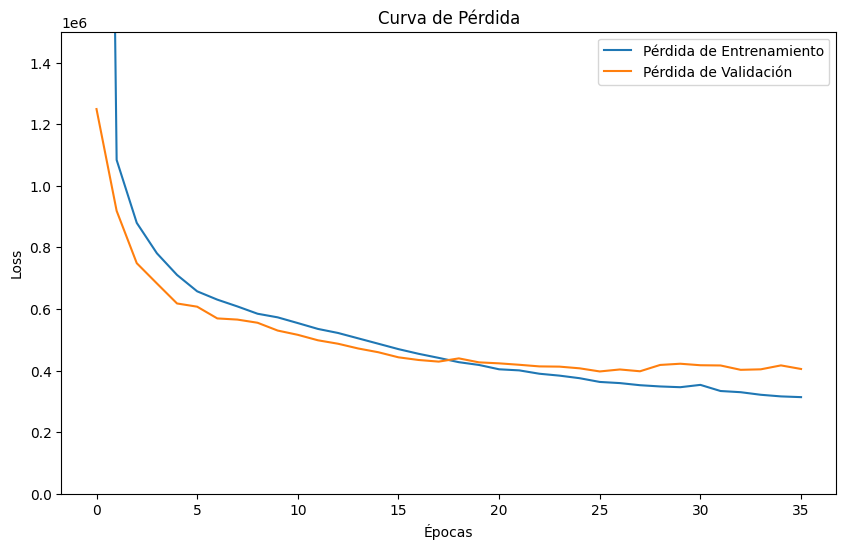

In [116]:
# Graficar la pérdida
plt.figure(figsize=(10, 6))
plt.plot(history2.history['loss'], label='Pérdida de Entrenamiento')
plt.plot(history2.history['val_loss'], label='Pérdida de Validación')
plt.title('Curva de Pérdida')
plt.xlabel('Épocas')
plt.ylabel('Loss')
plt.ylim(0, 1500000)
plt.legend()
plt.show()

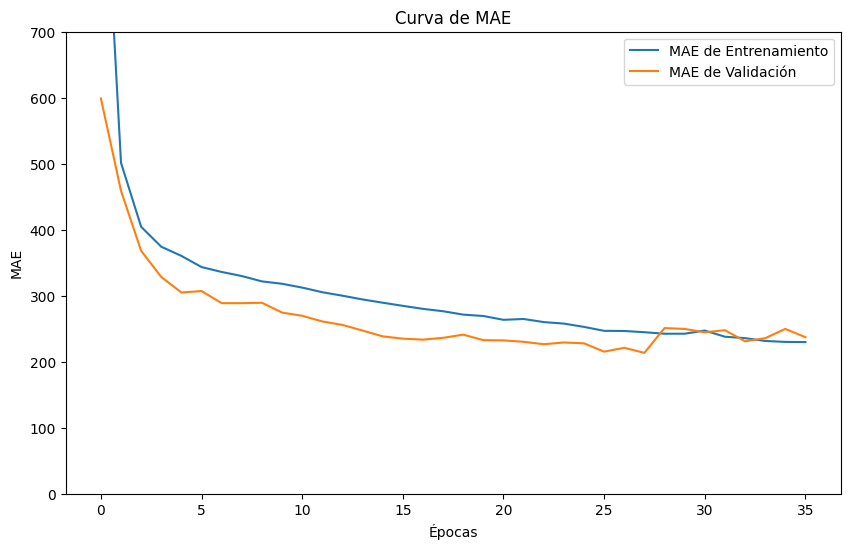

In [117]:
# Graficar el MAE
plt.figure(figsize=(10, 6))
plt.plot(history2.history['mae'], label='MAE de Entrenamiento')
plt.plot(history2.history['val_mae'], label='MAE de Validación')
plt.title('Curva de MAE')
plt.xlabel('Épocas')
plt.ylabel('MAE')
plt.ylim(0, 700)
plt.legend()
plt.show()

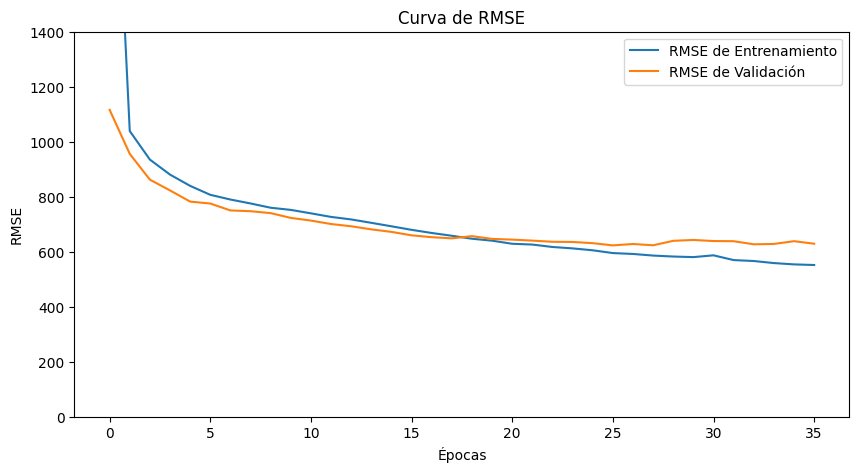

In [114]:
# Graficar el RMSE
plt.figure(figsize=(10, 5))
plt.plot(history2.history['rmse'], label='RMSE de Entrenamiento')
plt.plot(history2.history['val_rmse'], label='RMSE de Validación')
plt.title('Curva de RMSE')
plt.xlabel('Épocas')
plt.ylabel('RMSE')
plt.ylim(0, 1400)
plt.legend()
plt.show()

In [119]:
# Crear DataFrame con los resultados del conjunto de prueba
df_results_test8 = pd.DataFrame({'y_test_valores': y_test8, 'y_pred_valores': y_pred_test8})
print(df_results_test8)

       y_test_valores  y_pred_valores
0             1760.00     1892.712891
1             1899.00     1835.267700
2            19990.00    20557.351562
3             1163.55     1187.203979
4             1814.76     1730.200806
...               ...             ...
47181         1900.00     1666.001587
47182        21990.00    21158.533203
47183          996.00     1082.305054
47184          880.00      931.548889
47185         1081.49     1207.419312

[47186 rows x 2 columns]


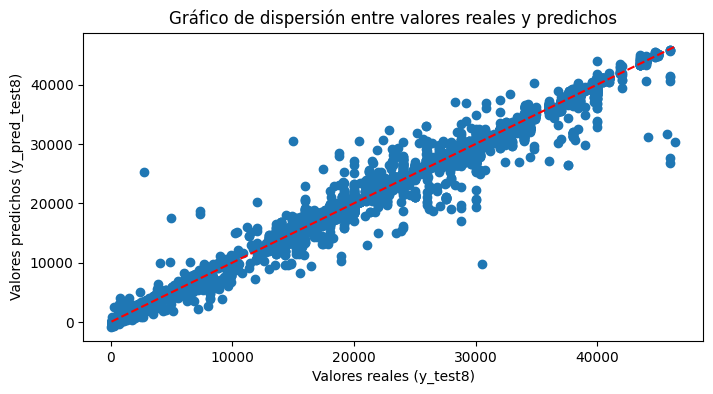

In [120]:
# Gráfico de dispersión entre valores reales y predichos
plt.figure(figsize=(8, 4))
plt.scatter(y_test8, y_pred_test8)
plt.xlabel("Valores reales (y_test8)")
plt.ylabel("Valores predichos (y_pred_test8)")
plt.title("Gráfico de dispersión entre valores reales y predichos")

# Agregar la recta identidad
plt.plot([min(y_test8), max(y_test8)], [min(y_test8), max(y_test8)], color='red', linestyle='--')
plt.show()

# Evaluación

## Regresión Lineal Simple

In [156]:
# Se saca las métricas de la regresión lineal construida con statsmodels tomando en cuenta las variables y_test_TP, y_pred_test_TP

# Calcular el error cuadrático medio (MSE)
mse = mean_squared_error(y_test1, y_pred_test1)
print(f'Mean Squared Error (MSE): {mse}')

# Calcular la raíz del error cuadrático medio (RMSE)
rmse = root_mean_squared_error(y_test1, y_pred_test1)
print(f'Root Mean Squared Error (RMSE): {rmse}')

# Calcular el error absoluto medio (MAE)
mae = mean_absolute_error(y_test1, y_pred_test1)
print(f'Mean Absolute Error (MAE): {mae}')

# Calcular el coeficiente de determinación (R cuadrado)
r2 = r2_score(y_test1, y_pred_test1)
print(f'R-squared (R2): {r2}')

# Calcular el MAPE para el Modelo 3
mape = mean_absolute_percentage_error(y_test1, y_pred_test1) * 100
print(f'Mean Absolute Percentage Error (MAPE): {mape}')

Mean Squared Error (MSE): 12655539.017117586
Root Mean Squared Error (RMSE): 3557.4624407177635
Mean Absolute Error (MAE): 1968.8815200225577
R-squared (R2): 0.8957335861859604
Mean Absolute Percentage Error (MAPE): 42.542906098439246


## Regresión Polinómica

In [179]:
# Se saca las métricas de la regresión lineal construida con statsmodels tomando en cuenta las variables y_test_TP, y_pred_test_TP

# Calcular el error cuadrático medio (MSE)
mse2 = mean_squared_error(y_test2, y_pred_test2)
print(f'Mean Squared Error (MSE): {mse2}')

# Calcular la raíz del error cuadrático medio (RMSE)
rmse2 = root_mean_squared_error(y_test2, y_pred_test2)
print(f'Root Mean Squared Error (RMSE): {rmse2}')

# Calcular el error absoluto medio (MAE)
mae2 = mean_absolute_error(y_test2, y_pred_test2)
print(f'Mean Absolute Error (MAE): {mae2}')

# Calcular el coeficiente de determinación (R cuadrado)
r2_2 = r2_score(y_test2, y_pred_test2)
print(f'R-squared (R2): {r2_2}')

# Calcular el MAPE para el Modelo 3
mape2 = mean_absolute_percentage_error(y_test2, y_pred_test2) * 100
print(f'Mean Absolute Percentage Error (MAPE): {mape2}')

Mean Squared Error (MSE): 9809605.296673212
Root Mean Squared Error (RMSE): 3132.0289425024816
Mean Absolute Error (MAE): 1716.8219398666413
R-squared (R2): 0.9191806556929822
Mean Absolute Percentage Error (MAPE): 29.691018190585012


## Regresión Lineal Múltiple

In [204]:
# Se saca las métricas de la regresión lineal construida con statsmodels tomando en cuenta las variables y_test_TP, y_pred_test_TP

# Calcular el error cuadrático medio (MSE)
mse3 = mean_squared_error(y_test3, y_pred_test3)
print(f'Mean Squared Error (MSE): {mse3}')

# Calcular la raíz del error cuadrático medio (RMSE)
rmse3 = root_mean_squared_error(y_test3, y_pred_test3)
print(f'Root Mean Squared Error (RMSE): {rmse3}')

# Calcular el error absoluto medio (MAE)
mae3 = mean_absolute_error(y_test3, y_pred_test3)
print(f'Mean Absolute Error (MAE): {mae3}')

# Calcular el coeficiente de determinación (R cuadrado)
r2_3 = r2_score(y_test3, y_pred_test3)
print(f'R-squared (R2): {r2_3}')

# Calcular el MAPE para el Modelo 3
mape3 = mean_absolute_percentage_error(y_test3, y_pred_test3) * 100
print(f'Mean Absolute Percentage Error (MAPE): {mape3}')

Mean Squared Error (MSE): 1175297.3968062256
Root Mean Squared Error (RMSE): 1084.1113396723722
Mean Absolute Error (MAE): 368.3331166821663
R-squared (R2): 0.9903169636185222
Mean Absolute Percentage Error (MAPE): 17.28350733910275


## Árbol de Decisión

In [1056]:
# Se saca las métricas de la regresión lineal construida con statsmodels tomando en cuenta las variables y_test_TP, y_pred_test_TP

# Calcular el error cuadrático medio (MSE)
mse5 = mean_squared_error(y_test5, y_pred_test5)
print(f'Mean Squared Error (MSE): {mse5}')

# Calcular la raíz del error cuadrático medio (RMSE)
rmse5 = root_mean_squared_error(y_test5, y_pred_test5)
print(f'Root Mean Squared Error (RMSE): {rmse5}')

# Calcular el error absoluto medio (MAE)
mae5 = mean_absolute_error(y_test5, y_pred_test5)
print(f'Mean Absolute Error (MAE): {mae5}')

# Calcular el coeficiente de determinación (R cuadrado)
r2_5 = r2_score(y_test5, y_pred_test5)
print(f'R-squared (R2): {r2_5}')

# Calcular el MAPE para el Modelo 3
mape5 = mean_absolute_percentage_error(y_test5, y_pred_test5) * 100
print(f'Mean Absolute Percentage Error (MAPE): {mape5}')

Mean Squared Error (MSE): 621031.6698429836
Root Mean Squared Error (RMSE): 788.0556261095936
Mean Absolute Error (MAE): 163.93722615530615
R-squared (R2): 0.9948644661510232
Mean Absolute Percentage Error (MAPE): 2.8545158829740047


## Random Forest

In [228]:
# Se saca las métricas de la regresión lineal construida con statsmodels tomando en cuenta las variables y_test_TP, y_pred_test_TP

# Calcular el error cuadrático medio (MSE)
mse6 = mean_squared_error(y_test6, y_pred_test6)
print(f'Mean Squared Error (MSE): {mse6}')

# Calcular la raíz del error cuadrático medio (RMSE)
rmse6 = root_mean_squared_error(y_test6, y_pred_test6)
print(f'Root Mean Squared Error (RMSE): {rmse6}')

# Calcular el error absoluto medio (MAE)
mae6 = mean_absolute_error(y_test6, y_pred_test6)
print(f'Mean Absolute Error (MAE): {mae6}')

# Calcular el coeficiente de determinación (R cuadrado)
r2_6 = r2_score(y_test6, y_pred_test6)
print(f'R-squared (R2): {r2_6}')

# Calcular el MAPE para el Modelo 3
mape6 = mean_absolute_percentage_error(y_test6, y_pred_test6) * 100
print(f'Mean Absolute Percentage Error (MAPE): {mape6}')

Mean Squared Error (MSE): 146681.9166295342
Root Mean Squared Error (RMSE): 382.99075266843477
Mean Absolute Error (MAE): 23.979372077903587
R-squared (R2): 0.9987915175009421
Mean Absolute Percentage Error (MAPE): 0.41213808484176123


## Red Perceptrón Multicapa (MLP)

In [87]:
# Se saca las métricas de la regresión lineal construida con statsmodels tomando en cuenta las variables y_test_TP, y_pred_test_TP

# Calcular el error cuadrático medio (MSE)
mse7 = mean_squared_error(y_test7, y_pred_test7)
print(f'Mean Squared Error (MSE): {mse7}')

# Calcular la raíz del error cuadrático medio (RMSE)
rmse7 = root_mean_squared_error(y_test7, y_pred_test7)
print(f'Root Mean Squared Error (RMSE): {rmse7}')

# Calcular el error absoluto medio (MAE)
mae7 = mean_absolute_error(y_test7, y_pred_test7)
print(f'Mean Absolute Error (MAE): {mae7}')

# Calcular el coeficiente de determinación (R cuadrado)
r2_7 = r2_score(y_test7, y_pred_test7)
print(f'R-squared (R2): {r2_7}')

# Calcular el MAPE para el Modelo 3
mape7 = mean_absolute_percentage_error(y_test7, y_pred_test7) * 100
print(f'Mean Absolute Percentage Error (MAPE): {mape7}')

Mean Squared Error (MSE): 281935.8786756702
Root Mean Squared Error (RMSE): 530.9763447420894
Mean Absolute Error (MAE): 162.951848700867
R-squared (R2): 0.9976685709948641
Mean Absolute Percentage Error (MAPE): 4.56122136760395


## Red Convolucional (CNN)

In [124]:
# Se saca las métricas de la regresión lineal construida con statsmodels tomando en cuenta las variables y_test_TP, y_pred_test_TP

# Calcular el error cuadrático medio (MSE)
mse8 = mean_squared_error(y_test8, y_pred_test8)
print(f'Mean Squared Error (MSE): {mse8}')

# Calcular la raíz del error cuadrático medio (RMSE)
rmse8 = root_mean_squared_error(y_test8, y_pred_test8)
print(f'Root Mean Squared Error (RMSE): {rmse8}')

# Calcular el error absoluto medio (MAE)
mae8 = mean_absolute_error(y_test8, y_pred_test8)
print(f'Mean Absolute Error (MAE): {mae8}')

# Calcular el coeficiente de determinación (R cuadrado)
r2_8 = r2_score(y_test8, y_pred_test8)
print(f'R-squared (R2): {r2_8}')

# Calcular el MAPE para el Modelo 3
mape8 = mean_absolute_percentage_error(y_test8, y_pred_test8) * 100
print(f'Mean Absolute Percentage Error (MAPE): {mape8}')

Mean Squared Error (MSE): 343167.38255579816
Root Mean Squared Error (RMSE): 585.804901443986
Mean Absolute Error (MAE): 210.34937731571853
R-squared (R2): 0.9971622257051309
Mean Absolute Percentage Error (MAPE): 4.8455872801830875


# Resumen de los modelos

In [1058]:
# Definir los nombres de los modelos y las métricas correspondientes
modelos = ['Regresión Lineal Simple', 'Regresión Polinómica', 'Regresión Lineal Múltiple',
            'Árbol de Decisión', 'Random Forest', 'Red Neuronal MLP', 'Red Neuronal CNN']
maes = [mae, mae2, mae3, mae5, mae6, mae7, mae8]
mses = [mse, mse2, mse3, mse5, mse6, mse7, mse8]
rmses = [rmse, rmse2, rmse3, rmse5, rmse6, rmse7, rmse8]
mapes = [mape, mape2, mape3, mape5, mape6, mape7, mape8]
r2s = [r2, r2_2, r2_3, r2_5, r2_6, r2_7, r2_8]

# Inicializar lista para los resultados
resultados = []

# Usar un bucle for para generar los diccionarios y agregarlos a la lista
for i in range(len(modelos)):
    resultado = {
        'Modelo': modelos[i],
        'MSE_test': mses[i],
        'RMSE_test': rmses[i],
        'MAE_test': maes[i],
        'MAPE_test': mapes[i],
        'R2:test': r2s[i]
    }
    resultados.append(resultado)

# Crear el DataFrame a partir de la lista de diccionarios
dataframeModels = pd.DataFrame(resultados)

In [74]:
dataframeModels

,Modelo,MSE_test,RMSE_test,MAE_test,MAPE_test,R2:test
0,Regresión Lineal Simple,1.280452e+07,3578.340758,1974.172871,42.810213,0.894115
1,Regresión Polinómica,9.919904e+06,3149.587847,1724.926495,30.107468,0.917969
2,Regresión Lineal Múltiple,1.277055e+06,1130.068478,367.092191,17.197030,0.989440
3,Árbol de Decisión,6.210317e+05,788.055626,163.937226,2.854516,0.994864
4,Random Forest,1.188294e+05,344.716405,24.361431,0.456603,0.999017
5,Red Neuronal MLP,2.819359e+05,530.976345,162.951849,4.561221,0.997669
6,Red Neuronal CNN,3.431674e+05,585.804901,210.349377,4.845587,0.997162


In [235]:
dataframeModels.to_csv('dataframeModels.csv', index=False)

In [48]:
df2.to_csv('df2.csv', index=False)

# Exportación del mejor modelo

In [231]:
from joblib import dump

# Supongamos que rf_tuned es tu modelo optimizado con RandomizedSearchCV
dump(modelo_6_fitted, "random_forest_model.joblib")

['random_forest_model.joblib']

In [232]:
import pickle

# Guardar el modelo con pickle
with open("random_forest_model.pkl", "wb") as file:
    pickle.dump(modelo_6_fitted, file)